## Goals of Script

1. Automate the process of writing notes in a natural language format of each tract in a BLM Oil and Gas Lease Sale

2.  Creaete visualizaitons tract by tract of permitting, new production, and leasing activity within a given radius

3.  Create a predictive model to estimate the purchase price based on historical activity, production, permits, and commodity prices

### Pending Tasks

* Add functionality to create concatenated dataframes for lease tracts with multiple polygons - This will create separate filters for each polygons individual centroid and compile the data as 1 dataframe for visualization and analysis

* Separate large file into sub notebooks for handling cleaning, filtering, note creation, modeling, etc

* fix bug in note generation where leases with high variabliity in bonus price skews the summary (remove outliars)


In [321]:
import pandas as pd
import geopandas as gp
import numpy as np
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt
from geopy.geocoders import Nominatim
import shapely
import math
import datetime as dt
import pdb

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import os
#had to add GDAL_DATA variable to system variables and set value to the folder of gdal in C:\Users\mishaun\AppData\Local\Continuum\anaconda3\Library\share\gdal on my work computer
'GDAL_DATA' in os.environ

False

# Reading in Data/Data Preparation for Automating Sale Notes

In [3]:
shapezipfile = ("zip://Data/BLMWY-2020-Q1-3_WGS84.zip")
tractshp = gp.read_file(shapezipfile, encoding = "utf-8")

In [4]:
#this is shapefile downloaded from drillinginfo holding well information
prodshp = gp.read_file("zip://Data/production.ZIP")
permitshp = gp.read_file("zip://Data/permits.ZIP")

#reading in csv of leases - converting to a GeoDataFrame - initial coord system is epsg:4326
leases = pd.read_csv("Data/LeasesTable.CSV")
leasesgeo = gp.GeoDataFrame(leases, crs = {'init': 'epsg:4326'}, geometry=gp.points_from_xy(leases["Longitude (WGS84)"], leases["Latitude (WGS84)"]))

oldprod = gp.read_file("zip://data/oldProduction.zip")

In [206]:
saleDate = pd.Timestamp(dt.date(2020, 3, 23))

### Trimming and Cleaning Data

In [6]:
leasesgeo.columns

Index(['State/Province', 'Effective Date', 'Record Date',
       'Expiration of Primary Term', 'Term (Months)', 'Grantor',
       'Grantee Alias', 'Royalty', 'Bonus', 'Area (Acres)', 'Section',
       'Township', 'Township Direction', 'Range', 'Range Direction',
       'Vol/Page', 'Record Number', 'Instrument Type', 'Instrument Date',
       'County/Parish', 'Options/Extensions', 'DI Basin', 'Ext. Bonus',
       'Ext. Term (Months)', 'Abstract', 'Block', 'BLM', 'State Lease',
       'Grantee', 'Grantor Address', 'Grantee Address', 'Max Depth',
       'Majority Legal Assignee', 'DI Subplay', 'Min Depth',
       'Majority Assignment Effective Date', 'Latitude (WGS84)', 'DI Play',
       'Majority Legal Assignee Interest', 'Longitude (WGS84)',
       'Majority Assignment Vol/Page', 'geometry'],
      dtype='object')

In [7]:
leasesgeo.drop(columns = ['Instrument Type', 'Instrument Date','Options/Extensions', 'DI Basin', 'Ext. Bonus',
       'Ext. Term (Months)', 'Abstract', 'Block', 'BLM', 'State Lease',
       'Grantee', 'Grantor Address', 'Grantee Address', 'Max Depth',
       'Majority Legal Assignee', 'DI Subplay', 'Min Depth',
       'Majority Assignment Effective Date','Majority Legal Assignee Interest','Majority Assignment Vol/Page'], inplace = True)

In [8]:
prodshp.columns

Index(['APIUWI', 'OpAlias', 'LeaseName', 'WellNo', 'County', 'Reservoir',
       'ProdType', 'ProdStatus', 'DrillType', 'TD', 'SpudDate', 'FstPrdDate',
       'LstPrdDate', 'MoProd', 'CumGas', 'DailyGas', 'CumLiq', 'DailyLiq',
       'LatestLiq', 'LatestGas', 'CumWtr', 'CumBOE', 'DISubplay', '1moLiq',
       '1moGas', '6moLiq', 'DIBasin', '6moGas', '6moBOE', '6moWater', 'DIPlay',
       'PracIP_Liq', 'PracIP_BOE', 'PracIP_Gas', 'PrcIPCFGED', 'LatestWtr',
       'Prior12Liq', 'Prior12Gas', 'LastTestDt', 'Prior12Wtr', 'LastFlwPrs',
       'LastWHSIP', '2moGOR', 'LatestGOR', 'CumGOR', 'Lst12Yield', '2moYield',
       'LatestYld', 'PeakGas', 'PkGasMoNo', 'PeakLiq', 'PkLiqMoNo', 'PeakBOE',
       'PkBOEMoNo', 'PkMMCFGE', 'PkMMCFGMoN', 'TopPerf', 'BtmPerf', 'GasGrav',
       'OilGrav', 'CompDate', 'WellCount', 'MaxActvWel', 'GasGather',
       'LiqGather', 'LeaseNo', 'PerfLength', 'TVD', 'Field', 'State',
       'District', 'GeoProvin', 'Section', 'Country', 'Township', 'Range',
       'Lati

In [9]:
prodshp.drop(columns = ['LatestWtr','CumWtr',
       'Prior12Liq', 'Prior12Gas', 'LastTestDt', 'Prior12Wtr', 'LastFlwPrs',
       'LastWHSIP', '2moGOR', 'LatestGOR', 'CumGOR', 'Lst12Yield', '2moYield',
       'LatestYld', 'PeakGas', 'PkGasMoNo', 'PeakLiq', 'PkLiqMoNo', 'PeakBOE',
       'PkBOEMoNo', 'PkMMCFGE', 'PkMMCFGMoN', 'TopPerf', 'BtmPerf', 'GasGrav',
       'OilGrav','CompDate', 'GasGather',
       'LiqGather', 'LeaseNo'], inplace = True)

In [10]:
permitshp.columns

Index(['API10UWI', 'District', 'FiledDate', 'AprvdDate', 'ExpDate', 'State',
       'County', 'OpAlias', 'LeaseName', 'WellNo', 'Formation', 'PermDepth',
       'TVD', 'PermitType', 'WellType', 'DrillType', 'WellStatus',
       'PermStatus', 'Field', 'OpReported', 'AmendDate', 'CntctName',
       'CntctPhone', 'OperAddrs', 'OperCity', 'OperState', 'OperZip',
       'OperCity30', 'Section', 'OperCity50', 'Township', 'Range', 'Block',
       'Survey', 'TVD_UOM', 'Abstract', 'WGID', 'H2S_Area', 'Latitude',
       'Longitude', 'OFS_Reg', 'Btm_Lat', 'Btm_Lon', 'LeaseNo', 'PermDUOM',
       'PermitNo', 'DIBasin', 'DIPlay', 'DISubplay', 'OpCompany', 'OpTicker',
       'geometry'],
      dtype='object')

In [11]:
permitshp.drop(columns = ['OpReported', 'AmendDate', 'CntctName',
       'CntctPhone', 'OperAddrs', 'OperCity', 'OperState', 'OperZip',
       'OperCity30', 'Section', 'OperCity50', 'Township', 'Range', 'Block',
       'Survey', 'TVD_UOM', 'Abstract', 'WGID', 'H2S_Area','OFS_Reg', 'LeaseNo', 'PermDUOM',
       'PermitNo','OpCompany', 'OpTicker'], inplace=True)

In [12]:
oldprod.info()
oldprod.columns

dropcols = ['CumWtr', 'DISubplay', '1moLiq',
       '1moGas', '6moLiq', 'DIBasin', '6moGas', '6moBOE', '6moWater', 'DIPlay',
       'PracIP_Liq', 'PracIP_BOE', 'PracIP_Gas', 'PrcIPCFGED', 'LatestWtr',
       'Prior12Liq', 'Prior12Gas', 'LastTestDt', 'Prior12Wtr', 'LastFlwPrs',
       'LastWHSIP', '2moGOR', 'LatestGOR', 'CumGOR', 'Lst12Yield', '2moYield',
       'LatestYld', 'PeakGas', 'PkGasMoNo', 'PeakLiq', 'PkLiqMoNo', 'PeakBOE',
       'PkBOEMoNo', 'PkMMCFGE', 'PkMMCFGMoN', 'TopPerf', 'BtmPerf', 'GasGrav',
       'OilGrav', 'CompDate', 'WellCount', 'MaxActvWel', 'GasGather',
       'LiqGather', 'LeaseNo', 'PerfLength', 'TVD', 'Field', 'State',
       'District', 'GeoProvin','Country','OCS_Area', 'PGC_Area',
       'OpReported', 'Survey', 'EntityId', 'Last12Liq', 'Last12Gas',
       'Last12Wtr', 'OtherNo']

oldprod.drop(columns=dropcols, inplace = True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 13817 entries, 0 to 13816
Data columns (total 90 columns):
APIUWI        13817 non-null object
OpAlias       13801 non-null object
LeaseName     13813 non-null object
WellNo        13522 non-null object
County        13817 non-null object
Reservoir     8119 non-null object
ProdType      13808 non-null object
ProdStatus    13817 non-null object
DrillType     13817 non-null object
TD            13782 non-null float64
SpudDate      10088 non-null object
FstPrdDate    6905 non-null object
LstPrdDate    6905 non-null object
MoProd        6905 non-null float64
CumGas        6758 non-null float64
DailyGas      3828 non-null float64
CumLiq        6406 non-null float64
DailyLiq      3464 non-null float64
LatestLiq     4372 non-null float64
LatestGas     6255 non-null float64
CumWtr        6501 non-null float64
CumBOE        6905 non-null float64
DISubplay     0 non-null object
1moLiq        5904 non-null float64
1moGas        6489 non-nu

Index(['APIUWI', 'OpAlias', 'LeaseName', 'WellNo', 'County', 'Reservoir',
       'ProdType', 'ProdStatus', 'DrillType', 'TD', 'SpudDate', 'FstPrdDate',
       'LstPrdDate', 'MoProd', 'CumGas', 'DailyGas', 'CumLiq', 'DailyLiq',
       'LatestLiq', 'LatestGas', 'CumWtr', 'CumBOE', 'DISubplay', '1moLiq',
       '1moGas', '6moLiq', 'DIBasin', '6moGas', '6moBOE', '6moWater', 'DIPlay',
       'PracIP_Liq', 'PracIP_BOE', 'PracIP_Gas', 'PrcIPCFGED', 'LatestWtr',
       'Prior12Liq', 'Prior12Gas', 'LastTestDt', 'Prior12Wtr', 'LastFlwPrs',
       'LastWHSIP', '2moGOR', 'LatestGOR', 'CumGOR', 'Lst12Yield', '2moYield',
       'LatestYld', 'PeakGas', 'PkGasMoNo', 'PeakLiq', 'PkLiqMoNo', 'PeakBOE',
       'PkBOEMoNo', 'PkMMCFGE', 'PkMMCFGMoN', 'TopPerf', 'BtmPerf', 'GasGrav',
       'OilGrav', 'CompDate', 'WellCount', 'MaxActvWel', 'GasGather',
       'LiqGather', 'LeaseNo', 'PerfLength', 'TVD', 'Field', 'State',
       'District', 'GeoProvin', 'Section', 'Country', 'Township', 'Range',
       'Lati

In [13]:
leasesgeo.info()
prodshp.info()
permitshp.info()
oldprod.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 53266 entries, 0 to 53265
Data columns (total 22 columns):
State/Province                53266 non-null object
Effective Date                31049 non-null object
Record Date                   53266 non-null object
Expiration of Primary Term    53266 non-null object
Term (Months)                 53266 non-null int64
Grantor                       53266 non-null object
Grantee Alias                 53239 non-null object
Royalty                       33903 non-null float64
Bonus                         18347 non-null float64
Area (Acres)                  52506 non-null float64
Section                       53266 non-null float64
Township                      53266 non-null float64
Township Direction            53266 non-null object
Range                         53266 non-null float64
Range Direction               53266 non-null object
Vol/Page                      53266 non-null object
Record Number                 53266 non-null o

### Converting geodataframes to same coord system - UTM system for creating buffers

In [778]:
def convertCRS(*args, crs_system = 26913):
    for i in args:
        print(i.crs)
        i.to_crs(epsg = crs_system, inplace = True)
        print("Converted to:")
        print(i.crs)
        print("\n")

In [15]:
def convertoDateTime(*dataframe):
    '''
    This function will take in arguments of a dataframe.
    It will then search each column name to see if there is a date in the name using the filter method
    The filtered list will then use the apply method to convert data in column to date time
    '''
    for df in dataframe:
        cols = list(filter(lambda x: 'date' in x.lower(), df.columns))

        for col in cols:
            df[col] = df[col].apply(lambda x: pd.to_datetime(x))

In [779]:
convertCRS(prodshp, permitshp, leasesgeo, tractshp, oldprod)

prodshp.crs
permitshp.crs
leasesgeo.crs
oldprod.crs

NameError: name 'prodshp' is not defined

In [18]:
convertoDateTime(prodshp, permitshp, leasesgeo, oldprod)

### Adding a column to tract shapefile data for centroids of each tract for creating buffers upon

In [19]:
tractshp["centroids"] = tractshp.centroid
#calculating acres of tract, conv to acres is m^2 to acres
tractshp['Acres'] = round(tractshp.area * 0.000247105)
tractshp.head()

,SaleParcel,lot_no,tract_id,short_code,label,geometry,centroids,Acres
0,WY-201Q-105,65012,2,BLMWY-2020-Q1-3,WY-2020-03-0374,"MULTIPOLYGON (((173527.819 4984155.461, 173534...",POINT (172183.913 4984182.822),941.0
1,WY-201Q-063,64970,16,BLMWY-2020-Q1-3,WY-2020-03-6207,"MULTIPOLYGON (((219007.722 4650891.363, 218687...",POINT (222418.619 4647579.181),1322.0
2,WY-201Q-001,64908,93,BLMWY-2020-Q1-3,WY-2020-03-6613,"POLYGON ((562927.151 4797521.250, 563330.976 4...",POINT (563130.227 4797125.862),80.0
3,WY-201Q-002,64909,102,BLMWY-2020-Q1-3,WY-2020-03-6660,"POLYGON ((514894.040 4607634.757, 515295.946 4...",POINT (515096.374 4607429.194),40.0
4,WY-201Q-003,64910,89,BLMWY-2020-Q1-3,WY-2020-03-6585,"MULTIPOLYGON (((518971.985 4775132.462, 519376...",POINT (520545.083 4773447.285),2316.0


In [20]:
#adding buffer around centroid point from tract of 3 mi (1609.34 meters = 1 mile)
miradius = 3
milesbuffer = miradius * 1609.34

tractshp["buffers"] = tractshp.centroids.apply(lambda x: x.buffer(milesbuffer,20))


# Testing Spatial Filters

In [21]:
TestT = 40
tractTest = tractshp[tractshp["tract_id"] == TestT].iloc[0]


permFiltered = permitshp.loc[permitshp.within(tractshp[tractshp["tract_id"] ==TestT]["buffers"].iloc[0])]
prodFiltered = prodshp.loc[prodshp.within(tractshp[tractshp["tract_id"] ==TestT]["buffers"].iloc[0])]
leasesFiltered = leasesgeo.loc[leasesgeo.within(tractshp[tractshp["tract_id"]==TestT]["buffers"].iloc[0])]

In [22]:
len(permFiltered), len(prodFiltered), len(leasesFiltered)

(12, 6, 2)

### Calculating distance between leases within 3 mi radius and tract's centroid - Store in Function

In [23]:
#function to get compass direction

def cardDir(point, tractRef):
    '''
    This function will take in 2 inputs and will calculate the cardinal direction between 2 points
    
    1.  point: a shapely Point object referring to a permit,lease, well found in spatial query  
    2.  tractRef: a shapely Point object referring to the centroid of the lease/tract for analysis
    '''
    
    #storing each coordinate in a temporary variable
    a = point.x
    b = point.y
    c = tractRef["centroids"].x
    d = tractRef["centroids"].y

    #south and west are positive direction for my axis convention
    western = c - a
    southern = d - b
    
    #calculating angle between points for determining which direction the point of data is in reference to tract centroid
    compdeg = abs(math.atan(western/southern))
    #converts radians to degrees
    compdeg *= 57.2958
    compdeg

    if southern > 0:
        if compdeg < 10:
            carddir = "S"
        elif compdeg > 80:
            if western>0:
                carddir = "W"
            else:
                carddir = "E"
        else:
            if western>0:
                carddir = "SW"
            else:
                carddir = "SE"
    else:
        if compdeg < 10:
            carddir = "N"
        elif compdeg > 80:
            if western>0:
                carddir = "W"
            else:
                carddir = "E"
        else:
            if western>0:
                carddir = "NW"
            else:
                carddir = "NE"  
     
    return carddir         
   
    

### Creating Function from Test Above and Below Code to Get Filtered Data Tract by Tract In a Loop

In [24]:
def prepareTractFilter(x):
    '''This function will use global variables defined previously for testing each tract
       x will be the tract number we will look for activity around
       
       The functino will run and add columns of data only necessary for the filtered values data
    '''
    
    #getting tract in sale list to search well data (permits, leases, prod)
    tractTest = tractshp[tractshp["tract_id"] == x].iloc[0]

    #global variables permitshp, prodshp, leasesgeo - not passing them into the function
    #this will use geopandas function within to get data within buffer of test tract and then use the boolean array to filter itself to get data
    permitstoeval = permitshp.loc[permitshp.within(tractTest["buffers"])]
    prodtoeval = prodshp.loc[prodshp.within(tractTest["buffers"])]
    leasestoeval = leasesgeo.loc[leasesgeo.within(tractTest["buffers"])]
    oldprodtoeval = oldprod.loc[oldprod.within(tractTest["buffers"])]
    
    #calculating distance (in miles) away lease within 3 mi radius is to tract of interest and direction of data point (permit, lease, prod)
    leasestoeval["distance"] = leasestoeval["geometry"].apply(lambda x: x.distance(tractTest["centroids"])/1609.34)
    leasestoeval["direction"] = leasestoeval["geometry"].apply(lambda x: cardDir(x, tractTest))
    leasestoeval["RecordYr"] = leasestoeval["Record Date"].apply(lambda x: x.year)
    
    
    #adding columns to permits dataframe such as horizontal lngth and direction
    permitstoeval["horzLength"] = permitstoeval["PermDepth"] - permitstoeval["TVD"]
    permitstoeval["distance"] = permitstoeval["geometry"].apply(lambda x: x.distance(tractTest["centroids"])/1609.34)
    permitstoeval["direction"] = permitstoeval["geometry"].apply(lambda x: cardDir(x, tractTest))


    prodtoeval["distance"] = prodtoeval["geometry"].apply(lambda x: x.distance(tractTest["centroids"])/1609.34)
    prodtoeval["direction"] = prodtoeval["geometry"].apply(lambda x: cardDir(x, tractTest))
    
    oldprodtoeval["distance"] = oldprodtoeval["geometry"].apply(lambda x: x.distance(tractTest["centroids"])/1609.34)
    oldprodtoeval["direction"] = oldprodtoeval["geometry"].apply(lambda x: cardDir(x, tractTest))
    

    return permitstoeval, prodtoeval, leasestoeval, oldprodtoeval

### Looping Through All Sale Tracts - Retrieving Data Around Tract

In [ ]:
#output filtered data for hard storing to excel file
outputProd = []
outputPerm = []
outputLeases = []
outputOldProd = []


#looping through each tract id and creating filtered geospatial data, activity summaries, and visualizaiton plots
for i in tractshp["tract_id"]:
    perm, prod, leases, oldprodtoeval = prepareTractFilter(i)
    
    #appending geospatial filtered datasets to a list in order to write dataframes to file for easier retrieval and data validaiton
    perm["tract_id"] = i
    outputPerm.append(perm)
    
    prod["tract_id"] = i
    outputProd.append(prod)
    
    leases["tract_id"] = i
    outputLeases.append(leases)
    
    oldprodtoeval["tract_id"] = i
    outputOldProd.append(oldprodtoeval)

### Writing Filtered Data to File for Easier Retrieval

In [25]:
    
#concatenating filtered dataframes along the row axis and writing to file
pd.concat(outputLeases).to_excel("Output Data/Sale Tracts Activity Data/Leases Around Sale Tracts.xlsx")
pd.concat(outputPerm).to_excel("Output Data/Sale Tracts Activity Data/Permits Around Sale Tracts.xlsx")
pd.concat(outputProd).to_excel("Output Data/Sale Tracts Activity Data/Prod Around Sale Tracts.xlsx")
pd.concat(outputOldProd).to_excel("Output Data/Sale Tracts Activity Data/OldProd Around Sale Tracts.xlsx")

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/panda

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-vers

# Section for creating summary functions and testing logic

In [26]:
# # 5-10-20 VOID LINE OF CODE - new method of getting test tract by looking at dataframes read from file
# tPerm, tProd, tLea, tOld = prepareTractFilter(37)

In [780]:
#reading dataframes from excel file
fullFilteredLeases = pd.read_excel("Output Data/Sale Tracts Activity Data/Leases Around Sale Tracts.xlsx")
fullFilteredPermits = pd.read_excel("Output Data/Sale Tracts Activity Data/Permits Around Sale Tracts.xlsx")
fullFilteredProd = pd.read_excel("Output Data/Sale Tracts Activity Data/Prod Around Sale Tracts.xlsx")
fullFilteredOldProd = pd.read_excel("Output Data/Sale Tracts Activity Data/OldProd Around Sale Tracts.xlsx")

In [781]:
#old production must be converted back into geodata frame because the write old prod summary... ->
#uses geospatial filtering to find wells within tract boundaries of tract
# *** Init CRS should be initial CRS of shapefile from import because we are creating the geometries based on the lat and longs
# *** Trying to import as a geodataframe using directly the geometry column was troublesome - geopandas did not recongize the column data type as point
fullFilteredOldProd= gp.GeoDataFrame(fullFilteredOldProd,  crs = {'init': 'epsg:4326'}, geometry=gp.points_from_xy(fullFilteredOldProd["Longitude"], fullFilteredOldProd["Latitude"]))

#converting oldprod geodataframe crs
convertCRS(fullFilteredOldProd)


{'init': 'epsg:4326'}
Converted to:
{'init': 'epsg:26913', 'no_defs': True}




In [29]:
#writing fuction to get data from pandas dataframe that was accessed from file
def getActivityData(tractNum):
    
    '''
    This function will filter fullFiltered global variable dataframes to tract specific data
    '''
    
    tractLeases = fullFilteredLeases.loc[fullFilteredLeases["tract_id"] == tractNum]
    tractPermits = fullFilteredPermits.loc[fullFilteredPermits["tract_id"] == tractNum]
    tractProd = fullFilteredProd.loc[fullFilteredProd["tract_id"] == tractNum]
    tractOldProd = fullFilteredOldProd.loc[fullFilteredOldProd["tract_id"] == tractNum]
    
    return tractPermits, tractProd, tractLeases, tractOldProd

In [30]:
#test tract and retrieve data around tract
tPerm, tProd, tLea, tOld = getActivityData(40)

### Function to write permits around tract summary

In [31]:
#testing out data 

tPerm.groupby("OpAlias").count().head(3)["API10UWI"]

OpAlias
DEVON    12
Name: API10UWI, dtype: int64

In [32]:
def writePermitSummary(geoDF):
    
    #getting overall count of permits within in the spatial filter
    count = int(geoDF["API10UWI"].count())
    
    if count == 0 or type(geoDF) == type(None):
        summaryText = "There are no permits within a 3 mile radius"
        return summaryText
    
    #stating how many permits were found based on mile radius
    a = "In a {} mile radius there are {} active permits".format(miradius, count)
    
    #getting summary of stats for numerical columns grouped by well orientation
    byWellType = geoDF.groupby("DrillType").describe()
    
    
    #creating a list comprehension to count 
    b = [("{:.0f} permits are {} wells ".format(byWellType["PermDepth"]["count"].loc[i], i)) for i in byWellType.index]
    
    #if there were multiple types of permits, join the list with ";", otherwise take 1st index and ocnvert to string
    if len(byWellType)>1:
        b = "; ".join(b)
    else: 
        b = b[0]
    
    #only talking about lateral length for horz wells
    if 'H' in b:
        #rounding off to the nearest thousand (-3 in the second argument of the function round
        avgHlength = round(byWellType["horzLength"]["mean"].loc["H"],-3)
        avgTVD = round(byWellType["TVD"]["mean"]["H"], -2)
        
        b += "\nThe average lateral length among these permits is {:.0f} ft.".format(avgHlength)
        b += " \n- The TVD for these well(s) are ~{:.0f}ft".format(avgTVD)
    else:
        #consider adding a standard deviation conditional analysis whether to show avg depth for V permits or min max mean type summary
        b += "The average TVD for the vertical permits are {:.0f}".format(round(byWellType["TVD"].loc["V"]["mean"], -2))
    
    #getting top 3 operators with permits
    topOperators = geoDF.groupby("OpAlias").count().head(3)
    
    #list comprehension to build list with strings having operator and their permit count in 3 mi radius
    c = ["{} has {} permits".format(i.title(), topOperators["API10UWI"].loc[i]) for i in topOperators.index]
    c = ", ".join(c)
    
    summaryText = "\n".join([a,b,c])
    
    return summaryText
    

In [33]:
print(writePermitSummary(tPerm))

In a 3 mile radius there are 12 active permits
8 permits are H wells ; 4 permits are V wells 
The average lateral length among these permits is 9000 ft. 
- The TVD for these well(s) are ~10500ft
Devon has 12 permits


### Function to write leaes around tract summary

In [34]:
tLea

,Unnamed: 0,State/Province,Effective Date,Record Date,Expiration of Primary Term,Term (Months),Grantor,Grantee Alias,Royalty,Bonus,...,Record Number,County/Parish,Latitude (WGS84),DI Play,Longitude (WGS84),geometry,distance,direction,RecordYr,tract_id
601,4777,WY,NaT,2019-09-13,2020-08-23,12,PELLATZ ROBERT D ET AL,DEVON ENERGY,NaN,NaN,...,1087208,CONVERSE (WY),43.167017,POWDER RIVER,-105.389570,POINT (468332.8896460042 4779435.621910308),2.920035,SW,2019,40
602,49813,WY,NaT,2014-08-05,2024-08-05,120,BLM,MBI O&G,0.125,3100.0,...,WYW183606,CONVERSE (WY),43.239942,POWDER RIVER,-105.388968,POINT (468419.5196675659 4787533.966931479),2.483696,NW,2014,40


In [35]:
unique = tLea.drop_duplicates(subset=["Record Number", "Area (Acres)", "Bonus"])
unique

,Unnamed: 0,State/Province,Effective Date,Record Date,Expiration of Primary Term,Term (Months),Grantor,Grantee Alias,Royalty,Bonus,...,Record Number,County/Parish,Latitude (WGS84),DI Play,Longitude (WGS84),geometry,distance,direction,RecordYr,tract_id
601,4777,WY,NaT,2019-09-13,2020-08-23,12,PELLATZ ROBERT D ET AL,DEVON ENERGY,NaN,NaN,...,1087208,CONVERSE (WY),43.167017,POWDER RIVER,-105.389570,POINT (468332.8896460042 4779435.621910308),2.920035,SW,2019,40
602,49813,WY,NaT,2014-08-05,2024-08-05,120,BLM,MBI O&G,0.125,3100.0,...,WYW183606,CONVERSE (WY),43.239942,POWDER RIVER,-105.388968,POINT (468419.5196675659 4787533.966931479),2.483696,NW,2014,40


In [36]:
#weighted average
sum(unique["Bonus"] * unique["Area (Acres)"]) / sum(unique["Area (Acres)"])

nan

In [37]:
def writeLeaseSummary(geoDF):
    
    #getting overall count of leases within in the spatial filter
    count = geoDF["Grantee Alias"].count()
    
    if count == 0:
        return "There are no recorded leases within a 3 mile radius"
    
    #getting leases only with bonuses and dropping duplicates where lease is repeated within same section
    leaseBonuses = geoDF[geoDF["Bonus"]>0]
    leaseBonuses = leaseBonuses.drop_duplicates(subset = ['geometry', "Record Number"])
    #rounding distances to nearest tength
    leaseBonuses["distance"] = leaseBonuses["distance"].apply(lambda x: round(x,1))
    
    #stating how many leases were found based on mile radius and most recent 
    latestYr = leaseBonuses["RecordYr"].max()
    a = "In a {} mile radius, the latest leases with bonus information were taken in {}.".format(miradius, latestYr)
    
    #getting summary of leases taken in most recent year, grouped by grantee
    byGrantee = leaseBonuses[leaseBonuses["RecordYr"]==latestYr]
    byGrantee = byGrantee.groupby("Grantee Alias").describe()
    
    #gtting 2 most active lessees
    mostGrantees = byGrantee["Bonus"].sort_values("count", ascending = False).head(2)
    
    b = ""
    #looping thorugh the 2 lessee's to get their average price paid
    for i in mostGrantees.index:
        #if the std deviation is 0 or is not available, then there is an exact price paid
        if mostGrantees["std"].loc[i] == 0 or np.isnan(mostGrantees["std"].loc[i]):
            b += "{} paid ${:.0f}/acre.  ".format(i.title(), mostGrantees["mean"].loc[i])
        #if there is a standard deviation, then we will give the range and average
        else:
            b += "{} paid between ${:.0f}/acre and ${:.0f}/acre.  ".format(i.title(), mostGrantees["min"].loc[i], mostGrantees["max"].loc[i])
    
    #if there was 2 or more lessee's for the given latest year, then report average bonus price for the data
    if leaseBonuses[leaseBonuses["RecordYr"]==latestYr]["Bonus"].count() > 2:
        
        #calculating weighted average by dropping duplicate leases by record number, bonus, and acreage
        unique = leaseBonuses[leaseBonuses["RecordYr"]==latestYr].drop_duplicates(subset=["Record Number", "Area (Acres)", "Bonus"])
        weightedAvg = sum(unique["Bonus"] * unique["Area (Acres)"]) / sum(unique["Area (Acres)"])
        
        b+= "The weighted average price in {} overall within the {} radius was ${:.0f}/acre.  ".format(latestYr,miradius,weightedAvg)
        
        #checking to see if highest price paid differes from the mean, if so, comment about the highest price
        if leaseBonuses[leaseBonuses["RecordYr"]==latestYr]["Bonus"].mean() != leaseBonuses[leaseBonuses["RecordYr"]==latestYr]["Bonus"].max():
            b += "The highest price paid in {:.0f} was ${:.0f}/acre".format(latestYr, leaseBonuses[leaseBonuses["RecordYr"]==latestYr]["Bonus"].max())
    
    #generating list for previous years of latest lease taken by 4 years back
    previousYears = list(range(latestYr-1, latestYr-4, -1))
    
    c = ""
    for yr in previousYears:
        #saving dataframe filtered to year of interest
        curYr = leaseBonuses[leaseBonuses["Record Date"].apply(lambda x: x.year) == yr]
        
        #checking to see if the dataframe has values with bonuses
        if len(curYr)>0:
            
            c += "In {}, ".format(yr)
            
            #grouping the filtered dataframe by year by grantee
            grouped = curYr.groupby("Grantee Alias").describe()["Bonus"]
            
            #limiting summary to top 2 most active grantees
            grouped = grouped.sort_values("count", ascending = False).head(2)
            
            #looping through top 2 grantees to get their bonus range paid
            for grantee in grouped.index:
                
                #if the grantee has a std of 0, then there is no variance and the average can be mentioned
                if grouped.loc[grantee]["std"] == 0 or np.isnan(grouped.loc[grantee]["std"]):
                    c += "{} paid ${:.0f}/acre. \n".format(grantee.title(), grouped.loc[grantee]["mean"])
                #if there is a std, then give the range the grantee paid
                else:
                    c += "{} paid between ${:.0f}/acre and ${:.0f}/acre. \n".format(grantee.title(), grouped.loc[grantee]["min"],grouped.loc[grantee]["max"]) 
    
    summaryText = "\n".join([a,b,c])
    
    return summaryText
    

In [38]:
writeLeaseSummary(tLea)

'In a 3 mile radius, the latest leases with bonus information were taken in 2014.\nMbi O&G paid $3100/acre.  \n'

### Last 4 years of production summary function

In [39]:
pd.set_option('max_columns', 30)
tProd
tProd.columns

,Unnamed: 0,APIUWI,OpAlias,LeaseName,WellNo,County,Reservoir,ProdType,ProdStatus,DrillType,TD,SpudDate,FstPrdDate,LstPrdDate,MoProd,...,Longitude,Block,OCS_Area,PGC_Area,OpReported,Survey,EntityId,Last12Liq,Last12Gas,Last12Wtr,OtherNo,geometry,distance,direction,tract_id
1,25520,49009299790000,DEVON ENERGY CORPORATION,SDU TILLARD FED,09-043771-1XPH,CONVERSE (WY),PARKMAN,OIL,ACTIVE,H,8099,2017-07-20,2017-11-01,2019-12-01,26,...,-105.39576,NaN,NaN,P-510,DEVON ENERGY PRODUCTION COMPANY LP,NaN,130026365,62480.0,40696.0,28296.0,0,POINT (467840.4344769005 4781699.382371337),1.873264,SW,40
2,33316,49009299800000,DEVON ENERGY CORPORATION,SDU TILLARD FED,09-043771-2XTH,CONVERSE (WY),TURNER,OIL,ACTIVE,H,11145,2018-04-17,2018-08-01,2019-12-01,16,...,-105.39579,NaN,NaN,P-510,DEVON ENERGY PRODUCTION COMPANY LP,NaN,130499841,86491.0,102822.0,96688.0,0,POINT (467838.1541732166 4781732.709533586),1.859587,SW,40
3,41081,49009438690000,DEVON ENERGY CORPORATION,SDU TILLARD FED,083771-2PH,CONVERSE (WY),PARKMAN,OIL,ACTIVE,H,8165,2019-04-16,2019-06-01,2019-12-01,7,...,-105.41355,NaN,NaN,P-510,DEVON ENERGY PRODUCTION COMPANY LP,NaN,130543913,82198.0,47456.0,65097.0,0,POINT (466395.2679523683 4781798.5432147),2.553126,SW,40
4,46119,49009438680000,DEVON ENERGY CORPORATION,SDU TILLARD FED,083771-1PH,CONVERSE (WY),PARKMAN,OIL,ACTIVE,H,8247,2019-04-06,2019-06-01,2019-12-01,7,...,-105.41355,NaN,NaN,P-510,DEVON ENERGY PRODUCTION COMPANY LP,NaN,130543912,145455.0,86001.0,82349.0,0,POINT (466395.1911498285 4781782.995913362),2.557992,SW,40
5,51363,49009352170000,DEVON ENERGY CORPORATION,SDU TILLARD,17-203771-1XNH,CONVERSE (WY),NIOBRARA,OIL,ACTIVE,H,11012,2017-12-13,2018-03-01,2019-12-01,22,...,-105.41357,NaN,NaN,P-510,DEVON ENERGY PRODUCTION COMPANY LP,NaN,130421302,85795.0,105281.0,16265.0,0,POINT (466393.4178349872 4781753.019861775),2.568322,SW,40
6,57153,49009428100000,DEVON ENERGY CORPORATION,SDU TILLARD,18-193771-5XNH,CONVERSE (WY),NIOBRARA,OIL,ACTIVE,H,11191,2019-04-21,2019-08-01,2019-12-01,5,...,-105.42239,NaN,NaN,P-510,DEVON ENERGY PRODUCTION COMPANY LP,NaN,130649803,67732.0,91761.0,50666.0,0,POINT (465676.3476749239 4781685.524895333),2.979859,SW,40


Index(['Unnamed: 0', 'APIUWI', 'OpAlias', 'LeaseName', 'WellNo', 'County',
       'Reservoir', 'ProdType', 'ProdStatus', 'DrillType', 'TD', 'SpudDate',
       'FstPrdDate', 'LstPrdDate', 'MoProd', 'CumGas', 'DailyGas', 'CumLiq',
       'DailyLiq', 'LatestLiq', 'LatestGas', 'CumBOE', 'DISubplay', '1moLiq',
       '1moGas', '6moLiq', 'DIBasin', '6moGas', '6moBOE', '6moWater', 'DIPlay',
       'PracIP_Liq', 'PracIP_BOE', 'PracIP_Gas', 'PrcIPCFGED', 'WellCount',
       'MaxActvWel', 'PerfLength', 'TVD', 'Field', 'State', 'District',
       'GeoProvin', 'Section', 'Country', 'Township', 'Range', 'Latitude',
       'Abstract', 'Longitude', 'Block', 'OCS_Area', 'PGC_Area', 'OpReported',
       'Survey', 'EntityId', 'Last12Liq', 'Last12Gas', 'Last12Wtr', 'OtherNo',
       'geometry', 'distance', 'direction', 'tract_id'],
      dtype='object')

In [40]:
def writeProdSummary(geoDF):
    
    #getting overall count of leases within in the spatial filter
    overallcount = geoDF["APIUWI"].count()
    
    if overallcount == 0:
        return "There are no new wells in the last 4 years within a 3 mile radius"
 
    a = "There are {:.0f} wells within 3 mile radius that have started producing within last 4 years".format(overallcount)
    
    if overallcount <=3:
        b = ""
        
        for i in geoDF.index:
            welldata = geoDF.loc[i]
            dist, direct, op = welldata["distance"], welldata["direction"], welldata["OpAlias"]
            Dtype, depth = welldata["DrillType"], welldata["TD"]
            totOil, totGas, monthprod = welldata["CumLiq"]/1000, welldata["CumGas"]/1000, welldata["MoProd"]
            
            
            
            b += "\n{:.2f} mi {}, {} has a {} well at {:.0f} that has made {:.0f} mbbl and {:.0f} mmcf after {:.0f} months of producing".format(dist,direct,op.title(),Dtype,depth,totOil,totGas,monthprod)
        
        summaryText = '\n'.join([a,b])
        
        return summaryText
        
    else:
    

        wellTypes = geoDF["DrillType"].value_counts()  
        b = ["{} are {} wells".format(wellTypes.loc[i],i) for i in wellTypes.index]
        b = "; ".join(b)


        #creating bins for production months in order to describe stats (cum oil, cum gas, latest vols, etc) for wells within prod interval

        bins = pd.IntervalIndex.from_tuples([(0,1), (2,3), (4,5), (6,8), (9,10), (11,12), (12,18), (19,24), (25,36), (37,48)])

        geoDF["binsbyprodmonth"] = pd.cut(geoDF["MoProd"], bins, precision = 0)


        #grouping the wells by their binned months producing and generating full summary
        byBinMonth = geoDF.groupby("binsbyprodmonth").describe()

        #initializing empty string to build upon
        s=""

        #looping through each index and generating text summary
        for i in byBinMonth.index:

            count = byBinMonth.loc[i]["MoProd"]["count"]

            #if there are more than 1 well in the bin, then get a range of production along with current production
            if  count > 1:
                s += "{:.0f} wells have produced for {:.0f} to {:.0f} months".format(count, i.left, i.right)

                # getting statistics for wells in bin
                minGas = byBinMonth.loc[i]["CumGas"]["min"] / 1000
                maxGas = byBinMonth.loc[i]["CumGas"]["max"] / 1000
                minOil = byBinMonth.loc[i]["CumLiq"]["min"] / 1000
                maxOil = byBinMonth.loc[i]["CumLiq"]["max"] / 1000

                latestOil = byBinMonth.loc[i]["LatestLiq"]["mean"] / 30
                latestGas = byBinMonth.loc[i]["LatestGas"]["mean"] / 30

                #building string 
                s += " and have made between {:.0f} to {:.0f} mbbls with {:.0f} to {:.0f} mmcf of gas.  ".format(minOil, maxOil, minGas, maxGas)
                s += "These wells are currently averaging {:.0f} bpd and {:.0f} mcfd.  ".format(latestOil, latestGas)

            #if there is just 1 well in the bin, then just report the cumulative vols and current prod
            elif count > 0:
                oilProd = byBinMonth.loc[i]["CumLiq"]["mean"] / 1000
                gasProd = byBinMonth.loc[i]["CumGas"]["mean"] / 1000
                moProd = byBinMonth.loc[i]["MoProd"]["mean"]
                latestOil = byBinMonth.loc[i]["LatestLiq"]["mean"] / 30
                latestGas = byBinMonth.loc[i]["LatestGas"]["mean"] / 30

                s += "{:.0f} well has made {:.0f} mbbl and {:.0f} mmcfd in {:.0f} months and is currently making {:.0f} bpd and {:.0f} mcfd.  ".format(count, oilProd, gasProd, moProd, latestOil, latestGas)

            
    summaryText = "\n".join([a,b,s])
    
    return summaryText
    

In [41]:
writeProdSummary(tProd)

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


'There are 6 wells within 3 mile radius that have started producing within last 4 years\n6 are H wells\n1 well has made 68 mbbl and 92 mmcfd in 5 months and is currently making 306 bpd and 608 mcfd.  2 wells have produced for 6 to 8 months and have made between 82 to 145 mbbls with 47 to 86 mmcf of gas.  These wells are currently averaging 345 bpd and 276 mcfd.  1 well has made 198 mbbl and 236 mmcfd in 16 months and is currently making 234 bpd and 273 mcfd.  1 well has made 238 mbbl and 287 mmcfd in 22 months and is currently making 165 bpd and 164 mcfd.  1 well has made 214 mbbl and 119 mmcfd in 26 months and is currently making 194 bpd and 99 mcfd.  '

### Function and Log to write Old Production Summary

In [220]:
def writeOldProdSummary(geoDF, tractNum):
    
    
    #cleans up production dataframe in case import had such data values when imported from drillinginfo
    geoDF = geoDF.loc[geoDF["ProdStatus"].apply(lambda x: "PERMIT" not in x)]
    
    summaryText = ''
    
    if len(geoDF) == 0:
        return "No old wells within tract or in 3 mile radius of tract."
    
    #this line regrabs the tract geometry that has been evaluated in order to perform a more specific query of wells on the tract
    tractBoundaries = tractshp[tractshp["tract_id"] == tractNum]["geometry"].iloc[0]
    
    wellsWithinTract = geoDF.loc[geoDF.within(tractBoundaries)]
    
    if wellsWithinTract["APIUWI"].count() > 0:
        a = "There are {} wells within the tract.\n".format(len(wellsWithinTract))
        
        wellTypes = wellsWithinTract["ProdType"]
        
        #running text search to return list in order to prevent missing dry holes that may be labeled "dry holes" instead of just "dry" in DI
        if "DRY" in wellTypes.value_counts():
            
            dryholes = list(filter(lambda x: 'DRY' in x.upper(), wellTypes.value_counts().index))
            
            tot = 0
            for i in dryholes:
                tot += wellTypes.value_counts()[i]
                
            
            b = "{} dry holes in tract.\n".format(tot)
        #This will assign 0 to total if there are no dry holes
        else:
            tot = 0
            b = ''
        

        
        wellsNoInfo = wellsWithinTract[(wellsWithinTract["CumGas"].isnull()) & wellsWithinTract["CumLiq"].isnull()]["APIUWI"].count() - tot
        
        if wellsNoInfo>0:
            c = '{} wells did not report production'.format(wellsNoInfo)   
        else:
            c = ''
    
        #getting dataframe with wells that reported production within tract; how = 'all' fixes error of dropping all rows b/c only 1 column of the 2 is null.
        #how = 'all' ensures both columns are null to be dropped
        wellsInTractProd = wellsWithinTract.dropna(subset = ["CumGas", "CumLiq"], how = "all")
        
        d= ""
        #checking how many wells reported production, ~ symbol is to get not null values
        if wellsInTractProd["APIUWI"].count()>0:
            d += "{} wells reported production.  They produced: ".format(wellsInTractProd["APIUWI"].count())
            
            for well in wellsInTractProd.index:
                
                oil = wellsInTractProd.loc[well]["CumLiq"] / 1000
                gas = wellsInTractProd.loc[well]["CumGas"] / 1000
                yearsProd = str(wellsInTractProd.loc[well]["FstPrdDate"].year) + "-" + str(wellsInTractProd.loc[well]["LstPrdDate"].year)
                md = wellsInTractProd.loc[well]["TD"]
                
                #checks if oil or gas has a null value, if so, it will make it 0 instead of nan
                if np.isnan(oil):
                    oil = 0
                if np.isnan(gas):
                    gas = 0
            
                d += "{:.0f} mbbl and {:.0f} mmcf at {:.0f} ft from years {}, ".format(oil, gas, md, yearsProd)
        
        summaryText = a + b + c + d
    else:
        summaryText = "There are no wells within tract boundaries \n"
    
    #getting wells outside the tract for another analysis - the '~' character works as the "not within" condition        
    wellsOutside = geoDF.loc[~geoDF.within(tractBoundaries)]
    
    if wellsOutside["APIUWI"].count()>0:
        summaryText += "\nThere are ~{} wells outside the tract within a 3 mile radius.\n".format(wellsOutside["APIUWI"].count())
        
        wellsNoInfo = wellsOutside[(wellsOutside["CumGas"].isnull()) & wellsOutside["CumLiq"].isnull()]["APIUWI"].count()
        
        if wellsNoInfo>0:
            
            dryholes = wellsOutside[wellsOutside["ProdType"] == "DRY"].iloc[:,0].count()
            
            summaryText += "Out of these, {} were dry.\n".format(dryholes)
        
            if wellsNoInfo-dryholes != 0:
                summaryText += "{} do not have reported production. \n".format(wellsNoInfo - dryholes)
            
        topWells = wellsOutside.sort_values("CumBOE", ascending = False).dropna(subset=["CumGas", "CumLiq"])

        if topWells["APIUWI"].count() > 0:

            summaryText += "The top wells that produced made: "

            for well in topWells.head().index:
                
                oil = topWells.loc[well]["CumLiq"] / 1000
                gas = topWells.loc[well]["CumGas"] / 1000
                td = topWells.loc[well]["TD"]
                moprod = topWells.loc[well]["MoProd"]
                yearsProdInterval = str(topWells.loc[well]["FstPrdDate"].year) + "-" + str(topWells.loc[well]["LstPrdDate"].year)

                summaryText += "{:.0f} mbbl and {:.0f} mmcf at {:.0f} ft in {:.0f} months from {}; ".format(oil, gas, td, moprod, yearsProdInterval)
        
    return summaryText
    
   

In [221]:
writeOldProdSummary(tOld, 37)

'No old wells within tract or in 3 mile radius of tract.'

# Section for creating statistical plots for permit, leases, and production data & mapping for parcels

### Activity Plots and Dashboards

In [44]:
import matplotlib.ticker as ticker

In [782]:
def createPermitDash(per, tractNum):
    '''This function will create a dashboard describing the permits (per dataframe) around a sale parcel with tractNum'''
    
    if len(per)>0:

        #creating matplotlib figure
        dashPermits, permitAxes = plt.subplots(2,2, figsize = (12,8))

        #inserting barplot showing count of permits by their well status
        sns.countplot(per["WellStatus"], palette = "rainbow", ax=permitAxes[0,0])
        permitAxes[0,0].set_title("Permits by Well Status")

        #inserting subplot onto figure showing permits taken by operator
        sns.countplot(per["OpAlias"], ax = permitAxes[0,1])
        permitAxes[0,1].set_title("Permits by Operator")

        #inserting subplot of permits by drill type
        sns.countplot(per["DrillType"], ax = permitAxes[1,0])
        permitAxes[1,0].set_title("Permits by Well Type (H,D,V)")

        #This will prevent the plot from creating when there is not horzLength column due to the permits not being horizontal
        try:
            sns.distplot(per["horzLength"],bins = 5, ax = permitAxes[1,1], kde = False)
            permitAxes[1,1].set_xlim([0,15000])
            permitAxes[1,1].set_title("Permit Horizontal Lengths - Binned")
        except:
            pass

        dashPermits.suptitle('Permit Summary for Tract {}\n Total permits: {}'.format(tractNum, len(per)), y = 1.05, fontsize = 20, fontweight = 15)


        dashPermits.tight_layout()

        return dashPermits

In [783]:
def createLeasesDash(lea, tractNum):
    
    '''
    This function will take in a dataframe of lease information, lea
    and create a dashboard of lease stats around the tract tractNum
    '''
    
    if len(lea)>0:
    
        #getting leases only with bonuses and dropping duplicates where lease is repeated within same section
        lea = lea[lea["Bonus"]>0]
        lea = lea.drop_duplicates(subset = ['geometry', "Record Number"])

        dashLease, leaseAx = plt.subplots(3,1, figsize = (16,20))

        #creating format for y tickers
        formatter = ticker.FormatStrFormatter('$%1.0f')

        #inserting a swarmplot showing bonus by record year colored by grantee
        sns.swarmplot(lea["RecordYr"], lea["Bonus"], size = 10, hue = lea["Grantee Alias"], ax = leaseAx[0])
        leaseAx[0].set_title("Lease Bonus by Year - Swarmplot")

        #inserting scatter plot showing bonuses away from centroid of tract
        sns.scatterplot(lea["distance"], lea["Bonus"], style = lea["direction"], alpha=.7, hue = lea["RecordYr"], palette="gist_rainbow", s = 150, ax = leaseAx[1])
        leaseAx[1].set_title("Lease Price by Distance of Sale Parcel")

        #barplot of grantee, bonus, and year
        sns.barplot(lea["RecordYr"], lea["Bonus"], hue = lea["Grantee Alias"], ax = leaseAx[2])
        leaseAx[2].set_title("Lease Price by Grantee")

        #top level title statas
        latestYr = lea["RecordYr"].max()
        avgPriceLatestYr = lea[lea["RecordYr"] == latestYr]["Bonus"].mean()

        #setting all axes on figure to dollar sign format
        for ax in leaseAx:
            ax.yaxis.set_major_formatter(formatter)

        #y = 1.03 will move up the subplot title above the first plot's title so they don't overlap
        dashLease.suptitle("Lease Summary for tract {} \n Total Number of Leases: {} \n Average Price ${:.0f}/acre in {}".format(tractNum, len(lea), avgPriceLatestYr, latestYr), y = 1.05, fontsize = 20, fontweight = 15)

        dashLease.tight_layout()

        return dashLease

In [784]:
def createProdDash(pro, tractNum):
    '''This function will take in a geopandas data frame -pro- and create the following plots below onto 1 figure'''
    
    #will only create figure if there is production in the dataframe, otherwise it will not return anything
    if len(pro)>0:
    
        dashProd, prodAx = plt.subplots(3,1, figsize=(16,20))

        sns.scatterplot(pro["CumGas"], pro["CumLiq"], s = 150, hue = pro["MoProd"], ax = prodAx[0])
        prodAx[0].set_title("Scatter Plot - Cumulative Gas vs Cumalative Oil - Colored by Months Produced")

        sns.scatterplot(pro["MoProd"], pro["CumLiq"], s = 150, hue = pro["OpAlias"], ax = prodAx[1])
        prodAx[1].set_title("Cumaltive Oil vs. Months Produced - Colored by Operator")

        sns.scatterplot(pro["MoProd"], pro["CumGas"], s = 150, hue = pro["OpAlias"], ax = prodAx[2])
        prodAx[2].set_title("Cumalative Gas vs. Months Produced - Colored by Operator")
        
        dashProd.tight_layout()
        dashProd.suptitle("Production Dashboard for tract {}".format(tractNum), y = 1.03, fontsize = 20, fontweight = 15)

        return dashProd

In [785]:
def createOldProdDash(OldProd, tractNum):
    
    if len(OldProd)>0:
        
        #retrieving boundary of tract to look at wells wtihin and outside of tract
        #tractshp must be a global variable in the script
        tractBoundary = tractshp.loc[tractshp["tract_id"]==tractNum]["geometry"].iloc[0]

        outsideTract = OldProd.loc[~OldProd.within(tractBoundary)]
        insideTract = OldProd.loc[OldProd.within(tractBoundary)]

        #Creating plots for wells outside of tract
        fig1, ax1 = plt.subplots(4,1, figsize = (16,20))

        sns.scatterplot(outsideTract["MoProd"], outsideTract["CumLiq"], s = 150, palette = "rainbow", hue = outsideTract["TD"], ax = ax1[0])
        ax1[0].set_title("Cumulative Oil vs. Months Produced")

        sns.scatterplot(outsideTract["MoProd"], outsideTract["CumGas"], s = 150, palette = "rainbow", hue = outsideTract["TD"], ax = ax1[1])
        ax1[1].set_title("Cumulative Gas vs. Months Produced")
        ax1[1].grid()

        keyProdTypes = ["OIL", "GAS", "DRY", "DRY HOLE", "CBM"]
        sns.countplot(outsideTract["ProdType"].loc[outsideTract["ProdType"].isin(keyProdTypes)], ax = ax1[2])
        ax1[2].set_title("Production Types Around Tract")

        keyProdStatus = "ACTIVE, INACTIVE, SHUT-IN, SHUT IN, P&A, P & A, PLUGGED".split(', ')
        sns.countplot(outsideTract["ProdStatus"].loc[outsideTract["ProdStatus"].isin(keyProdStatus)], ax=ax1[3])
        ax1[3].set(title = "Status of Wells")

        fig1.suptitle("Old Production Outside of Tract {} - 3 Mi Radius".format(tractNum), y = 1.03, fontsize = 20, fontweight = 15)

        fig1.tight_layout()
        
        #Creating plots for wells within tract, if there are any

        if len(insideTract) > 0:

            fig2, ax2 = plt.subplots(3,1, figsize = (16,20))

            keyProdTypes = ["OIL", "GAS", "DRY", "DRY HOLE", "CBM"]
            sns.countplot(insideTract["ProdType"].loc[insideTract["ProdType"].isin(keyProdTypes)], ax = ax2[0])
            ax2[0].set_title("Production Types Around Tract")

            sns.scatterplot(insideTract["MoProd"], insideTract["CumLiq"], s = 150, palette = "rainbow", hue = insideTract["TD"], ax = ax2[1])
            ax2[1].set_title("Cumulative Oil vs. Months Produced")

            sns.scatterplot(insideTract["MoProd"], insideTract["CumGas"], s = 150, palette = "rainbow", hue = insideTract["TD"], ax = ax2[2])
            ax2[2].set_title("Cumulative Gas vs. Months Produced")
            ax2[2].grid()

            fig2.suptitle("Old Production Inside of Tract {} - 3 Mi Radius".format(tractNum), y = 1.03, fontsize = 20, fontweight = 15)
            fig2.tight_layout()

            return fig1, fig2

        return fig1

In [786]:
#Test Tract
a,b,c,d = getActivityData(16)

writeOldProdSummary(d, 16)
createOldProdDash(d,16)

NameError: name 'getActivityData' is not defined

In [48]:
# #test loop

# perdashboard = []
# proddashboard = []
# leasedashboard = []

# for i in range(15,17):
    
#     tract = tractshp["tract_id"].iloc[i]
    
#     a, b, c, d = prepareTractFilter(tract)
    
#     perdashboard.append(createPermitDash(a,tract))
#     proddashboard.append(createProdDash(b, tract))
#     leasedashboard.append(createLeasesDash(c, tract))
    
    


## Running summary functions in loop to get summaries for all tracts

/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_axes.py:6735: RuntimeWarning: All-NaN slice encountered
  xmin = min(xmin, np.nanmin(xi))
/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_axes.py:6736: RuntimeWarning: All-NaN slice encountered
  xmax = max(xmax, np.nanmax(xi))
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys
/anaconda3/lib/python3.6/s

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warni

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To con

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To con

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To con

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To con

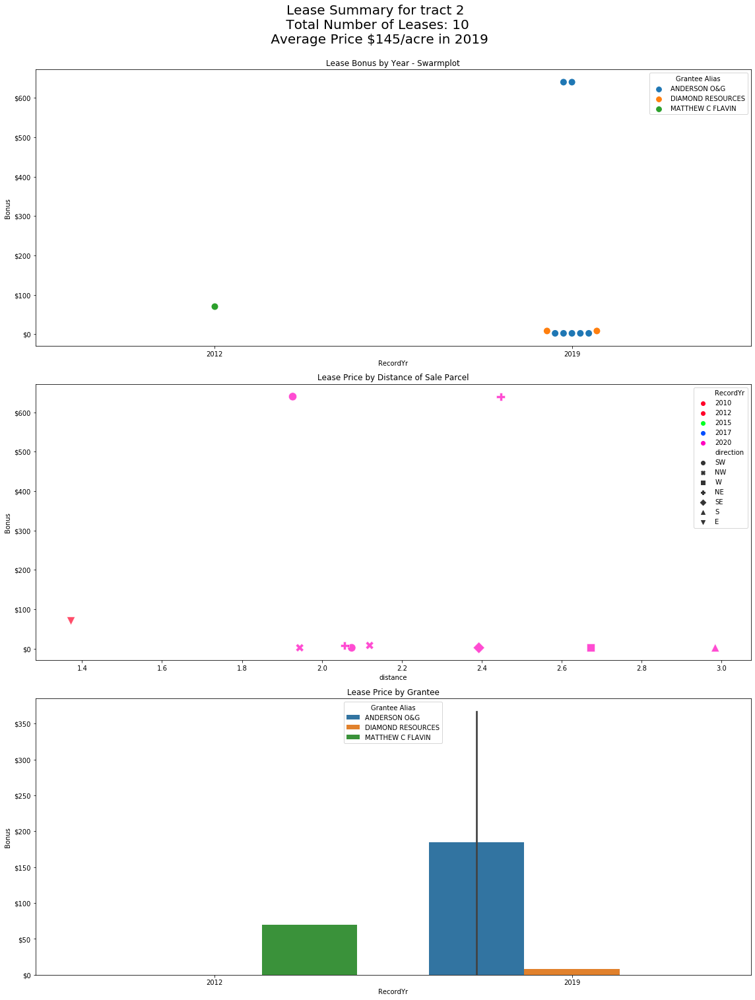

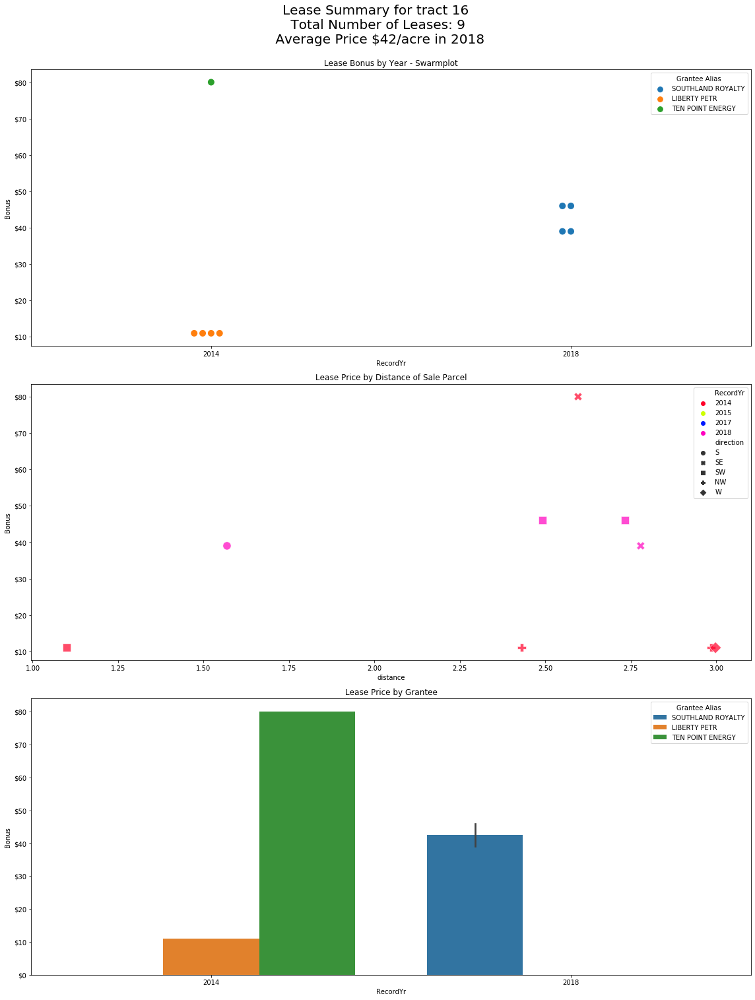

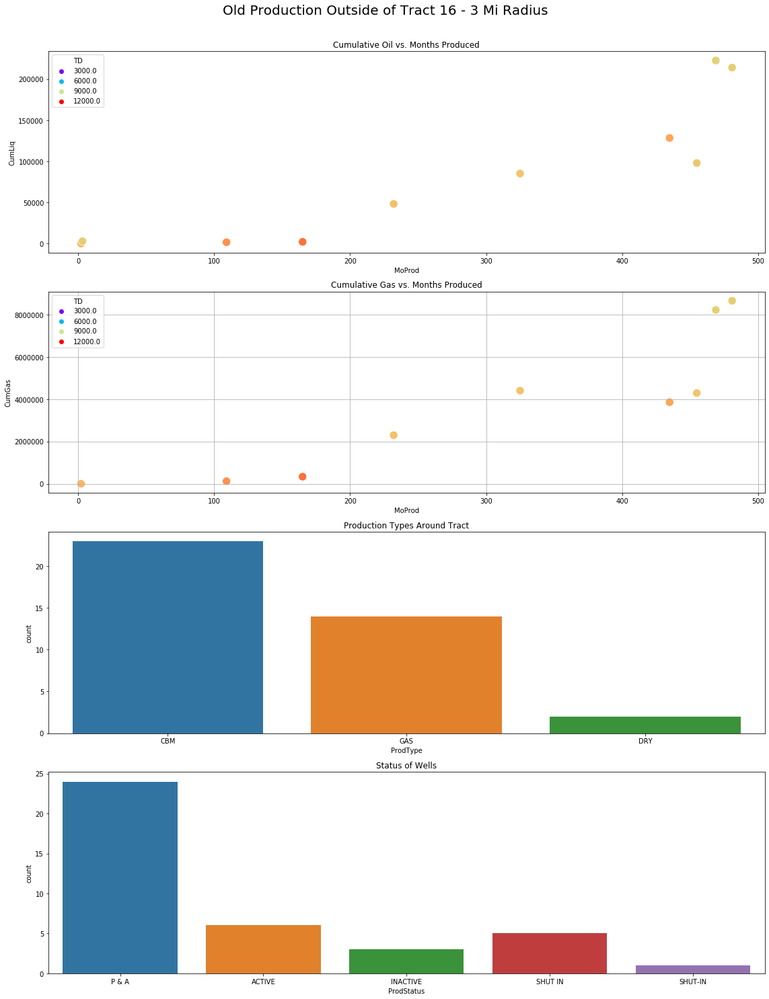

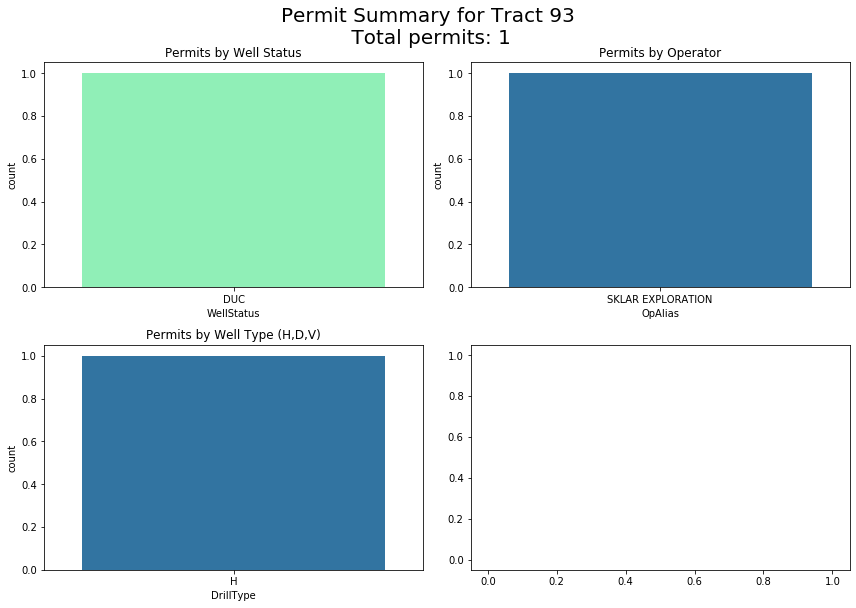

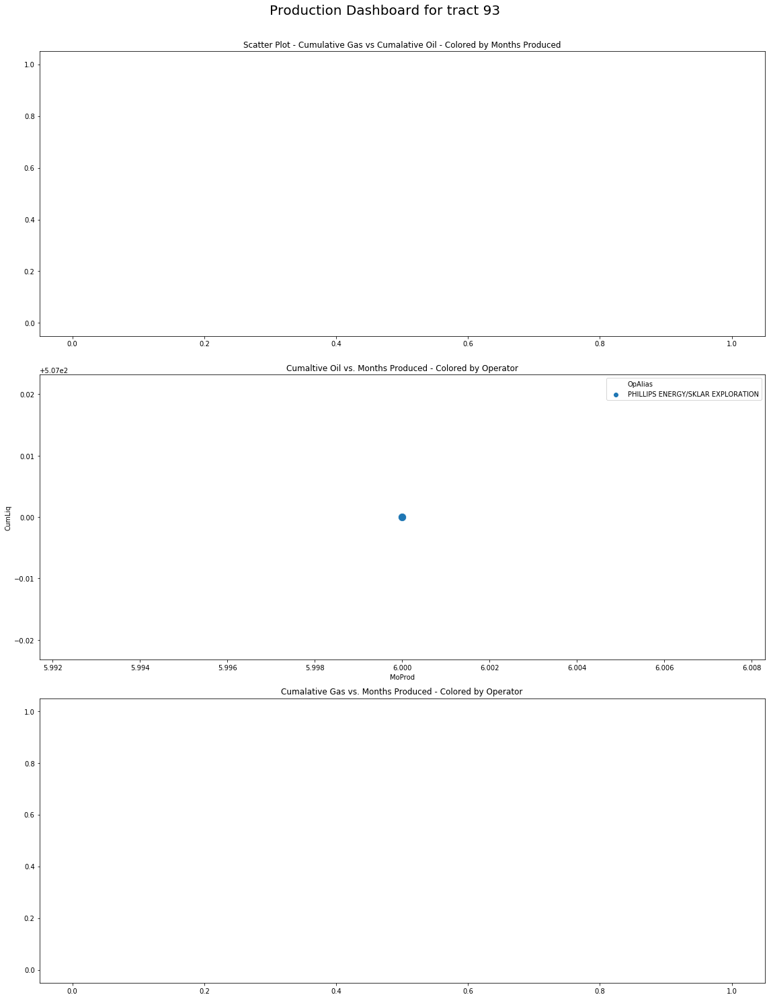

...

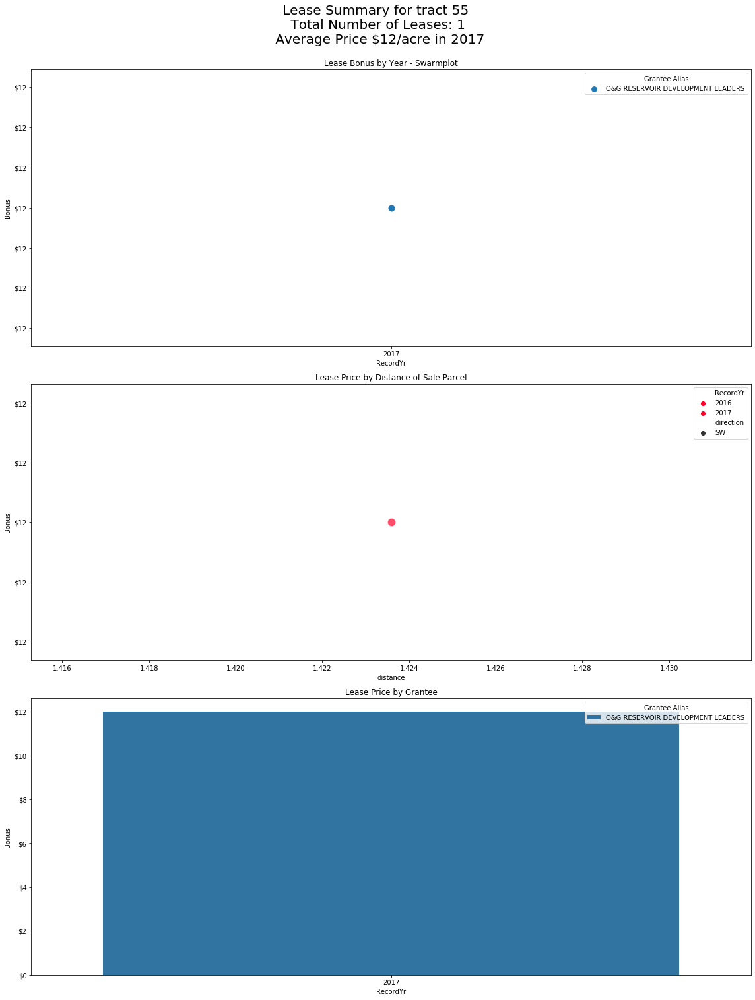

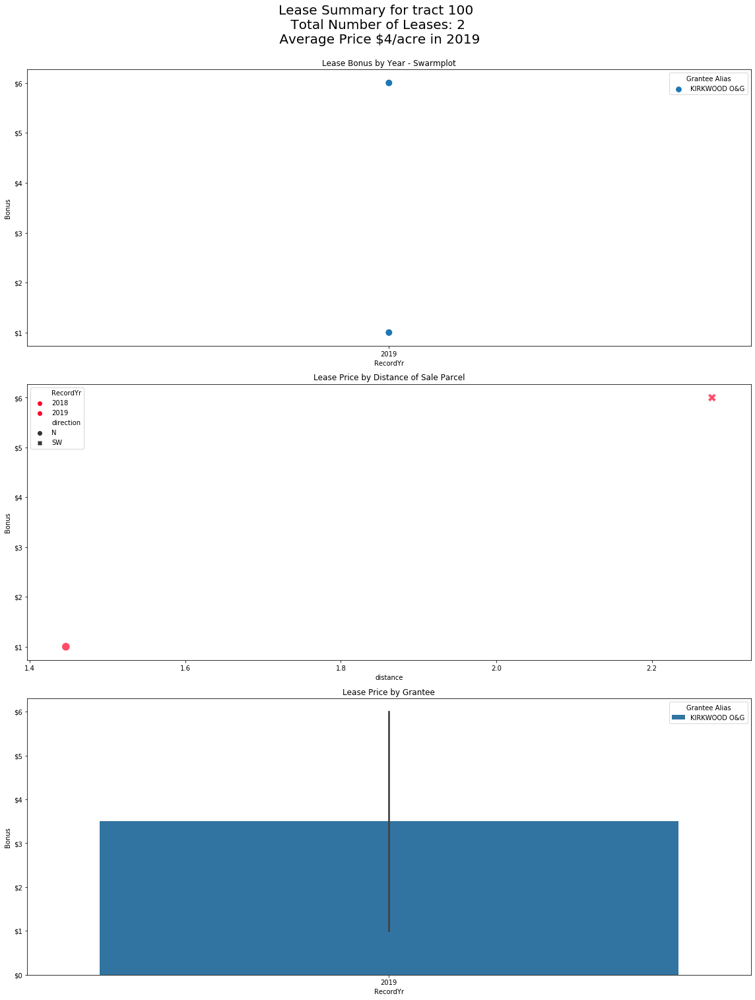

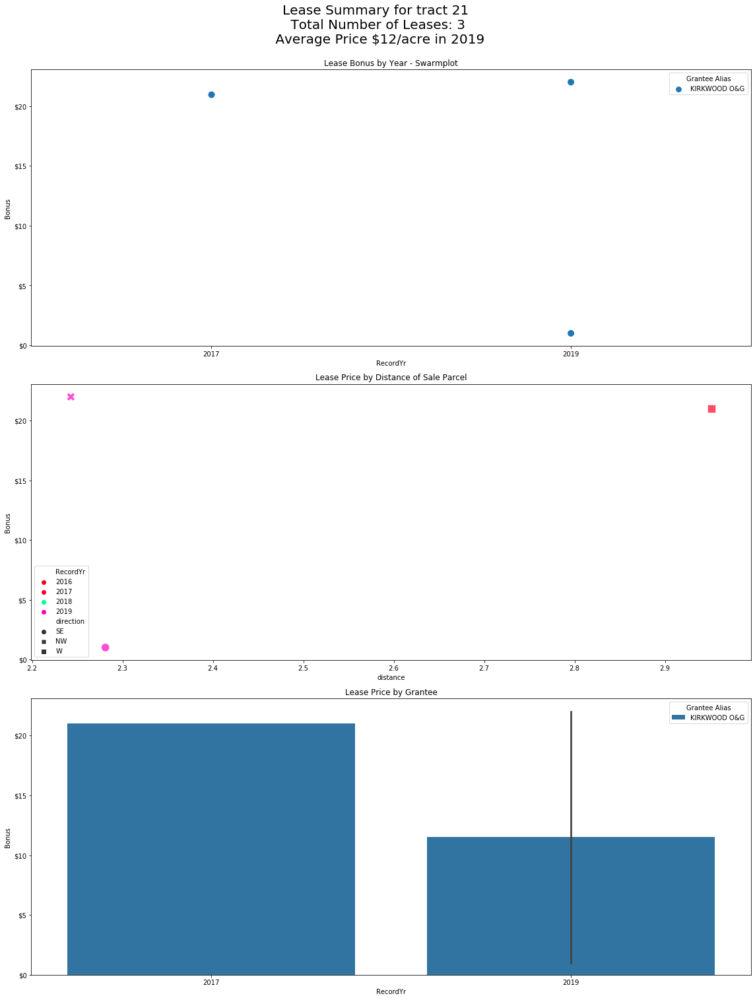

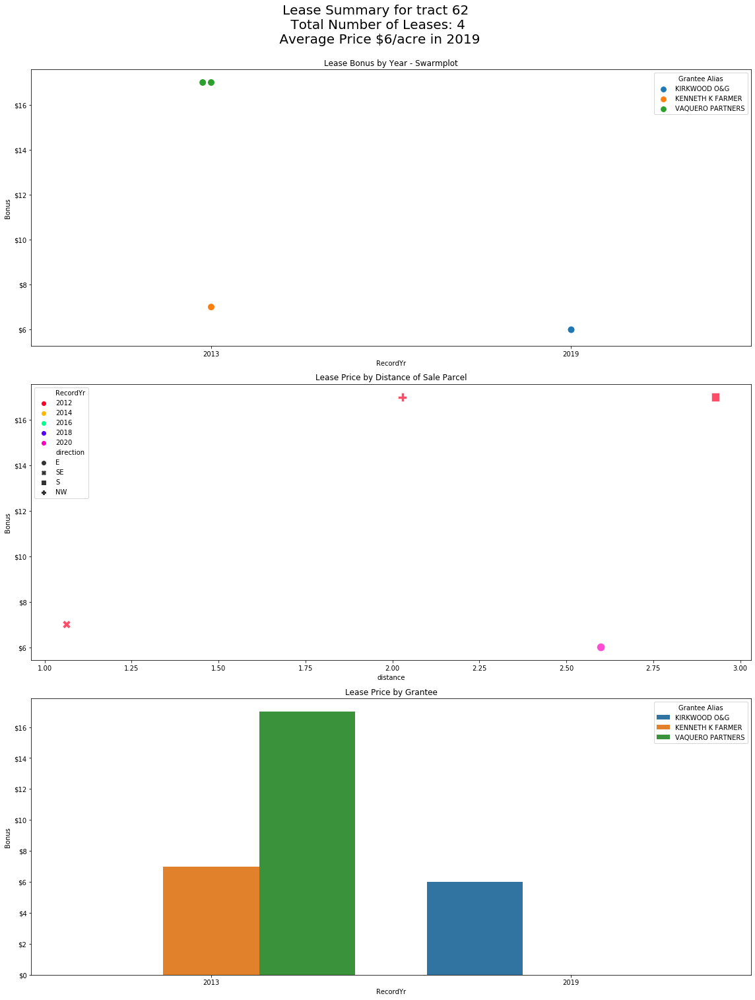

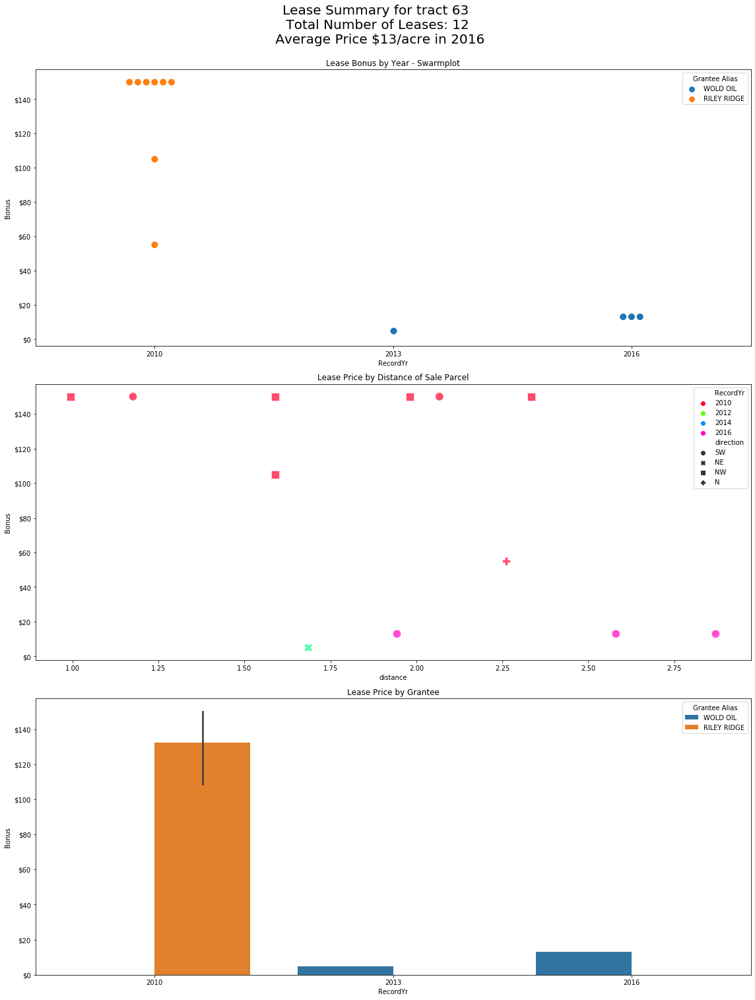

In [213]:
#creating empty array to append summaries to for each tract
summaryPermits = []
summaryProd = []
summaryLeases = []
summaryOldProd = []

#creating arrays to append visual plots for each tract
perdashboard = []
proddashboard = []
leasedashboard = []
oldproddashboard = []

#looping through each tract id and creating filtered geospatial data, activity summaries, and visualizaiton plots
for i in tractshp["tract_id"]:
    perm, prod, leases, oldprodtoeval = getActivityData(i) 
    
    try:
        summaryPermits.append(writePermitSummary(perm))
    except:
        summaryPermits.append("error occured")
        
    try:
        summaryProd.append(writeProdSummary(prod))
    except:
        summaryProd.append("error occured")
        
    try:
        summaryLeases.append(writeLeaseSummary(leases))
    except: 
        summaryLeases.append("error occured")

    try:
        summaryOldProd.append(writeOldProdSummary(oldprodtoeval, i))
    except: 
        summaryOldProd.append("error occured")

    #appending visualizaiton plots to list    
    perdashboard.append(createPermitDash(perm,i))
    proddashboard.append(createProdDash(prod, i))
    leasedashboard.append(createLeasesDash(leases, i))  
    oldproddashboard.append(createOldProdDash(oldprodtoeval, i))
    

### Appending Results of mass loop of applying summary functions and visualization plots

In [214]:
#appending columns to tract list with summaries for each data type (old prod, leases, permits, new production)
tractshp["Permit Summary"] = summaryPermits

tractshp["Leases Summary"] = summaryLeases

tractshp["Old Production Summary"] = summaryOldProd

tractshp["Recent Prod Summary"] = summaryProd


In [222]:
tractshp

,SaleParcel,lot_no,tract_id,short_code,label,geometry,centroids,Acres,buffers,Permit Summary,Recent Prod Summary,Leases Summary,Old Production Summary,Record Date
0,WY-201Q-105,65012,2,BLMWY-2020-Q1-3,WY-2020-03-0374,"MULTIPOLYGON (((173527.819 4984155.461, 173534...",POINT (172183.913 4984182.822),941.0,"POLYGON ((177011.9325868678 4984182.822180478,...",There are no permits within a 3 mile radius,There are no new wells in the last 4 years wit...,"In a 3 mile radius, the latest leases with bon...",No old wells within tract or in 3 mile radius ...,2020-03-23
1,WY-201Q-063,64970,16,BLMWY-2020-Q1-3,WY-2020-03-6207,"MULTIPOLYGON (((219007.722 4650891.363, 218687...",POINT (222418.619 4647579.181),1322.0,"POLYGON ((227246.6390899617 4647579.181363008,...",There are no permits within a 3 mile radius,There are no new wells in the last 4 years wit...,"In a 3 mile radius, the latest leases with bon...",There are no wells within tract boundaries \n\...,2020-03-23
2,WY-201Q-001,64908,93,BLMWY-2020-Q1-3,WY-2020-03-6613,"POLYGON ((562927.151 4797521.250, 563330.976 4...",POINT (563130.227 4797125.862),80.0,"POLYGON ((567958.2466411376 4797125.862218223,...",In a 3 mile radius there are 1 active permits\...,There are 1 wells within 3 mile radius that ha...,"In a 3 mile radius, the latest leases with bon...",No old wells within tract or in 3 mile radius ...,2020-03-23
3,WY-201Q-002,64909,102,BLMWY-2020-Q1-3,WY-2020-03-6660,"POLYGON ((514894.040 4607634.757, 515295.946 4...",POINT (515096.374 4607429.194),40.0,"POLYGON ((519924.3935113145 4607429.193806222,...",There are no permits within a 3 mile radius,There are no new wells in the last 4 years wit...,"In a 3 mile radius, the latest leases with bon...",No old wells within tract or in 3 mile radius ...,2020-03-23
4,WY-201Q-003,64910,89,BLMWY-2020-Q1-3,WY-2020-03-6585,"MULTIPOLYGON (((518971.985 4775132.462, 519376...",POINT (520545.083 4773447.285),2316.0,"POLYGON ((525373.1034775852 4773447.284539, 52...",There are no permits within a 3 mile radius,There are no new wells in the last 4 years wit...,"In a 3 mile radius, the latest leases with bon...",No old wells within tract or in 3 mile radius ...,2020-03-23
5,WY-201Q-004,64911,101,BLMWY-2020-Q1-3,WY-2020-03-6659,"MULTIPOLYGON (((514930.329 4772688.182, 514924...",POINT (516650.481 4768918.590),1606.0,"POLYGON ((521478.5009783835 4768918.590232695,...",There are no permits within a 3 mile radius,There are no new wells in the last 4 years wit...,"In a 3 mile radius, the latest leases with bon...",No old wells within tract or in 3 mile radius ...,2020-03-23
6,WY-201Q-005,64912,88,BLMWY-2020-Q1-3,WY-2020-03-6584,"POLYGON ((522624.246 4772308.898, 523028.716 4...",POINT (521052.219 4771111.542),2246.0,"POLYGON ((525880.2388925082 4771111.541526825,...",There are no permits within a 3 mile radius,There are no new wells in the last 4 years wit...,"In a 3 mile radius, the latest leases with bon...",No old wells within tract or in 3 mile radius ...,2020-03-23
7,WY-201Q-006,64913,103,BLMWY-2020-Q1-3,WY-2020-03-6661,"POLYGON ((513730.083 4770685.496, 514132.579 4...",POINT (513929.602 4770284.918),80.0,"POLYGON ((518757.622251393 4770284.918102589, ...",There are no permits within a 3 mile radius,There are no new wells in the last 4 years wit...,"In a 3 mile radius, the latest leases with bon...",No old wells within tract or in 3 mile radius ...,2020-03-23
8,WY-201Q-007,64914,90,BLMWY-2020-Q1-3,WY-2020-03-6601,"MULTIPOLYGON (((519385.970 4768300.589, 518982...",POINT (518765.637 4768212.695),1365.0,"POLYGON ((523593.6567815744 4768212.694521166,...",There are no permits within a 3 mile radius,There are no new wells in the last 4 years wit...,"In a 3 mile radius, the latest leases with bon...",No old wells within tract or in 3 mile radius ...,2020-03-23
9,WY-201Q-008,64915,92,BLMWY-2020-Q1-3,WY-2020-03-6607,"MULTIPOLYGON (((518174.128 4767490.665, 517769...",POINT (518502.128 4766803.853),1326.0,"POLYGON ((523330.147837556 4766803.852802451, ...",The

### Writing Summary Results to File

In [215]:
#saving activity notes in an excel file in the results folder - dropping geopandas required geo cols
tractshp.drop(columns = "geometry centroids buffers".split(" ")).to_excel("Results/Activity Summary Notes.xlsx")

In [216]:
#zipping individual corresponding plots for each tract into one master list
MasterDash = list(zip(perdashboard, proddashboard, leasedashboard, oldproddashboard))

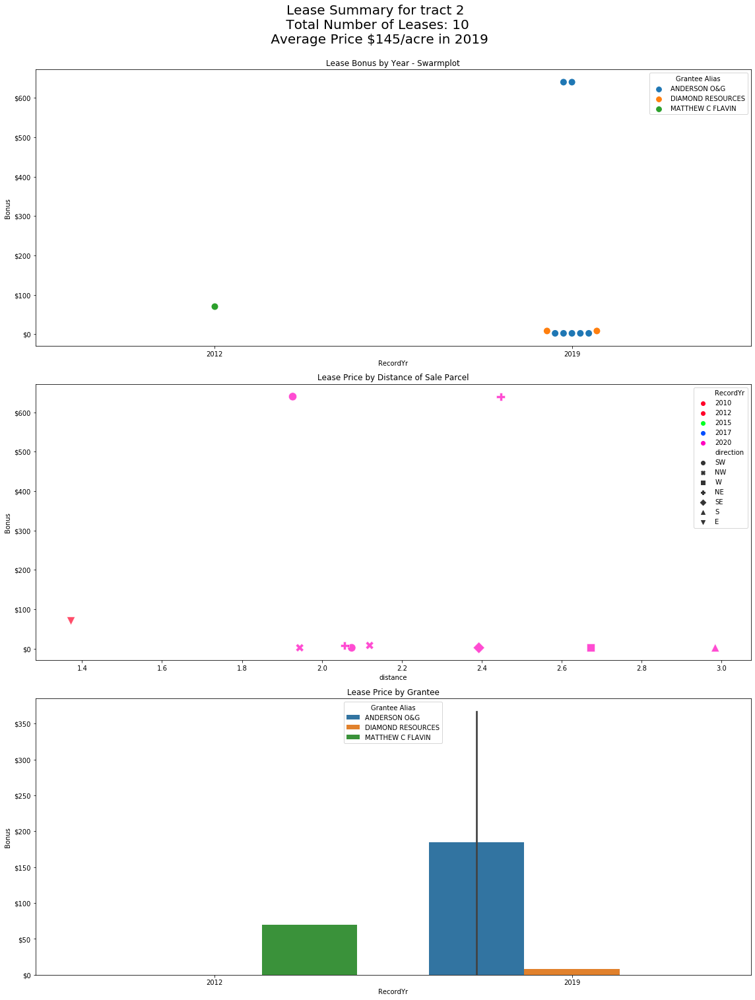

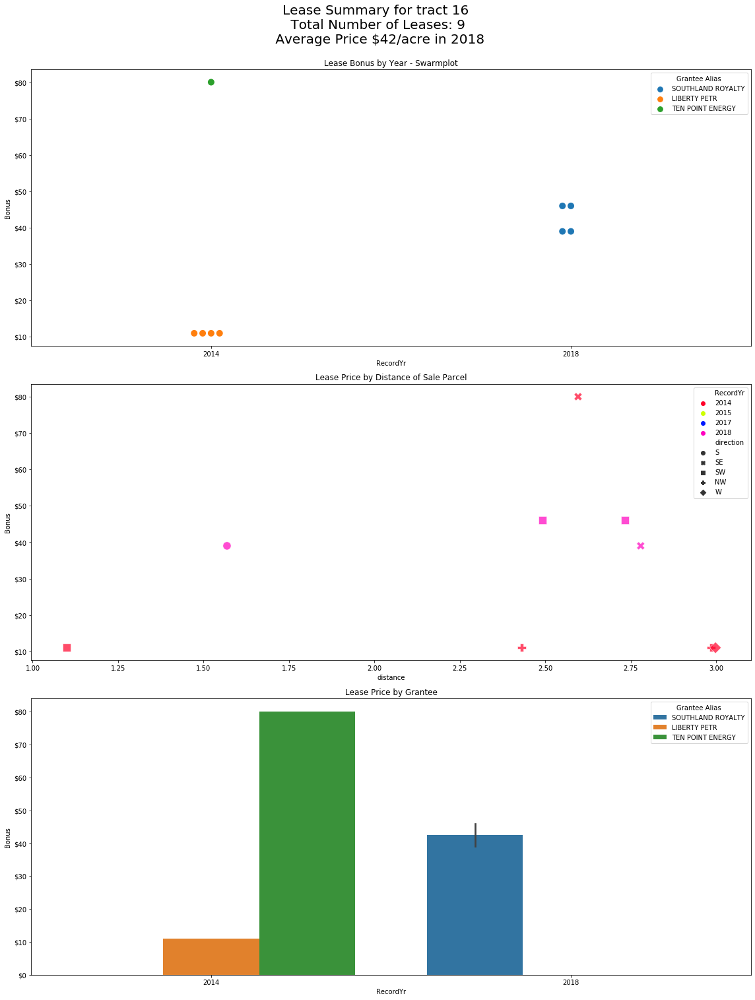

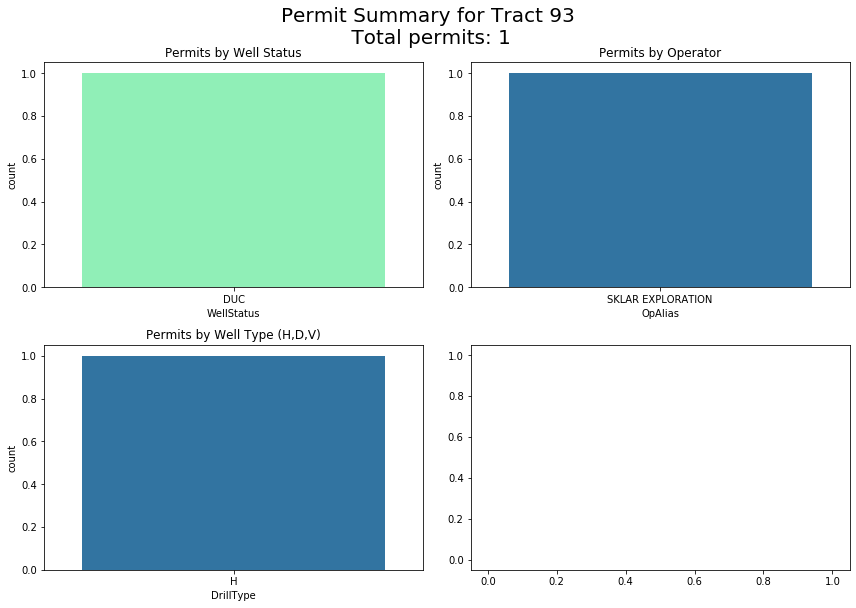

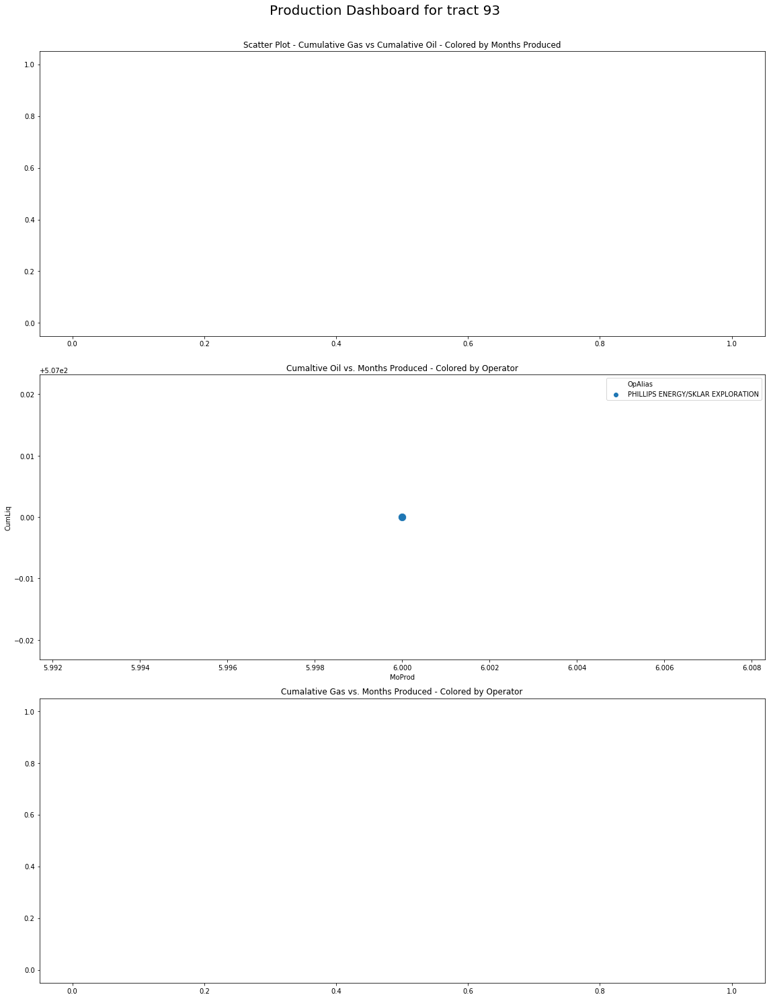

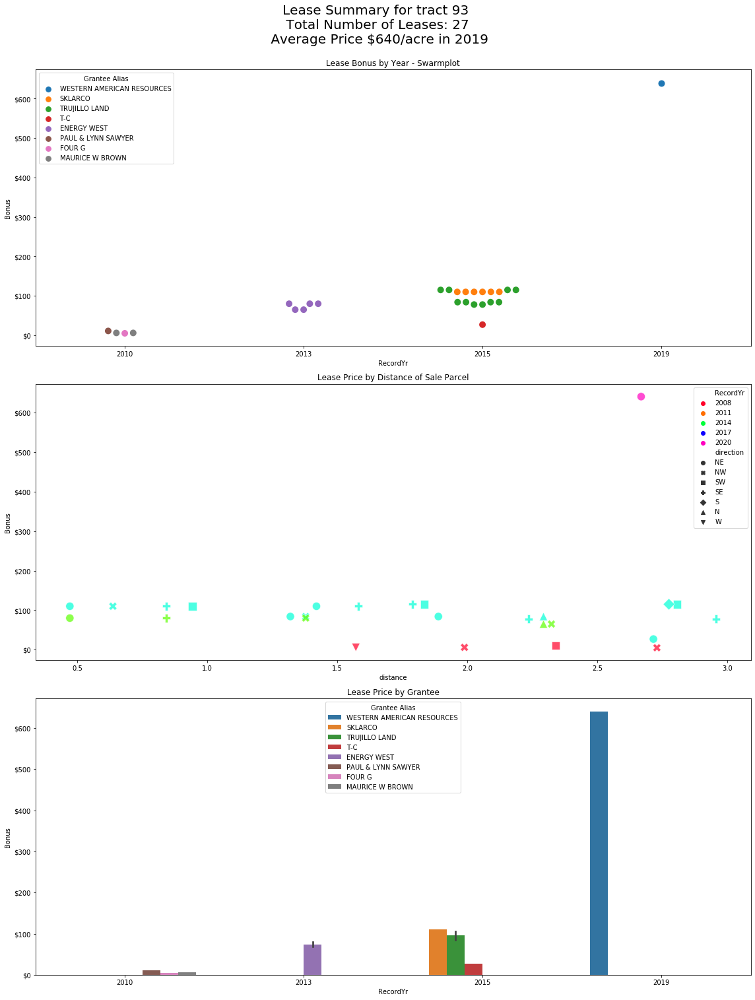

...

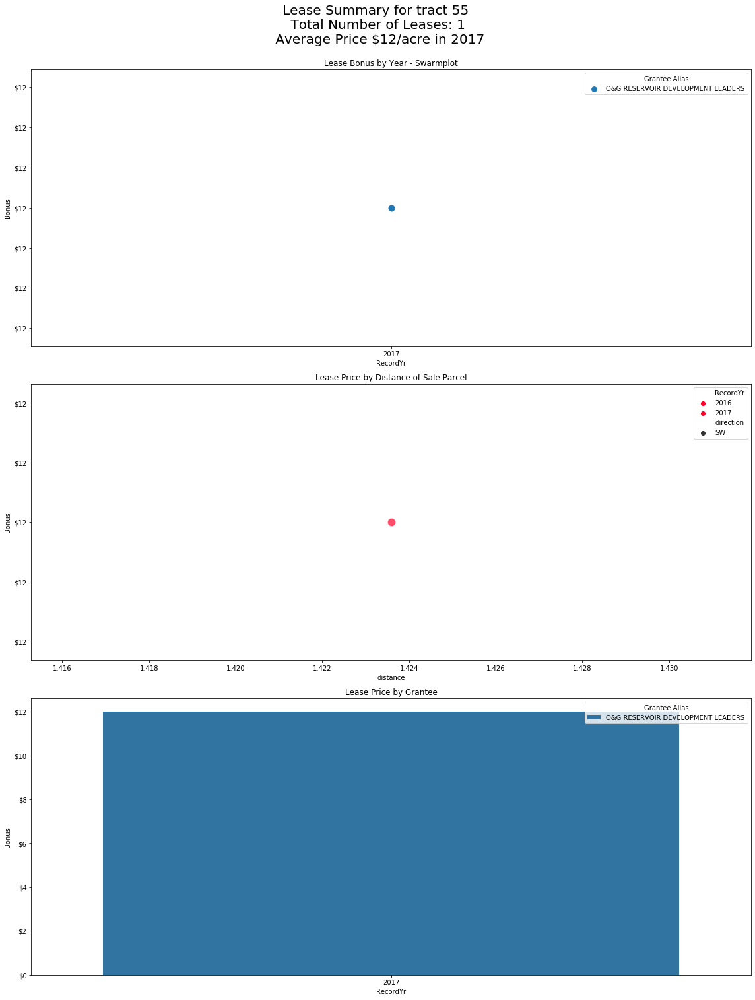

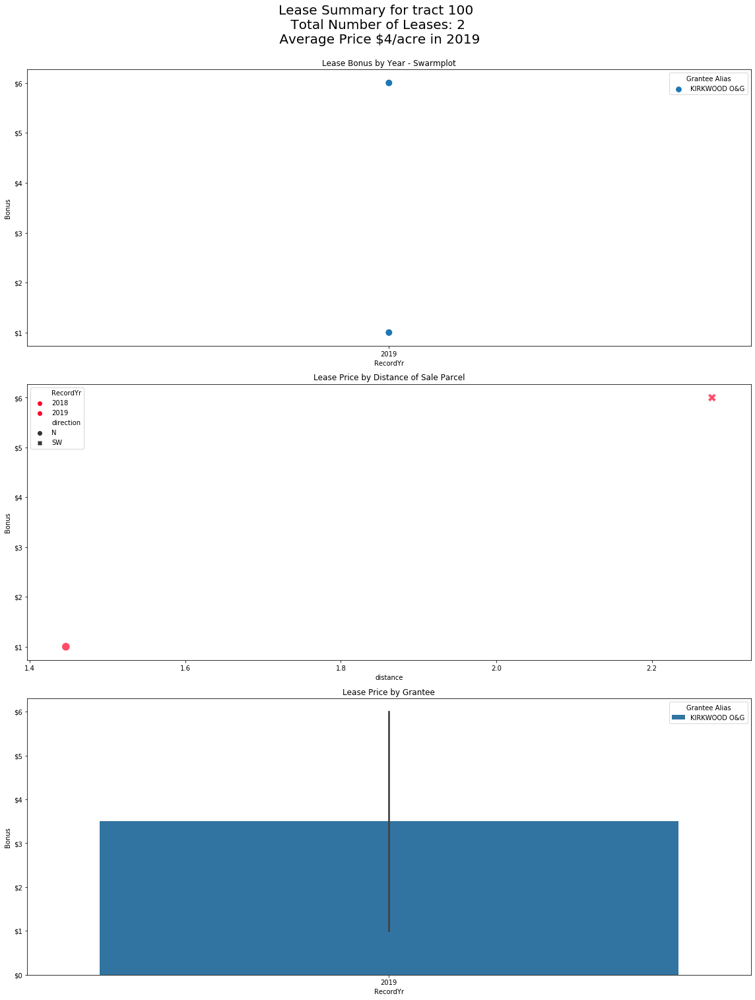

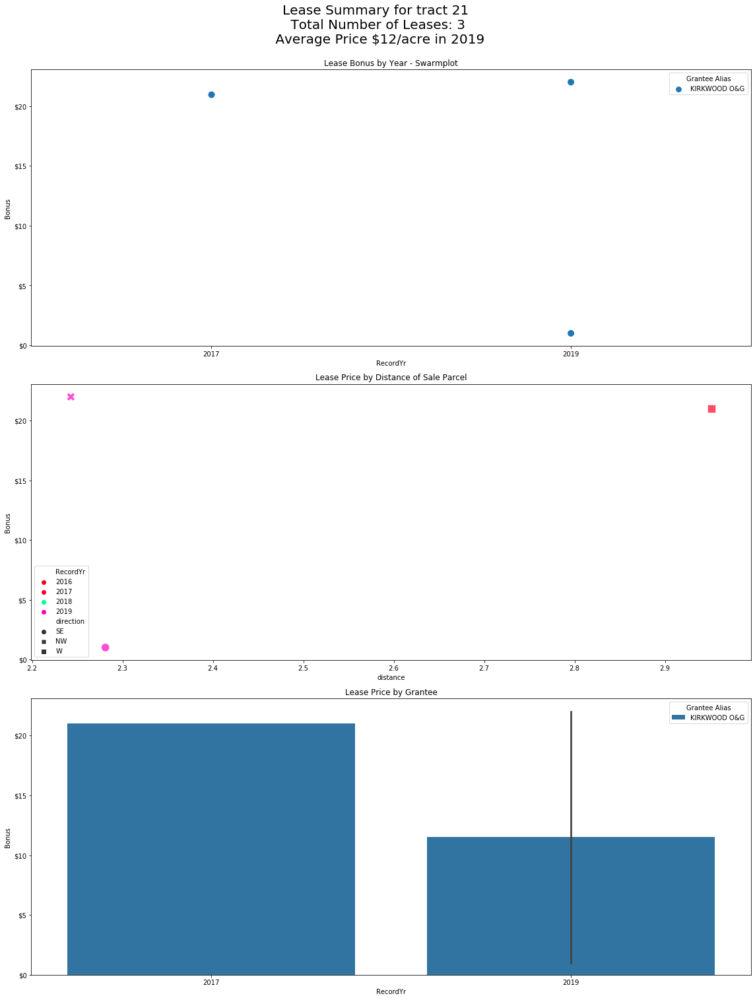

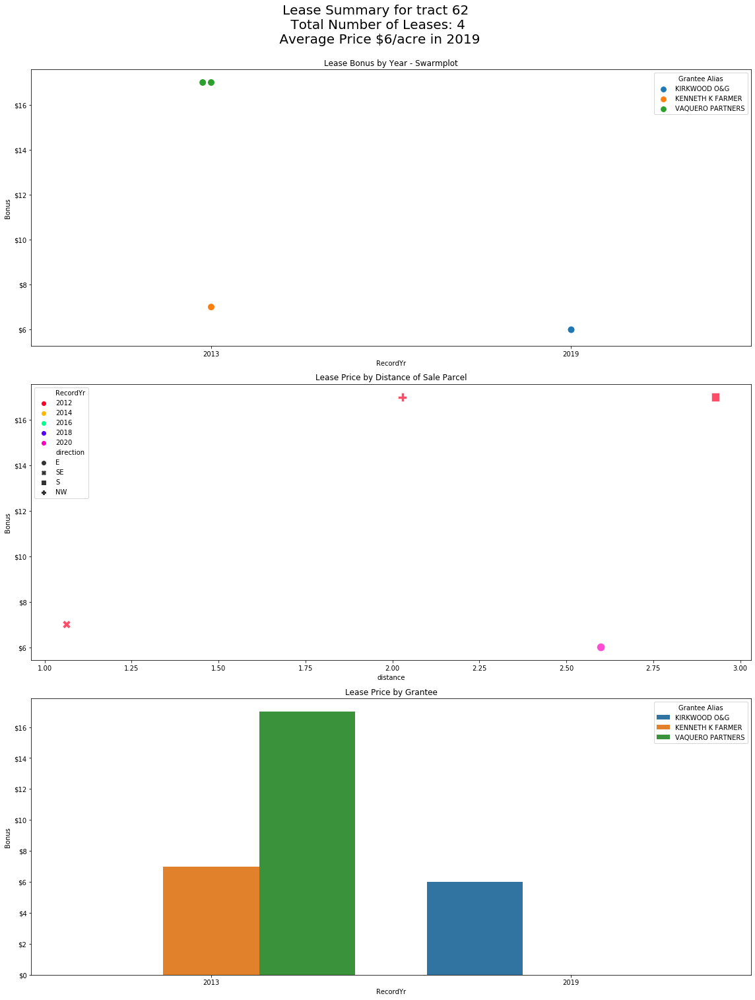

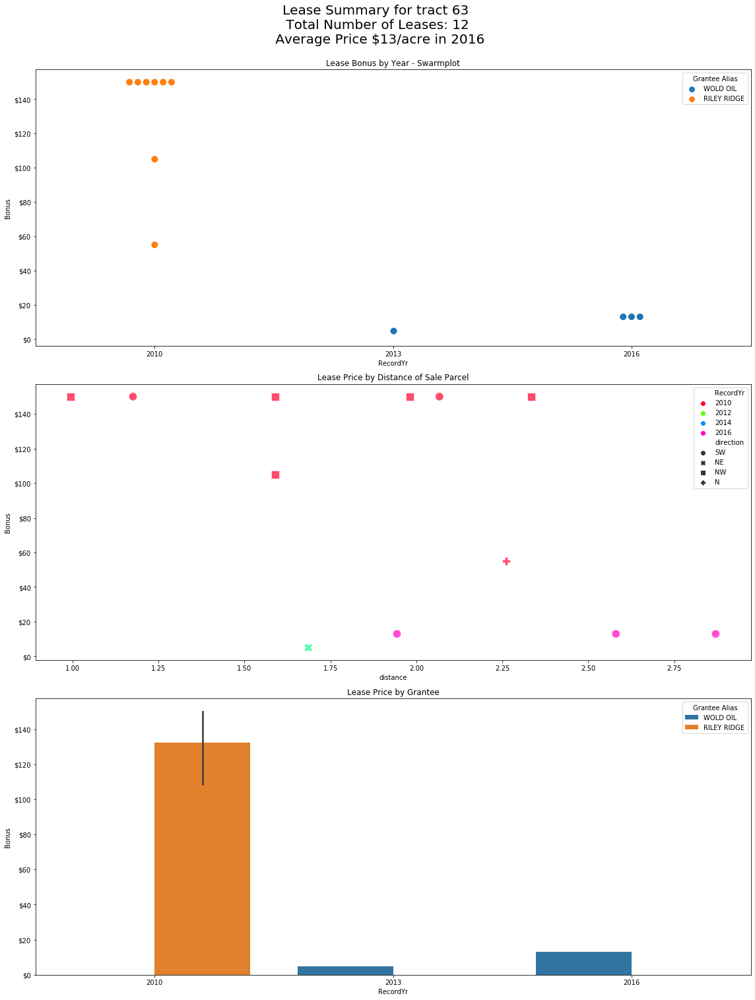

In [55]:
for item in MasterDash:
    for figures in item:
        figures

In [217]:
#saving visualizations in results subfolder called viz
import matplotlib.backends.backend_pdf
pdf = matplotlib.backends.backend_pdf.PdfPages("Results/Permits Leases and Prod Visualizations.pdf")

#loooping through each set of figures for each tract, saving them to pdf
for items in MasterDash:
    for fig in items: 
        try:
            #bbox = tight is to make sure plot titles aren't cut off that have been shifted up
            pdf.savefig(fig, bbox_inches='tight')
        except:
            print("Error Occured - Most likely null figure")
        
pdf.close()


Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure


Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure
Error Occured - Most likely null figure


***
# Machine Learning and Price Projections Section
***

## Data Preparation

### Gathering Oil and Gas Prices

In [787]:
#get historical oil price data
oilPrices = pd.read_excel("Data/oilPrices.xls", sheet_name="Data 1", header=2)

oilPrices.columns

In [5]:
#renaming price column to something more concise 
oilPrices.rename(columns = {'Cushing, OK WTI Spot Price FOB (Dollars per Barrel)' : "WTI Price"} , inplace = True)


In [6]:
#appending data to the data frame for missing months manually - setting march 2020 price to $25/bbl
oilPrices = oilPrices.append({'Date': pd.to_datetime('2020-03-15', format='%Y-%m-%d', errors='ignore'), 'WTI Price': 25}, ignore_index = True)

#Setting the index of the dataframe as the date and then filtering to data within last 10 years
oilPrices.set_index("Date", inplace = True)
oilPrices = oilPrices.loc[oilPrices.index.year > 1999] 

In [8]:
#confirming data appended is present
oilPrices[oilPrices.index.year == 2020]

#view summary of oil prices throughout the years
oilPrices.groupby(oilPrices.index.year).describe()

,WTI Price
Date,
2020-01-15,57.52
2020-02-15,50.54
2020-03-15,25.00


WTI Price                                                           \
         count       mean        std    min      25%      50%       75%   
Date                                                                      
2000      12.0  30.300833   2.668215  25.72  28.7025   29.770   32.1425   
2001      12.0  25.947500   3.568282  19.39  25.1925   27.310   27.8575   
2002      12.0  26.115000   3.174783  19.72  25.2725   26.660   28.5025   
2003      12.0  31.120833   2.317446  28.11  29.8325   30.935   32.3350   
2004      12.0  41.443333   5.867064  34.31  36.7475   40.530   45.1600   
2005      12.0  56.492500   6.260930  46.84  52.1925   57.335   60.1225   
2006      12.0  66.018333   5.476898  58.89  61.8775   64.645   70.8675   
2007      12.0  72.318333  13.217301  54.51  62.7050   69.925   81.3900   
2008      12.0  99.571667  29.067578  41.12  88.8800  104.780  118.8525   
2009      12.0  61.654167  13.795144  39.09  49.2225   66.780   71.9050   
2010      12.0  79.395000   4.722221  73.74  76.0750   77.465   82.4800   
2011      12.0  94.874167   7.671223  85.52  88.0175   96.710   99.1450   
2012      12.0  94.110833   7.566593  82.30  87.8900   94.320  100.7525   
2013      12.0  97.905833   5.278863  92.02  94.3475   95.540  101.5725   
2014      12.0  93.258333  13.768110  59.29  91.0075   98.670  102.0975   
2015      12.0  48.688333   6.755165  37.19  44.8275   47.520   51.7875   
2016      12.0  43.144167   6.837864  30.32  39.9500   44.950   47.2225   
2017      12.0  50.884167   3.813093  45.18  48.3700   50.440   52.7425   
2018      12.0  64.938333   6.458830  49.52  62.6050   67.060   70.0425   
2019      12.0  56.984167   3.394762  51.38  54.7725   56.990   58.5825   
2020       3.0  44.353333  17.119981  25.00  37.7700   50.540   54.0300   

              
         max  
Date          
2000   34.42  
2001   29.61  
2002   29.66  
2003   35.83  
2004   53.28  
2005   65.59  
2006   74.41  
2007   94.77  
2008  133.88  
2009   77.99  
2010   89.15  
2011  109.53  
2012  106.16  
2013  106.57  
2014  105.79  
2015   59.82  
2016   51.97  
2017   57.88  
2018   70.98  
2019   63.86  
2020   57.52

,WTI Price
Date,
2000-01-15,27.26
2000-02-15,29.37
2000-03-15,29.84
2000-04-15,25.72
2000-05-15,28.79


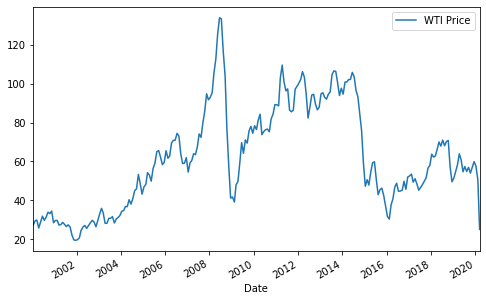

In [7]:
oilPrices.head()

oilPrices.plot(figsize=(8,5))

In [9]:
#get historical gas price data
gasPrices = pd.read_excel("Data/gasPrices.xls", sheet_name="Data 1", header=2)

gasPrices.set_index('Date', inplace = True)
gasPrices.rename(columns = {'Henry Hub Natural Gas Spot Price (Dollars per Million Btu)': 'Gas Price'}, inplace = True)
gasPrices = gasPrices.loc[gasPrices.index.year > 1999] 


gasPrices.groupby(gasPrices.index.year).describe()

## Read and Clean Data for Training Data

Data read in consists of ALL historical leases, leases, and horizontal production within training boundaries set by an AOI shapefile/trace on drillinginfo

In [13]:
AOI = gp.read_file("zip://Data/Training Data/AOI.zip")

In [14]:
#read in csv into pandas first and then convert it into a geopandas dataframe and set crs and geometry column
trainLeasesPandasDF = pd.read_csv("Data/Training Data/LeaseTraining.CSV")
trainLeases = gp.GeoDataFrame(trainLeasesPandasDF, crs = {'init': 'epsg:4326'}, geometry=gp.points_from_xy(trainLeasesPandasDF["Longitude (WGS84)"], trainLeasesPandasDF["Latitude (WGS84)"]))

trainPermits = gp.read_file("zip://Data/Training Data/PermitsTraining.zip")
trainProd = gp.read_file("zip://Data/Training Data/ProdTraining.zip")

In [69]:
trainLeases.info()
trainPermits.info()
trainProd.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4289 entries, 0 to 4288
Data columns (total 42 columns):
State/Province                        4289 non-null object
Effective Date                        2063 non-null object
Record Date                           4289 non-null object
Expiration of Primary Term            4288 non-null object
Term (Months)                         4203 non-null float64
Grantor                               4289 non-null object
Grantee Alias                         4266 non-null object
Royalty                               2082 non-null float64
Bonus                                 877 non-null float64
Area (Acres)                          4069 non-null float64
Section                               4289 non-null float64
Township                              4289 non-null float64
Township Direction                    4289 non-null object
Range                                 4289 non-null float64
Range Direction                       4289 non-null o

In [70]:
trainLeases.columns


Index(['State/Province', 'Effective Date', 'Record Date',
       'Expiration of Primary Term', 'Term (Months)', 'Grantor',
       'Grantee Alias', 'Royalty', 'Bonus', 'Area (Acres)', 'Section',
       'Township', 'Township Direction', 'Range', 'Range Direction',
       'Vol/Page', 'Record Number', 'Instrument Type', 'Instrument Date',
       'County/Parish', 'Options/Extensions', 'DI Basin', 'Ext. Bonus',
       'Ext. Term (Months)', 'Abstract', 'Block', 'BLM', 'State Lease',
       'Grantee', 'Grantor Address', 'Grantee Address', 'Max Depth',
       'Majority Legal Assignee', 'DI Subplay', 'Min Depth',
       'Majority Assignment Effective Date', 'Latitude (WGS84)', 'DI Play',
       'Majority Legal Assignee Interest', 'Longitude (WGS84)',
       'Majority Assignment Vol/Page', 'geometry'],
      dtype='object')

In [71]:
#Only keeping pertinent columns for train leases
#dropping leases with no bonus information - bonus will be our response feature
trainLeases = trainLeases.loc[:,["Record Date", "Record Number", "Bonus", "Section", "Township", "Range", "geometry"]]
trainLeases.dropna(axis=0, subset = ["Bonus"], inplace = True)


In [72]:
trainPermits.columns

Index(['API10UWI', 'WGID', 'PermitNo', 'Country', 'OFS_Reg', 'State', 'County',
       'DIBasin', 'DIPlay', 'DISubplay', 'District', 'OpAlias', 'OpCompany',
       'OpReported', 'OpTicker', 'LeaseName', 'WellNo', 'LeaseNo', 'Field',
       'Formation', 'PermitType', 'WellType', 'DrillType', 'PermDepth',
       'PermDUOM', 'TVD', 'TVD_UOM', 'PermStatus', 'WellStatus', 'FiledDate',
       'AprvdDate', 'AmendDate', 'CntctName', 'CntctPhone', 'OperAddrs',
       'OperCity', 'OperState', 'OperZip', 'OperCity30', 'OperCity50',
       'Section', 'Township', 'Range', 'Block', 'Survey', 'Abstract',
       'H2S_Area', 'Latitude', 'Longitude', 'Btm_Lat', 'Btm_Lon', 'ExpDate',
       'geometry'],
      dtype='object')

In [73]:
trainPermits.drop(columns=['Country', 'OFS_Reg', 'State', 'County',
       'DIBasin', 'DIPlay', 'DISubplay', 'District', 'OpAlias', 'OpCompany',"DISubplay",'AmendDate', 'CntctName', 'CntctPhone', 'OperAddrs',
       'OperCity', 'OperState', 'OperZip', 'OperCity30', 'OperCity50', 'H2S_Area'], inplace = True)

In [74]:
pd.options.display.max_columns = None
trainProd.info()



<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 7471 entries, 0 to 7470
Columns: 111 entries, APIUWI to geometry
dtypes: float64(66), geometry(1), int64(2), object(42)
memory usage: 6.3+ MB


In [75]:
trainProd.drop(columns = ['EntityType','OCS_Area', 'PGC_Area','EntityId', 'OpTicker', 'OpReported', 'OpCompany',
                          'OtherNo','DIBasin', 'DIPlay','DISubplay','CumWtr','CumMMCFGE','CumBCFGE', 
                          'PrcIPCFGED','PracIP_BOE','LastTestDt','LastFlwPrs','LastWHSIP','2moGOR','LatestGOR',
                          'CumGOR','Lst12Yield','2moYield','LatestYld','PeakGas','PkGasMoNo','PeakLiq','PkLiqMoNo',
                          'PeakBOE','PkBOEMoNo','PkMMCFGE','PkMMCFGMoN','TopPerf','BtmPerf','GasGrav',
                          'OilGrav','CompDate','Field','Country','State','District','GeoProvin'], inplace = True)

In [76]:
#finding any columns containing water information and dropping them
watercols = list(filter(lambda x: "wtr" in x.lower() or "water" in x.lower(), trainProd.columns))

In [77]:
trainProd.drop(columns = watercols, inplace=True)


trainProd.columns

Index(['APIUWI', 'OpAlias', 'LeaseName', 'WellNo', 'County', 'Reservoir',
       'ProdType', 'ProdStatus', 'DrillType', 'LeaseNo', 'FstPrdDate',
       'LstPrdDate', 'CumGas', 'CumLiq', 'CumBOE', 'DailyGas', 'DailyLiq',
       '1moLiq', '1moGas', '6moLiq', '6moGas', '6moBOE', '12moLiq', '12moGas',
       '12moBOE', '12MMCFGE', '24moLiq', '24moGas', '24moBOE', '24moMMCFGE',
       '60moLiq', '60moGas', '60moBOE', '60moMMCFGE', 'PracIP_Liq',
       'PracIP_Gas', 'LatestLiq', 'LatestGas', 'Prior12Liq', 'Prior12Gas',
       'WellCount', 'MaxActvWel', 'MoProd', 'GasGather', 'LiqGather',
       'SpudDate', 'TD', 'TVD', 'PerfLength', 'Section', 'Township', 'Range',
       'Abstract', 'Block', 'Survey', 'Latitude', 'Longitude', 'Last12Liq',
       'Last12Gas', 'geometry'],
      dtype='object')

In [78]:
#dropping production where there are null values for first prod date
trainProd.dropna(subset=['FstPrdDate'], inplace=True)

#convert date columns to date time for date filtering 
convertoDateTime(trainProd, trainLeases,trainPermits)

#convert CRS for each dataframe
convertCRS(AOI, trainProd, trainLeases, trainPermits)

In [80]:
trainLeases.info()
trainPermits.info()
trainProd.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 877 entries, 57 to 4288
Data columns (total 7 columns):
Record Date      877 non-null datetime64[ns]
Record Number    877 non-null object
Bonus            877 non-null float64
Section          877 non-null float64
Township         877 non-null float64
Range            877 non-null float64
geometry         877 non-null geometry
dtypes: datetime64[ns](1), float64(4), geometry(1), object(1)
memory usage: 54.8+ KB
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2799 entries, 0 to 2798
Data columns (total 33 columns):
API10UWI      2799 non-null object
WGID          2799 non-null object
PermitNo      2799 non-null object
OpReported    2799 non-null object
OpTicker      1479 non-null object
LeaseName     2799 non-null object
WellNo        2799 non-null object
LeaseNo       2462 non-null object
Field         2799 non-null object
Formation     2799 non-null object
PermitType    2799 non-null object
WellType      2799 non-null 

## Testing Out Data gathering and modeling on sample tract

 import training data for certain AOI
 permit data will include all permits for new wells in the AOI
 prod data will include wells within last 8 years
 training will be don by looking at a lease sold with a bonus price, then determine how many permits, production, etc there was for that particular lease during the time of the sale
 therefore, we will to filter down the dataset for a buffer around that lease
 then using custom measures,  oil price, bbls per month per well, number of permits by type, permits by type * avg prod in area, etc = lease bonus


### Initializing Learning Columns

In [ ]:
#creating buffer column with 3 mi radius for each lease datapoint in training Leases data
trainLeases["buffers"] = trainLeases.buffer(milesbuffer)

In [43]:
#creating list of columns for learning variables on particular lease
learningCols = ["Total Permits", "Total Wells", "Avg First 6 Mo Oil", "Avg First 6 Mo Gas", "Qi Oil", "Qi Gas", "6 Mo Oil Revenue $", "6 Mo Gas Rev $", "Oil Price", "Gas Price" ]

In [7]:
#initializing null values to colums containing varialbes to learn
for col in learningCols:
    trainLeases[col] = np.nan

In [8]:
#creating a list for response and predictor features in order to easily call exploratory plots 
MLPredandResponseCols = []
MLPredandResponseCols.append("Bonus")
for col in learningCols:
    MLPredandResponseCols.append(col)
MLPredandResponseCols

['Bonus',
 'Total Permits',
 'Total Wells',
 'Avg First 6 Mo Oil',
 'Avg First 6 Mo Gas',
 'Qi Oil',
 'Qi Gas',
 '6 Mo Oil Revenue $',
 '6 Mo Gas Rev $',
 'Oil Price',
 'Gas Price']

## Test Code for getting training measures

In [84]:
#testing
leaseDf = trainLeases[trainLeases["Record Number"] == 'WYW182806']
leaseDf = leaseDf.iloc[0]

#pulling date from lease for evaluations to create filter on permit and prod datasets
filterDate = leaseDf["Record Date"]
filterDate

#filtering production dataframe to within buffer of lease for evaluation & only wells taht had started producing before the date lease was recorded
prodFilter = trainProd.loc[trainProd.within(leaseDf["buffers"])]
prodFilter = trainProd.loc[trainProd["FstPrdDate"] <= filterDate]

#filtering production dataframe to within buffer of lease for evaluation & only wells taht had started producing before the date lease was recorded
permFilter = trainPermits.loc[trainPermits.within(leaseDf["buffers"])]

#creating a filter to only show active permits within time lease was purchased
permFilter = trainPermits.loc[(trainPermits["ExpDate"]>=filterDate) & (trainPermits["AprvdDate"]<=filterDate)]



Timestamp('2014-02-11 00:00:00')

In [85]:
#saving learning variable: total number of active permits
totalActivePermits = len(permFilter)

totalActivePermits

233

In [86]:
#finding month in oil and gas price dataframes based on record date of lease
#formatting data to find by month and year only
searchMonthYr = "{}-{}".format(filterDate.month, filterDate.year)

#saving gas and oil price from the time of the record date of the lease
oilPriceYr = oilPrices.loc[searchMonthYr]["WTI Price"].iloc[0]
gasPriceYr = gasPrices.loc[searchMonthYr]["Gas Price"].iloc[0]

oilPriceYr, gasPriceYr

(100.82, 6.0)

In [87]:


#getting variables to learn on from production dataframe
totalWells = len(prodFilter)
Avg6MoOilProd = prodFilter["6moLiq"].mean()
Avg6MoGasProd = prodFilter["6moGas"].mean()

#multiplying Initial production daily rates for the given month by 30 to get it into a Qi monthly rate
IPoil = prodFilter["PracIP_Liq"].mean() * 30
IPgas = prodFilter["PracIP_Gas"].mean() * 30

totalWells, Avg6MoOilProd,Avg6MoGasProd, IPoil, IPgas

(412,
 17446.01265822785,
 23989.017721518987,
 4731.334951456311,
 6415.339805825243)

In [88]:
learningCols

#making a list of all the learning variables saved
learningVals = [totalActivePermits, totalWells, Avg6MoOilProd,Avg6MoGasProd, IPoil, IPgas, oilPriceYr, gasPriceYr]

#converting all learning variables to integers to drop float decimals
learningVals = list(map(int, learningVals))

#zipping learning value with the column name it belongs to as a tuple pair
learningPairs = list(zip(learningCols, learningVals))


['Total Permits',
 'Total Wells',
 'Avg First 6 Mo Oil',
 'Avg First 6 Mo Gas',
 'Qi Oil',
 'Qi Gas',
 '6 Mo Oil Revenue $',
 '6 Mo Gas Rev $',
 'Oil Price',
 'Gas Price']

In [89]:
trainLeases[trainLeases["Record Number"] == 'WYW182806'].index
trainLeases.loc[trainLeases.index == 2420]
 
#appending learning value to its corresponding dataframe column for the given lease
for pair in learningPairs:
    trainLeases.loc[trainLeases.index == 2420, pair[0]] = pair[1]
    
trainLeases.loc[trainLeases.index == 2420]

Int64Index([2420, 2421], dtype='int64')

,Record Date,Record Number,Bonus,Section,Township,Range,geometry,buffers,Total Permits,Total Wells,Avg First 6 Mo Oil,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price
2420,2014-02-11,WYW182806,3900.0,10.0,39.0,72.0,POINT (460251.600 4801972.654),"POLYGON ((465079.620 4801972.654, 465056.372 4...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,Record Date,Record Number,Bonus,Section,Township,Range,geometry,buffers,Total Permits,Total Wells,Avg First 6 Mo Oil,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price
2420,2014-02-11,WYW182806,3900.0,10.0,39.0,72.0,POINT (460251.600 4801972.654),"POLYGON ((465079.620 4801972.654, 465056.372 4...",233.0,412.0,17446.0,23989.0,4731.0,6415.0,100.0,6.0,NaN,NaN


## Function for gathering training measures on learning cols based on test code above

In [90]:
learningCols

['Total Permits',
 'Total Wells',
 'Avg First 6 Mo Oil',
 'Avg First 6 Mo Gas',
 'Qi Oil',
 'Qi Gas',
 '6 Mo Oil Revenue $',
 '6 Mo Gas Rev $',
 'Oil Price',
 'Gas Price']

In [91]:
def getTrainingMeasures(LeasesForEval, leaseIndex, trainProd, trainPermits):
    
    '''
    This function will take in 3 dataframes
    1. LeasesForEval will be the cleaned dataframe that holds lease information with bonus prices
    2. trainProd is the cleaned dataframe that holds production necessary for evaluating leases
    3. trainPermits is the cleaned dataframe that holds permits necessary for evaluating leases
    
    The function will take in an index from the LeasesForEval to perform the following actions:
        - The fuction will filter and retrieve permit and production data within a 3 mile radius from the lease point
        - It will also find the oil/gas price for the month the lease was recorded
        - Filters will be applied to the found permit and production data in order to get a snapshot of the data that existed during the time of purchasing the lease
        - Measures such as average First 6 month oil production and total number of wells will be stored in columns as the inputs (x vars) for the ML model
    '''
    
    #Getting single lease from data 
    leaseDf = LeasesForEval.loc[LeasesForEval.index == leaseIndex]
    leaseDf = leaseDf.iloc[0]
    
    
    #pulling date from lease for evaluations to create filter on permit and prod datasets
    filterDate = leaseDf["Record Date"]

    #filtering production dataframe to within buffer of lease for evaluation & only wells taht had started producing before the date lease was recorded
    prodFilter = trainProd.loc[trainProd.within(leaseDf["buffers"])]
    prodFilter = prodFilter.loc[prodFilter["FstPrdDate"] <= filterDate]

    #filtering production dataframe to within buffer of lease for evaluation & only wells taht had started producing before the date lease was recorded
    permFilter = trainPermits.loc[trainPermits.within(leaseDf["buffers"])]

    #creating a filter to only show active permits within time lease was purchased
    permFilter = permFilter.loc[(permFilter["ExpDate"]>=filterDate) & (permFilter["AprvdDate"]<=filterDate)]

    #saving learning variable: total number of active permits
    totalActivePermits = len(permFilter)
    
    #finding month in oil and gas price dataframes based on record date of lease
    #formatting data to find by month and year only
    searchMonthYr = "{}-{}".format(filterDate.month, filterDate.year)

    #saving gas and oil price from the time of the record date of the lease
    oilPriceYr = oilPrices.loc[searchMonthYr]["WTI Price"].iloc[0]
    gasPriceYr = gasPrices.loc[searchMonthYr]["Gas Price"].iloc[0]
    
    #getting variables to learn on from production dataframe
    totalWells = len(prodFilter)
    Avg6MoOilProd = prodFilter["6moLiq"].mean()
    Avg6MoGasProd = prodFilter["6moGas"].mean()

    #multiplying Initial production daily rates for the given month by 30 to get it into a Qi monthly rate
    IPoil = prodFilter["PracIP_Liq"].mean() * 30
    IPgas = prodFilter["PracIP_Gas"].mean() * 30
    
    First6MoOilRev = Avg6MoOilProd*oilPriceYr
    First6MoGasRev = Avg6MoGasProd*gasPriceYr
    
    #making a list of all the learning variables saved
    learningVals = [totalActivePermits, totalWells, Avg6MoOilProd,Avg6MoGasProd, IPoil, IPgas, First6MoOilRev, First6MoGasRev, oilPriceYr, gasPriceYr]


    #zipping learning value with the column name it belongs to as a tuple pair
    learningPairs = list(zip(learningCols, learningVals))
    
    #appending learning value to its corresponding dataframe column for the given lease
    for pair in learningPairs:
        LeasesForEval.loc[LeasesForEval.index == leaseIndex, pair[0]] = pair[1]
    
    #storing state of filter in order to review for quality assurance - will append to list when function is called in loop
    permFilter["LeaseIndex"] = leaseIndex
    prodFilter["LeaseIndex"] = leaseIndex
    
    return permFilter, prodFilter
    

### Running function to get training measures on all leases from Lease Training Data

In [92]:
trainPermFilters = []
trainProdFilters = []
for index in trainLeases.index:
    FilteredTrainingPerm, FilteredTrainingProd = getTrainingMeasures(trainLeases, index, trainProd, trainPermits)
    
    trainPermFilters.append(FilteredTrainingPerm)
    trainProdFilters.append(FilteredTrainingProd)

### Exporting Training Measures to File

In [93]:
#saving file with learning features values into an excel file
trainLeases.to_excel("Output Data/Training Leases Activity Data/TrainLeases - Learning Features.xlsx")

#saving filtered permits around training leases for quality assurance and validation
pd.concat(trainPermFilters).to_excel('Output Data/Training Leases Activity Data/Full Permit Data On Training Leases.xlsx')

#saving filtered prod around training leases for quality assurance and validation
pd.concat(trainProdFilters).to_excel('Output Data/Training Leases Activity Data/Full Prod Data On Training Leases.xlsx')

# Exploratory Data on Features and Target

### Reading In DataFrame with Training Mesures

In [10]:
#importing Trainleases with training measure from export/output folder to prevent re-running script
trainLeases = pd.read_excel("Output Data/Training Leases Activity Data/TrainLeases - Learning Features.xlsx")

#creating columns wiht combined township and range in order to groupby each TWR on a single row
trainLeases["TWSHP"] = trainLeases["Township"].apply(lambda x: str(x)) + " " + trainLeases["Range"].apply(lambda y: str(y))

#Adding record year as a column to use it as a metric to see how the data stacks up by year
trainLeases["Record Year"] = trainLeases["Record Date"].apply(lambda x: x.year)

In [11]:
trainLeases.head()
trainLeases.rename(columns={'Unnamed: 0': "LeaseIndex"}, inplace = True)
trainLeases.set_index("LeaseIndex", inplace = True)

,Unnamed: 0,Record Date,Record Number,Bonus,Section,Township,Range,geometry,buffers,Total Permits,...,Avg First 6 Mo Oil,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price,TWSHP,Record Year
0,57,2019-12-11,WYW189586,1527,3,39,73,POINT (450547.6131938574 4803344.147960225),"POLYGON ((455375.6331938574 4803344.147960225,...",9,...,15299.416667,46031.020833,3210.612245,9631.836735,9.161291e+05,102188.866250,59.88,2.22,39 73,2019
1,58,2019-12-11,WYW189586,1527,9,39,73,POINT (448886.0374564391 4801760.549607107),"POLYGON ((453714.0574564391 4801760.549607107,...",14,...,14679.767857,38966.214286,3319.473684,8427.894737,8.790245e+05,86504.995714,59.88,2.22,39 73,2019
2,59,2019-12-11,WYW189590,302,27,39,73,POINT (450464.34694615 4796947.371161564),"POLYGON ((455292.36694615 4796947.371161564, 4...",10,...,17782.297297,49281.540541,3801.315789,10975.263158,1.064804e+06,109405.020000,59.88,2.22,39 73,2019
3,60,2019-12-11,WYW189596,1535,32,40,73,POINT (447329.5662888384 4804957.255790628),"POLYGON ((452157.5862888384 4804957.255790628,...",6,...,8980.725000,33128.175000,2092.325581,6826.046512,5.377658e+05,73544.548500,59.88,2.22,40 73,2019
4,61,2019-12-11,WYW189593,752,28,40,73,POINT (448968.4909649936 4806538.52595432),"POLYGON ((453796.5109649936 4806538.52595432, ...",6,...,7941.240000,20281.240000,1899.230769,4250.769231,4.755215e+05,45024.352800,59.88,2.22,40 73,2019


### Reading in Filtered Training Prod and Permits for Each Lease
 * will use to cross check and validate data accuracy if needed

In [12]:
#reading in filtered Training Production and Permit Data

DFtrainProdFilter = pd.read_excel('Output Data/Training Leases Activity Data/Full Prod Data On Training Leases.xlsx')
DFtrainPermFilter= pd.read_excel('Output Data/Training Leases Activity Data/Full Permit Data On Training Leases.xlsx')

DFtrainPermFilter.drop(DFtrainPermFilter.columns[0],axis = 1,  inplace = True)
DFtrainProdFilter.drop(DFtrainProdFilter.columns[0], axis = 1, inplace = True)

DFtrainPermFilter.set_index("LeaseIndex", inplace = True)
DFtrainProdFilter.set_index("LeaseIndex", inplace = True)


### Pair Plots on Response vs All Predictor Features

<Figure size 1008x648 with 0 Axes>

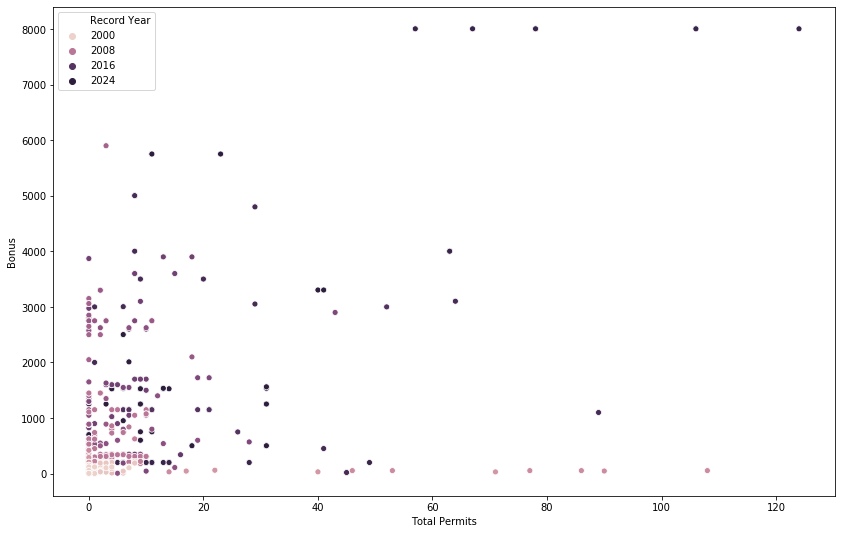

<Figure size 1008x648 with 0 Axes>

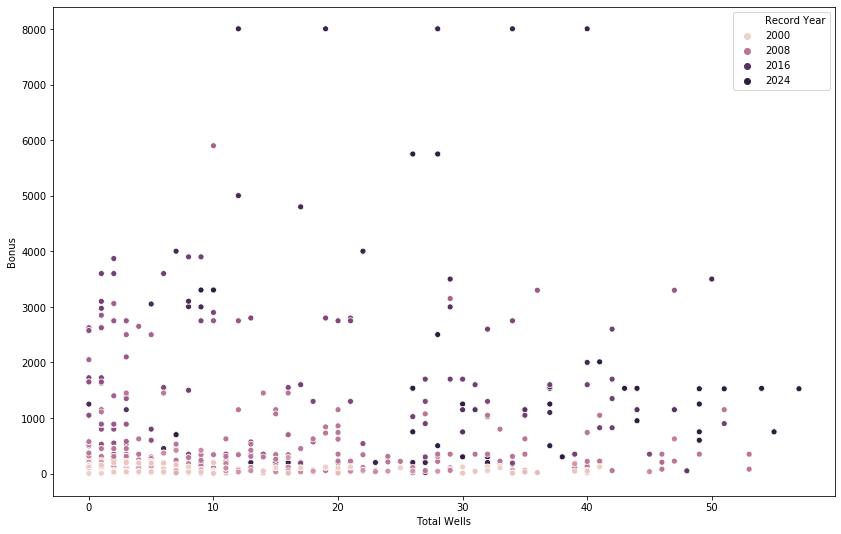

<Figure size 1008x648 with 0 Axes>

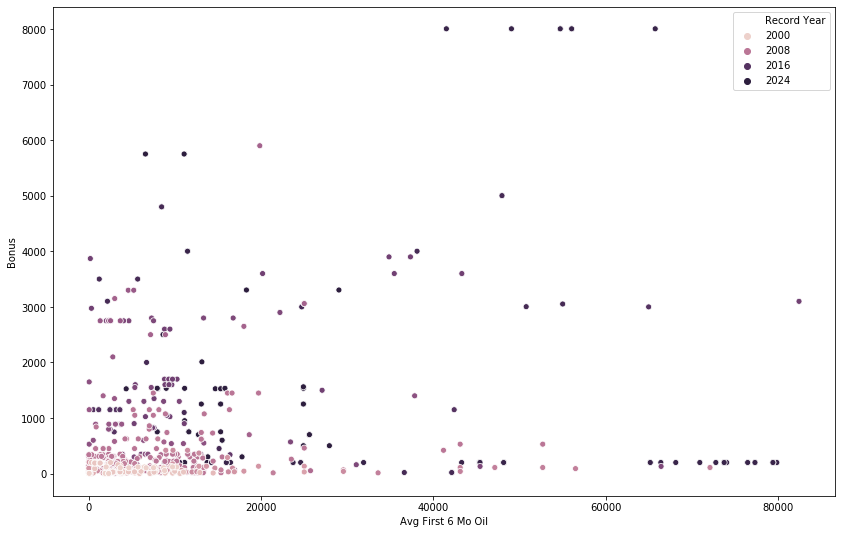

<Figure size 1008x648 with 0 Axes>

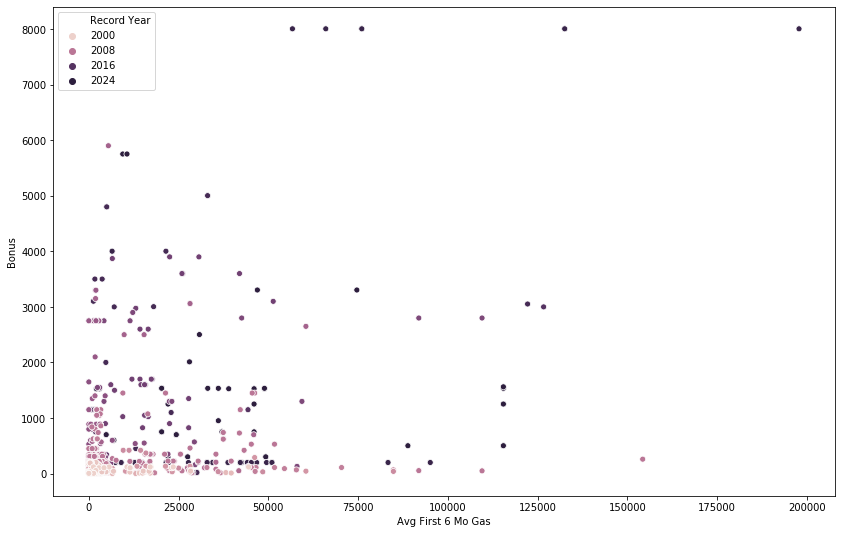

<Figure size 1008x648 with 0 Axes>

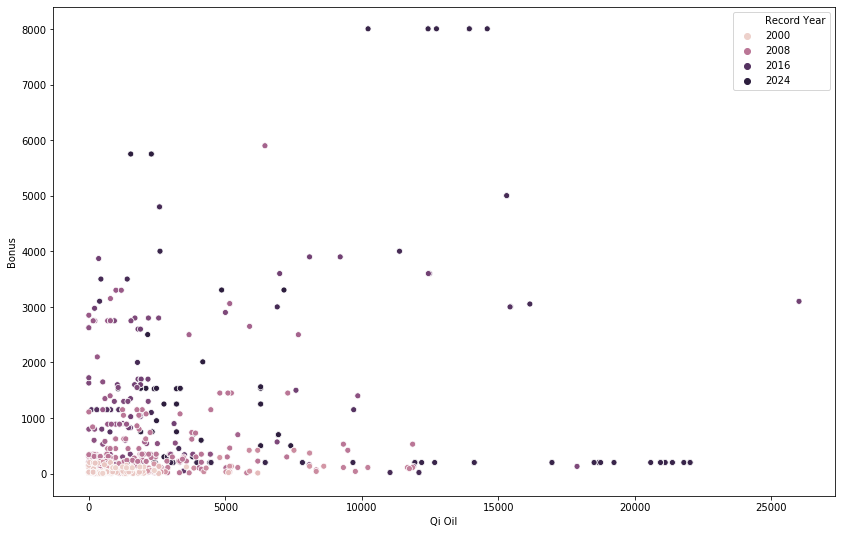

<Figure size 1008x648 with 0 Axes>

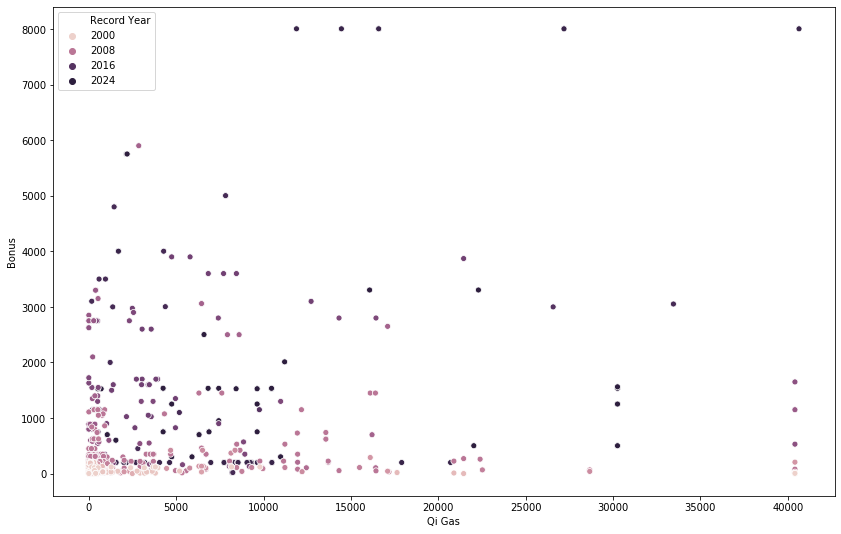

<Figure size 1008x648 with 0 Axes>

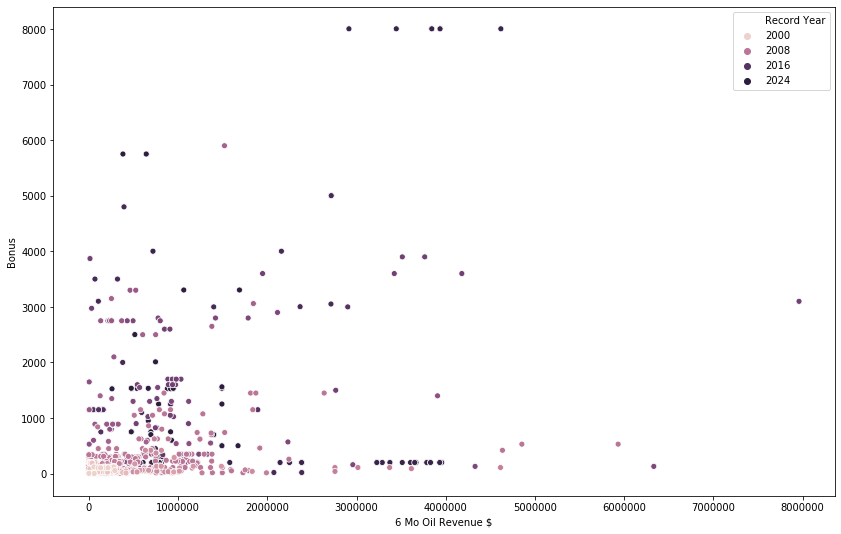

<Figure size 1008x648 with 0 Axes>

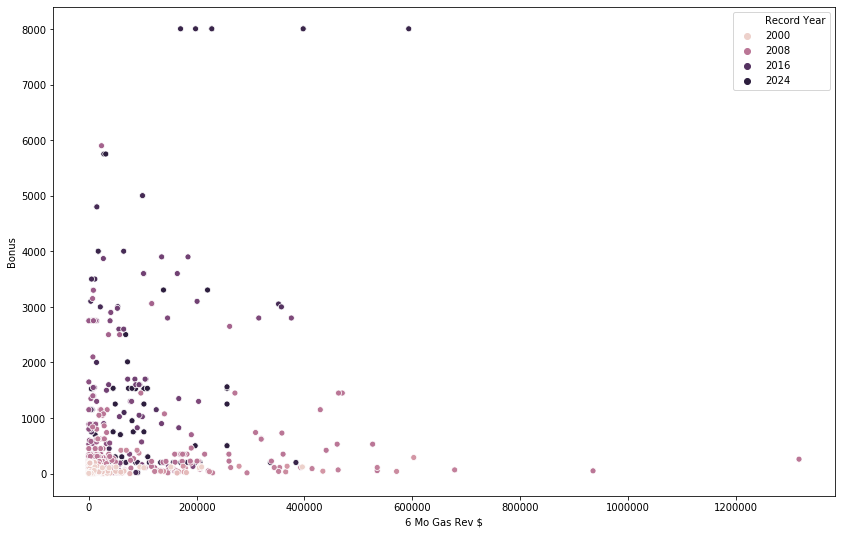

<Figure size 1008x648 with 0 Axes>

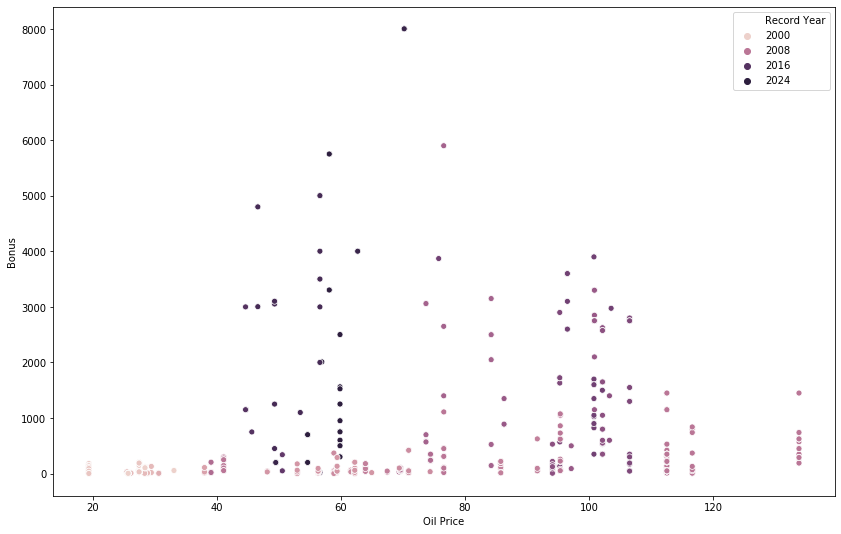

<Figure size 1008x648 with 0 Axes>

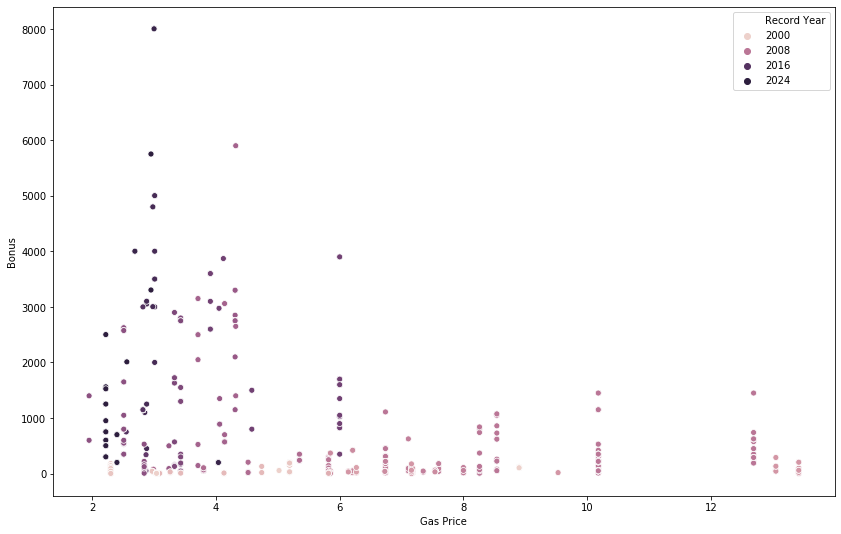

In [13]:
#Basically doing a pairplot for the features and the dependent/target variable (Bonus)
for col in learningCols:
    plt.figure(figsize = (14,9))
    sns.scatterplot(x = trainLeases[col], y = trainLeases["Bonus"], hue = trainLeases["Record Year"])
    plt.show()

we see that light colored dots do not correlate linearly with bonus price. This may tell us that the older data did not capture bonus price well and will hurt our model. Therefore, we will drop it bonus prices before 2008.

### Univariate Distributions on Each Predictor Feature

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits - Histogram')

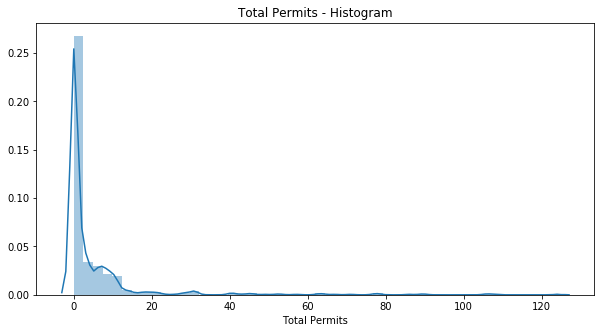

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells - Histogram')

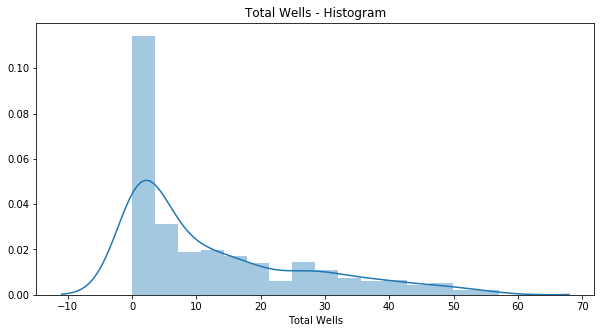

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil - Histogram')

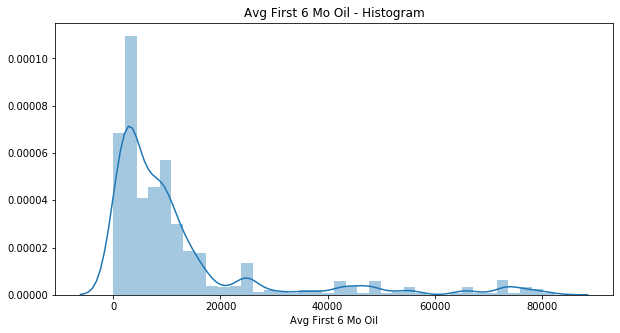

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas - Histogram')

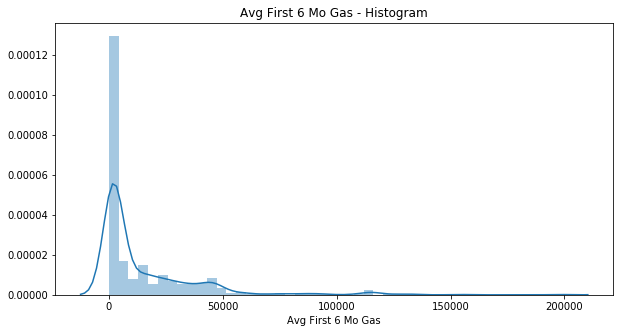

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil - Histogram')

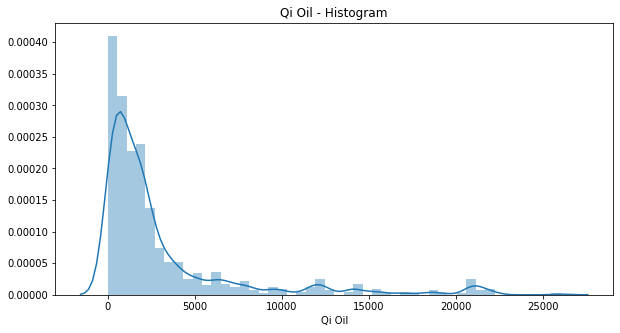

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas - Histogram')

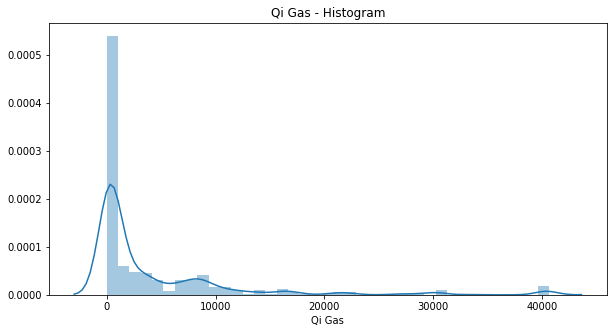

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ - Histogram')

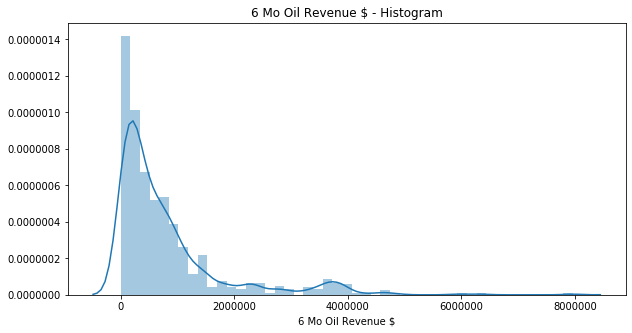

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ - Histogram')

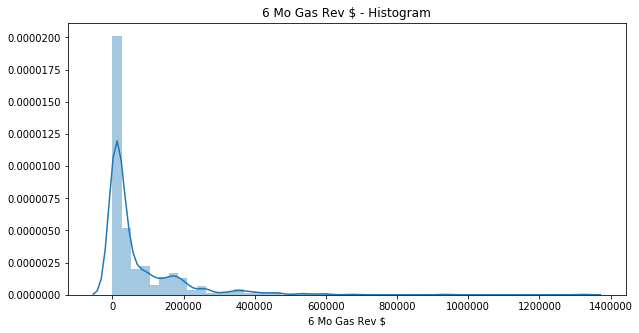

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price - Histogram')

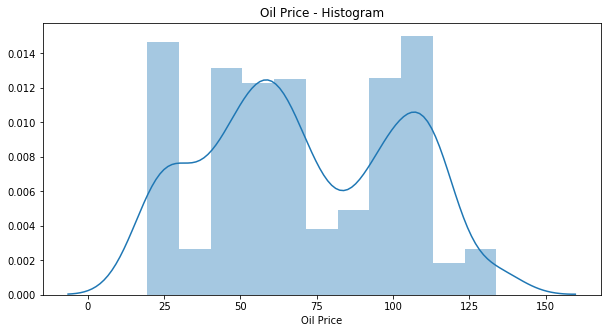

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price - Histogram')

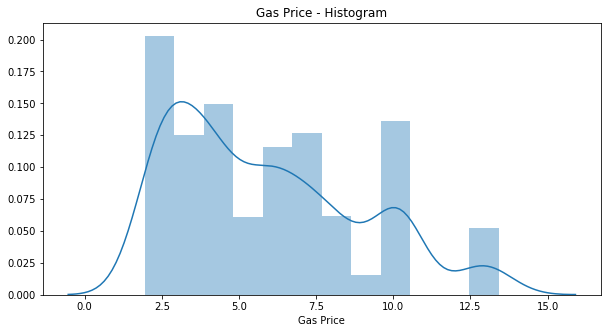

In [829]:
#looking at distributions of learning parameters
for col in learningCols:
    plt.figure(figsize = (10,5))
    sns.distplot(trainLeases[col].dropna())
    plt.title(col + " - Histogram")
    plt.show()

### Visualizing % Representing Each Year

In [830]:
#seeing what perecentage makes up the data by year in order to determine how much data we are losing by dropping older data
trainLeases["Record Year"].value_counts(normalize=True).sort_index(ascending=True)

2000    0.031927
2001    0.106043
2002    0.015964
2003    0.003421
2004    0.003421
2005    0.044470
2006    0.071836
2007    0.068415
2008    0.258837
2009    0.045610
2010    0.018244
2011    0.028506
2012    0.051311
2013    0.034208
2014    0.033067
2015    0.002281
2016    0.019384
2017    0.020525
2018    0.077537
2019    0.064994
Name: Record Year, dtype: float64

<Figure size 1440x720 with 0 Axes>

([<matplotlib.patches.Wedge at 0x1a736cb0f0>,
 [Text(-1.033198681391645, 0.7035627084848703, '2000'),
  Text(-1.2331493179402766, 0.2045550284481684, '2001'),
  Text(-1.2201677587962947, -0.27146020038677415, '2002'),
  Text(-1.2013849400648944, -0.34521620151040194, '2003'),
  Text(-1.193688218622569, -0.3709561115842115, '2004'),
  Text(-1.1246025590417401, -0.5456822190586476, '2005'),
  Text(-0.8553864344769856, -0.9114900151470392, '2006'),
  Text(-0.3849461064830525, -1.189250392097282, '2007'),
  Text(0.8195667943822419, -0.9438274575080003, '2008'),
  Text(1.2436675733257154, 0.1256621146492711, '2009'),
  Text(1.193688195830074, 0.37095618492747007, '2010'),
  Text(1.126550054022019, 0.5416502338068233, '2011'),
  Text(0.9569155908669236, 0.8042465741026237, '2012'),
  Text(0.7091041493257494, 1.0294033735174009, '2013'),
  Text(0.47737727339643116, 1.155253625332805, '2014'),
  Text(0.34641139340153193, 1.201040859638676, '2015'),
  Text(0.26392735138886514, 1.221819280085585

Text(0.5, 1.0, 'Percentage of Data in Train Leases by Record Year')

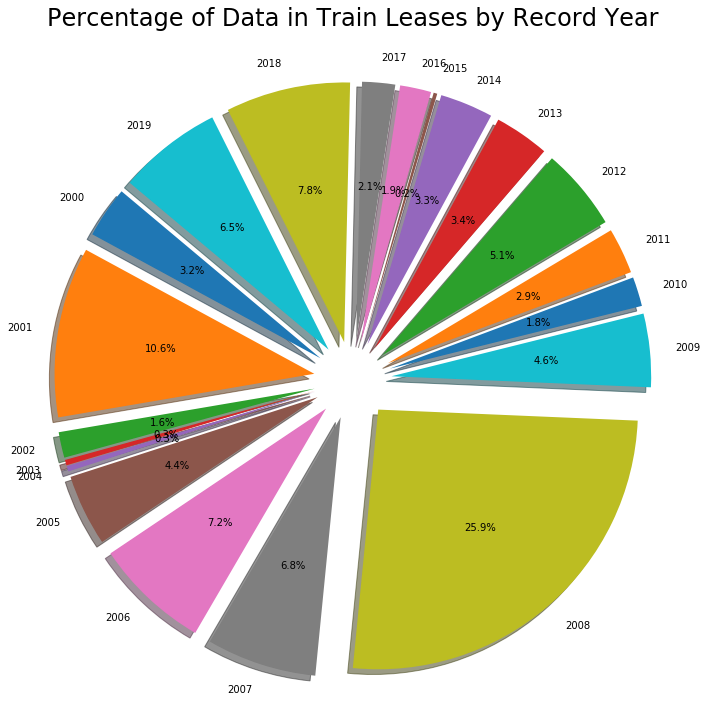

In [831]:
pielabels = trainLeases["Record Year"].value_counts(normalize=True).sort_index(ascending=True).index
separateSlices = np.ones(len(pielabels))*.15
plt.figure(figsize=(20,10))
plt.pie(trainLeases["Record Year"].value_counts().sort_index(ascending=True), explode=separateSlices, labels=pielabels, autopct='%1.1f%%', shadow=True, startangle=140)
plt.title("Percentage of Data in Train Leases by Record Year", size = 24, pad = 30.15)
plt.tight_layout()



### Statistical summary and correlation on training data

In [832]:
trainLeases[MLPredandResponseCols].describe().T

,count,mean,std,min,25%,50%,75%,max
Bonus,877.0,574.142531,1.119453e+03,1.00,45.000000,175.000000,502.000000,8.004000e+03
Total Permits,877.0,4.953250,1.305088e+01,0.00,0.000000,0.000000,5.000000,1.240000e+02
Total Wells,877.0,12.681870,1.406014e+01,0.00,2.000000,7.000000,20.000000,5.700000e+01
Avg First 6 Mo Oil,728.0,12233.081407,1.654634e+04,0.00,2934.222222,7087.555556,12706.000000,8.244600e+04
Avg First 6 Mo Gas,728.0,14960.141044,2.403980e+04,0.00,1715.000000,3621.500000,21388.916667,1.978497e+05
Qi Oil,752.0,3108.859605,4.504364e+03,0.00,650.000000,1590.000000,3132.132353,2.601000e+04
Qi Gas,752.0,4186.644980,7.587845e+03,0.00,230.000000,648.000000,5012.924710,4.064368e+04
6 Mo Oil Revenue $,728.0,807317.924529,1.018906e+06,0.00,176369.887500,460000.232558,949649.514677,7.959337e+06
6 Mo Gas Rev $,728.0,72771.292607,1.188171e+05,0.00,7564.168319,22687.826667,93001.712500,1.317707e+06
Oil Price,877.0,71.015576,3.158620e+01,19.39,49.520000,63.980000,100.900000,1.338800e+02


#### Pearson Correlation

In [14]:
#seeing how bonus correlates with the other variables
trainLeases[MLPredandResponseCols].corr()
PearsonCorr = trainLeases[MLPredandResponseCols].corr().iloc[:,0].sort_values(ascending = False)

,Bonus,Total Permits,Total Wells,Avg First 6 Mo Oil,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price
Bonus,1.000000,0.520152,0.217971,0.232796,0.359016,0.214482,0.225148,0.311128,0.159714,0.127339,-0.276308
Total Permits,0.520152,1.000000,0.225259,0.274472,0.408043,0.243952,0.242763,0.268723,0.159058,-0.055912,-0.222488
Total Wells,0.217971,0.225259,1.000000,0.152802,0.308820,0.147313,0.148268,0.129807,0.194420,-0.031209,-0.158125
Avg First 6 Mo Oil,0.232796,0.274472,0.152802,1.000000,0.649864,0.978520,0.364645,0.927851,0.533837,-0.141128,-0.223862
Avg First 6 Mo Gas,0.359016,0.408043,0.308820,0.649864,1.000000,0.597319,0.657938,0.646001,0.817183,-0.083125,-0.222803
Qi Oil,0.214482,0.243952,0.147313,0.978520,0.597319,1.000000,0.377478,0.896771,0.482429,-0.132582,-0.209496
Qi Gas,0.225148,0.242763,0.148268,0.364645,0.657938,0.377478,1.000000,0.353772,0.533151,-0.055267,-0.147296
6 Mo Oil Revenue $,0.311128,0.268723,0.129807,0.927851,0.646001,0.896771,0.353772,1.000000,0.590024,0.086221,-0.119409
6 Mo Gas Rev $,0.159714,0.159058,0.194420,0.533837,0.817183,0.482429,0.533151,0.590024,1.000000,0.028982,0.087014
Oil Price,0.127339,-0.055912,-0.031209,-0.141128,-0.083125,-0.132582,-0.055267,0.086221,0.028982,1.000000,0.518483


#### Spearman Correlation

In [16]:
trainLeases[MLPredandResponseCols].corr(method = "spearman")
SpearmanCorr = trainLeases[MLPredandResponseCols].corr(method = "spearman").iloc[:,0].sort_values(ascending=False)

,Bonus,Total Permits,Total Wells,Avg First 6 Mo Oil,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price
Bonus,1.000000,0.485974,0.395839,0.258122,0.287578,0.268085,0.281372,0.376300,0.218746,0.318337,-0.232622
Total Permits,0.485974,1.000000,0.529393,0.315009,0.256708,0.296514,0.255448,0.278336,0.142311,-0.096520,-0.397700
Total Wells,0.395839,0.529393,1.000000,0.487900,0.487378,0.496565,0.492940,0.416832,0.445887,-0.031444,-0.127102
Avg First 6 Mo Oil,0.258122,0.315009,0.487900,1.000000,0.857125,0.962857,0.720563,0.913666,0.802913,-0.093259,-0.239028
Avg First 6 Mo Gas,0.287578,0.256708,0.487378,0.857125,1.000000,0.822169,0.862537,0.781442,0.946777,-0.075631,-0.238898
Qi Oil,0.268085,0.296514,0.496565,0.962857,0.822169,1.000000,0.751857,0.889183,0.776870,-0.044488,-0.204181
Qi Gas,0.281372,0.255448,0.492940,0.720563,0.862537,0.751857,1.000000,0.639941,0.817271,-0.079755,-0.227774
6 Mo Oil Revenue $,0.376300,0.278336,0.416832,0.913666,0.781442,0.889183,0.639941,1.000000,0.783162,0.266354,-0.069109
6 Mo Gas Rev $,0.218746,0.142311,0.445887,0.802913,0.946777,0.776870,0.817271,0.783162,1.000000,0.058546,0.036750
Oil Price,0.318337,-0.096520,-0.031444,-0.093259,-0.075631,-0.044488,-0.079755,0.266354,0.058546,1.000000,0.500332


### Plotting Spearman vs Pearson Correlation

Text(0.5, 1.0, 'Pearson vs Spearman Correlation')

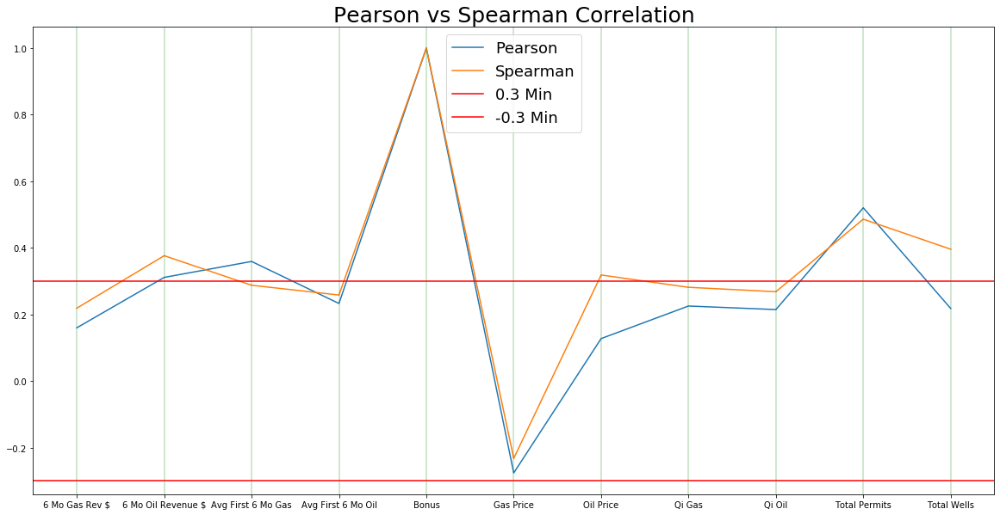

In [17]:
#Plotting spearman vs rank
fig, ax = plt.subplots(figsize = (20,10))
sns.lineplot(x=PearsonCorr.index, y=PearsonCorr.values, ax = ax, label = "Pearson")
sns.lineplot(x=SpearmanCorr.index, y=SpearmanCorr.values, ax = ax, label = "Spearman")
for i in SpearmanCorr.index:
    plt.axvline(i, color = 'green', alpha = .25)

plt.axhline(.3, color = 'r', label = "0.3 Min")
plt.axhline(-.3, color = 'r', label = "-0.3 Min")
ax.set_title("Pearson vs Spearman Correlation", size = 25)
plt.legend(prop={'size': 18})

### Univariate Distribution Response Feature

#### Log Transformation dude to high variance and magnitudes of response feature

In [836]:
#adding log bonus since bonus varies multiple magnitudes
trainLeases["Log Bonus"] = trainLeases["Bonus"].apply(lambda x: np.log(x))

Text(0.5, 1.0, 'Bonus - Histogram')

Text(0.5, 1.0, 'Log Bonus - Histogram')

Text(0.5, 1.025, 'Bonus Histogram vs. Log Bonus Historgram')

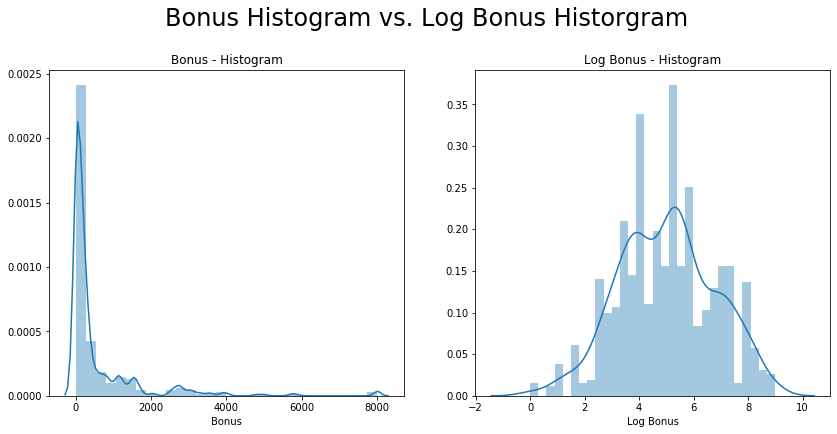

In [837]:
fig, ax = plt.subplots(1,2, figsize = (14,6))
sns.distplot(trainLeases["Bonus"], bins = round(math.sqrt(trainLeases.shape[0])), ax = ax[0])
ax[0].set_title("Bonus - Histogram")
sns.distplot(trainLeases["Log Bonus"],bins = round(math.sqrt(trainLeases.shape[0])),  ax = ax[1])
ax[1].set_title("Log Bonus - Histogram")
plt.suptitle("Bonus Histogram vs. Log Bonus Historgram", size = 24, y = 1.025)

<Figure size 1080x504 with 0 Axes>

Text(0.5, 1.0, 'Bonus Distribution - Under $10/acre')

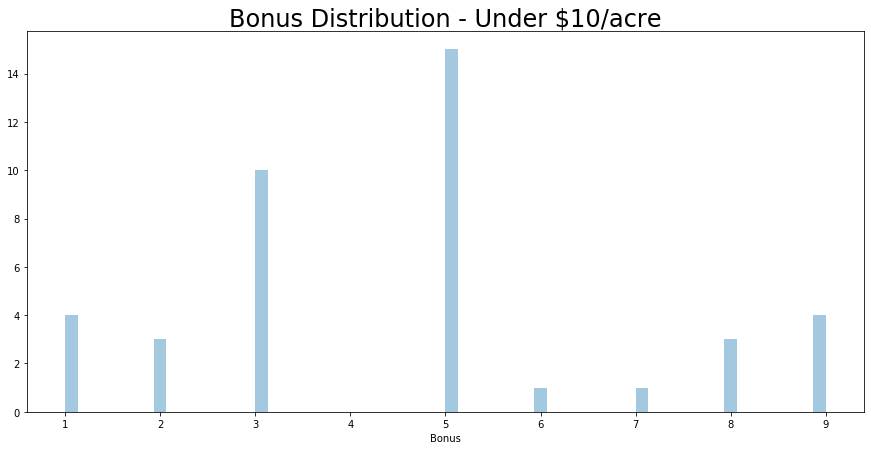

In [838]:
plt.figure(figsize=(15,7))
sns.distplot(trainLeases[trainLeases["Bonus"]<10]["Bonus"], kde = False, bins = 60)
plt.title("Bonus Distribution - Under $10/acre", size = 24)

### Evaluating records with null values for learning parameters but have bonus price

In [839]:
#seeing which columns have null values - this could be because there are 0 wells in the area
null_columns=trainLeases.columns[trainLeases.isnull().any()]
trainLeases[null_columns].isnull().sum()

Record Number          22
Avg First 6 Mo Oil    149
Avg First 6 Mo Gas    149
Qi Oil                125
Qi Gas                125
6 Mo Oil Revenue $    149
6 Mo Gas Rev $        149
dtype: int64

### Evaluating Leases Where There Are Null values for Training Parameters
* seeing how bonus price varies amongst these leases

,Record Date,Record Number,Bonus,Section,Township,Range,geometry,buffers,Total Permits,Total Wells,Avg First 6 Mo Oil,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price,TWSHP,Record Year,Log Bonus
LeaseIndex,,,,,,,,,,,,,,,,,,,,,
1860,2017-03-15,17-00125,1251,36,39,71,POINT (473223.5907844503 4795560.923584733),"POLYGON ((478051.6107844503 4795560.923584733,...",0,0,NaN,NaN,NaN,NaN,NaN,NaN,49.33,2.88,39 71,2017,7.131699
2591,2013-02-05,WYW181745,1630,32,40,71,POINT (466723.6842779313 4805227.444659821),"POLYGON ((471551.7042779313 4805227.444659821,...",3,1,NaN,NaN,0.0,0.0,NaN,NaN,95.31,3.33,40 71,2013,7.396335
2592,2013-02-05,WYW181746,1725,18,40,71,POINT (465200.2967852092 4810069.510457724),"POLYGON ((470028.3167852092 4810069.510457724,...",19,0,NaN,NaN,NaN,NaN,NaN,NaN,95.31,3.33,40 71,2013,7.452982
2595,2013-02-05,WYW181741,145,31,39,70,POINT (474830.4435929903 4795562.819023024),"POLYGON ((479658.4635929904 4795562.819023024,...",1,0,NaN,NaN,NaN,NaN,NaN,NaN,95.31,3.33,39 70,2013,4.976734
2597,2013-02-05,WYW181746,1725,19,40,71,POINT (465169.1298659299 4808456.788102142),"POLYGON ((469997.1498659299 4808456.788102142,...",21,1,NaN,NaN,0.0,0.0,NaN,NaN,95.31,3.33,40 71,2013,7.452982
2630,2012-08-07,WYW181148,125,15,40,71,POINT (469997.0597891273 4810088.025606179),"POLYGON ((474825.0797891273 4810088.025606179,...",0,0,NaN,NaN,NaN,NaN,NaN,NaN,94.13,2.84,40 71,2012,4.828314
2693,2012-02-07,WYW180598,530,10,38,71,POINT (470033.973677149 4792330.381622692),"POLYGON ((474861.9936771491 4792330.381622692,...",1,0,NaN,NaN,NaN,NaN,NaN,NaN,102.20,2.51,38 71,2012,6.272877
2694,2012-02-07,WYW180599,1050,4,39,71,POINT (468346.6853995129 4803621.196483256),"POLYGON ((473174.705399513 4803621.196483256, ...",0,0,NaN,NaN,NaN,NaN,NaN,NaN,102.20,2.51,39 71,2012,6.956545
2696,2012-02-07,WYW180603,2625,21,40,71,POINT (468351.4245272543 4808456.812601002),"POLYGON ((473179.4445272543 4808456.812601002,...",2,0,NaN,NaN,NaN,NaN,NaN,NaN,102.20,2.51,40 71,2012,7.872836


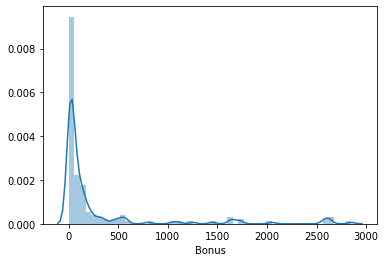

In [840]:
#looking how bonus varies with leases that have null values
trainLeases[trainLeases.isnull().any(axis=1)]
sns.distplot(trainLeases[trainLeases.isnull().any(axis=1)]["Bonus"])

 * ***We see that there are a few cases that bonuses are high and there are no wells or permits to justify this.  This will confuse and cause outliars in our model, so we will remove them***

In [841]:
#creating dataframe holding leases with negligible permits 1 or 0 wells with null revenue to see how bonus varies
zeroPermandProd = trainLeases[(trainLeases["Total Permits"]<2) & (trainLeases["Total Wells"] < 2)]
zeroPermandProd = zeroPermandProd[zeroPermandProd.isnull().any(axis =1)]
zeroPermandProd

,Record Date,Record Number,Bonus,Section,Township,Range,geometry,buffers,Total Permits,Total Wells,Avg First 6 Mo Oil,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price,TWSHP,Record Year,Log Bonus
LeaseIndex,,,,,,,,,,,,,,,,,,,,,
1860,2017-03-15,17-00125,1251,36,39,71,POINT (473223.5907844503 4795560.923584733),"POLYGON ((478051.6107844503 4795560.923584733,...",0,0,NaN,NaN,NaN,NaN,NaN,NaN,49.33,2.88,39 71,2017,7.131699
2595,2013-02-05,WYW181741,145,31,39,70,POINT (474830.4435929903 4795562.819023024),"POLYGON ((479658.4635929904 4795562.819023024,...",1,0,NaN,NaN,NaN,NaN,NaN,NaN,95.31,3.33,39 70,2013,4.976734
2630,2012-08-07,WYW181148,125,15,40,71,POINT (469997.0597891273 4810088.025606179),"POLYGON ((474825.0797891273 4810088.025606179,...",0,0,NaN,NaN,NaN,NaN,NaN,NaN,94.13,2.84,40 71,2012,4.828314
2693,2012-02-07,WYW180598,530,10,38,71,POINT (470033.973677149 4792330.381622692),"POLYGON ((474861.9936771491 4792330.381622692,...",1,0,NaN,NaN,NaN,NaN,NaN,NaN,102.20,2.51,38 71,2012,6.272877
2694,2012-02-07,WYW180599,1050,4,39,71,POINT (468346.6853995129 4803621.196483256),"POLYGON ((473174.705399513 4803621.196483256, ...",0,0,NaN,NaN,NaN,NaN,NaN,NaN,102.20,2.51,39 71,2012,6.956545
2713,2012-02-07,WYW180604,1650,22,40,71,POINT (469958.4263089846 4808482.525865316),"POLYGON ((474786.4463089846 4808482.525865316,...",0,0,NaN,NaN,NaN,NaN,NaN,NaN,102.20,2.51,40 71,2012,7.408531
2714,2012-02-07,WYW180604,1650,27,40,71,POINT (469958.1029365089 4806882.791275876),"POLYGON ((474786.1229365089 4806882.791275876,...",0,0,NaN,NaN,NaN,NaN,NaN,NaN,102.20,2.51,40 71,2012,7.408531
2715,2012-02-07,WYW180606,2575,28,40,71,POINT (468354.3689319888 4806844.773815393),"POLYGON ((473182.3889319888 4806844.773815393,...",0,0,NaN,NaN,NaN,NaN,NaN,NaN,102.20,2.51,40 71,2012,7.853605
2716,2012-02-07,WYW180606,2575,33,40,71,POINT (468341.9063089573 4805239.590405175),"POLYGON ((473169.9263089573 4805239.590405175,...",0,0,NaN,NaN,NaN,NaN,NaN,NaN,102.20,2.51,40 71,2012,7.853605


<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Bonus Distribution For Leases With Null Training Parameters (Oil Revenue, Wells, Etc)')

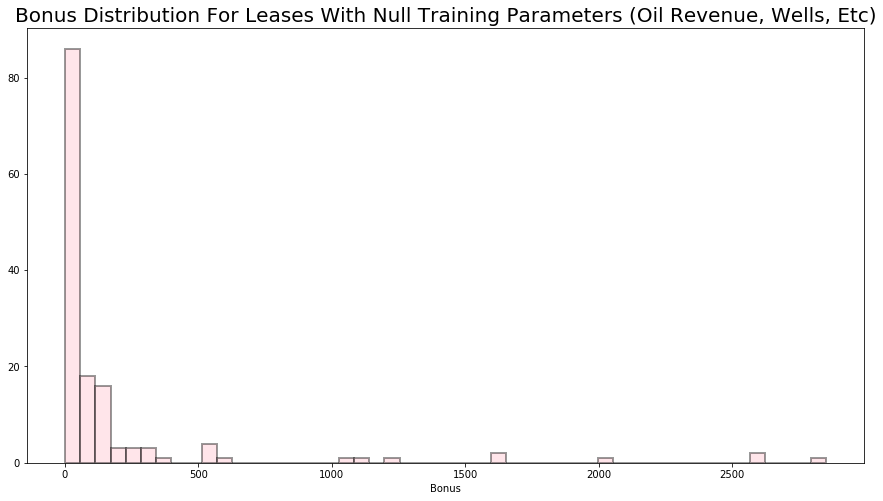

In [842]:
#creating a historgram of bonus prices wehn there are less than 2 permits or wells in area
plt.figure(figsize = (15,8))
sns.distplot(zeroPermandProd["Bonus"], kde = False, color ='pink', hist_kws=dict(edgecolor = 'k', linewidth=2))
plt.title("Bonus Distribution for Leases with null training parameters (oil revenue, wells, etc)".title(), size = 20)


#### Removing outliars from dataset

In [843]:
#obtaining the bonus price at the given quantile
quantile1 = zeroPermandProd["Bonus"].quantile(.80)
quantile1


150.0

In [844]:
#getting leases that are outliars based on high bonus prices where there is no data to support the high
zeroPermandProd[zeroPermandProd["Bonus"]>quantile1].count()
indexToDrop = zeroPermandProd[zeroPermandProd["Bonus"]>quantile1].index

Record Date           24
Record Number         23
Bonus                 24
Section               24
Township              24
Range                 24
geometry              24
buffers               24
Total Permits         24
Total Wells           24
Avg First 6 Mo Oil     0
Avg First 6 Mo Gas     0
Qi Oil                 4
Qi Gas                 4
6 Mo Oil Revenue $     0
6 Mo Gas Rev $         0
Oil Price             24
Gas Price             24
TWSHP                 24
Record Year           24
Log Bonus             24
dtype: int64

In [845]:
#dropping leases that could appear problematic based on EDA above
cleanedLeases = trainLeases.drop(index=indexToDrop)
cleanedLeases= trainLeases.dropna()

cleanedLeases = cleanedLeases.loc[cleanedLeases["Record Year"]>2007]

### Checking training data after cleaning data 




In [846]:
#unclean leases stat summary
trainLeases.describe()

#clean leases summary
cleanedLeases.describe()
cleanedLeases.isnull().any(axis=1).value_counts()

,Bonus,Section,Township,Range,Total Permits,Total Wells,Avg First 6 Mo Oil,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price,Record Year,Log Bonus
count,877.000000,877.000000,877.000000,877.000000,877.000000,877.000000,728.000000,728.000000,752.000000,752.000000,7.280000e+02,7.280000e+02,877.000000,877.000000,877.000000,877.000000
mean,574.142531,19.392246,38.291904,71.834664,4.953250,12.681870,12233.081407,14960.141044,3108.859605,4186.644980,8.073179e+05,7.277129e+04,71.015576,5.890046,2009.118586,5.011540
std,1119.452950,10.551086,1.075502,1.052843,13.050879,14.060138,16546.340344,24039.800775,4504.364424,7587.844808,1.018906e+06,1.188171e+05,31.586204,3.034515,5.419151,1.744290
min,1.000000,1.000000,37.000000,70.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,19.390000,1.950000,2000.000000,0.000000
25%,45.000000,11.000000,37.000000,71.000000,0.000000,2.000000,2934.222222,1715.000000,650.000000,230.000000,1.763699e+05,7.564168e+03,49.520000,3.260000,2006.000000,3.806662
50%,175.000000,20.000000,38.000000,72.000000,0.000000,7.000000,7087.555556,3621.500000,1590.000000,648.000000,4.600002e+05,2.268783e+04,63.980000,5.190000,2008.000000,5.164786
75%,502.000000,29.000000,39.000000,73.000000,5.000000,20.000000,12706.000000,21388.916667,3132.132353,5012.924710,9.496495e+05,9.300171e+04,100.900000,8.000000,2013.000000,6.218600
max,8004.000000,36.000000,40.000000,74.000000,124.000000,57.000000,82446.000000,197849.722222,26010.000000,40643.684211,7.959337e+06,1.317707e+06,133.880000,13.420000,2019.000000,8.987697


,Bonus,Section,Township,Range,Total Permits,Total Wells,Avg First 6 Mo Oil,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price,Record Year,Log Bonus
count,484.000000,484.000000,484.000000,484.000000,484.000000,484.000000,484.000000,484.000000,484.000000,484.000000,4.840000e+02,4.840000e+02,484.000000,484.000000,484.000000,484.000000
mean,909.254132,18.280992,38.154959,72.024793,7.012397,17.721074,14724.151944,18298.165023,3914.631214,4918.525056,1.013048e+06,7.931435e+04,82.563554,5.668967,2012.458678,5.889492
std,1374.880354,10.562815,1.078088,1.019177,14.303131,15.057608,18731.206323,27059.953711,5196.940369,7848.808298,1.117732e+06,1.205738e+05,28.436637,3.178930,4.350144,1.458685
min,7.000000,1.000000,37.000000,70.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,39.090000,1.950000,2008.000000,1.945910
25%,200.000000,9.000000,37.000000,71.000000,0.000000,3.000000,3089.500000,1913.119048,825.000000,335.772727,2.804290e+05,9.089965e+03,54.660000,3.000000,2008.000000,5.298317
50%,340.000000,18.000000,38.000000,72.000000,3.000000,14.000000,8448.062500,4673.987778,1899.230769,1322.500000,6.691757e+05,3.134103e+04,94.130000,4.060000,2012.000000,5.828946
75%,1150.000000,28.000000,39.000000,73.000000,8.000000,28.000000,15299.416667,27535.870968,3955.384615,7433.863636,1.196285e+06,1.086188e+05,112.580000,8.540000,2018.000000,7.047517
max,8004.000000,36.000000,40.000000,74.000000,124.000000,57.000000,82446.000000,197849.722222,26010.000000,40643.684211,7.959337e+06,1.317707e+06,133.880000,12.690000,2019.000000,8.987697


False    484
dtype: int64

<h5>
* *we lose about 50% of the training data which is not ideal - but our simple linear regression model will suffer without removing outliars*
</h5>

## Looking at correlation plots after cleaning data

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs Bonus')

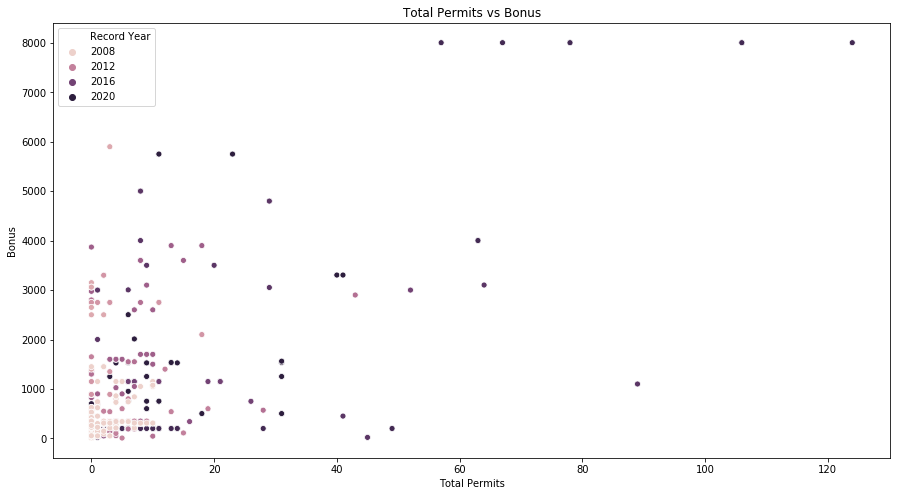

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs Bonus')

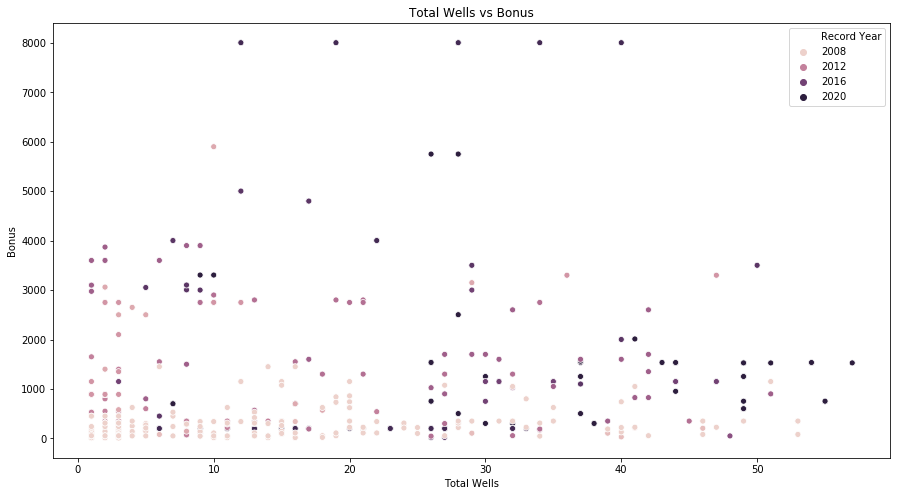

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs Bonus')

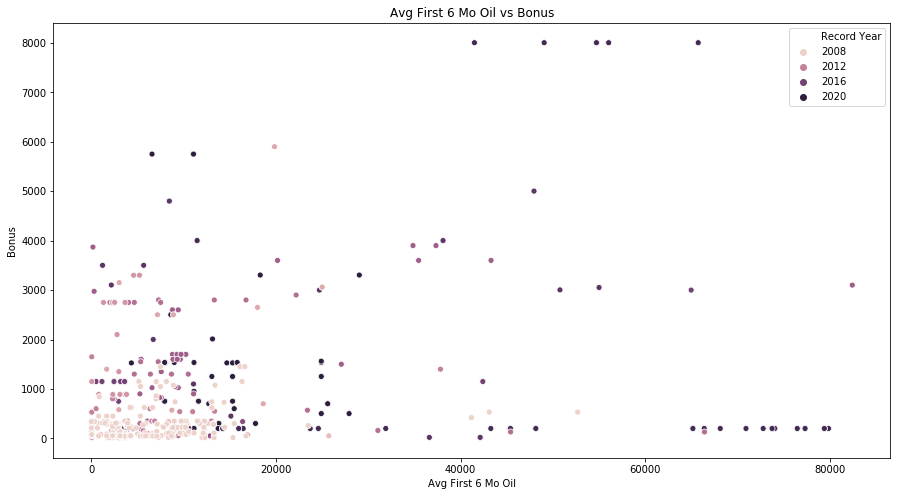

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs Bonus')

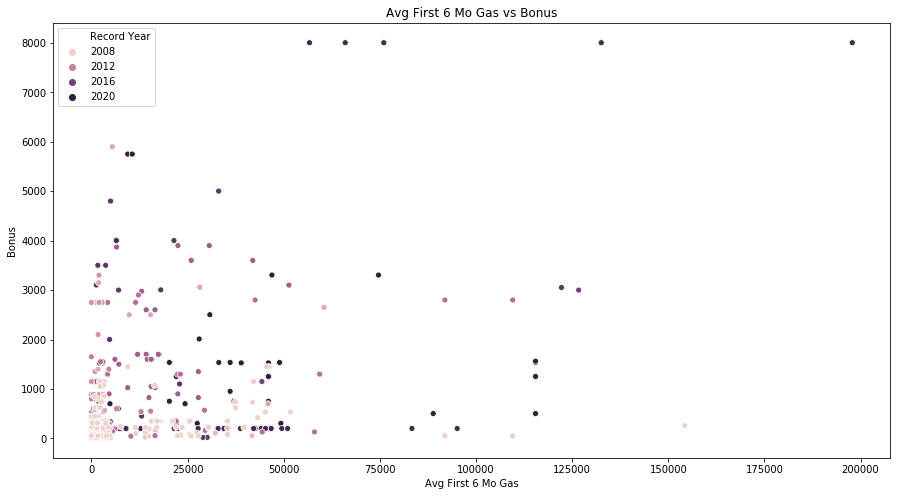

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs Bonus')

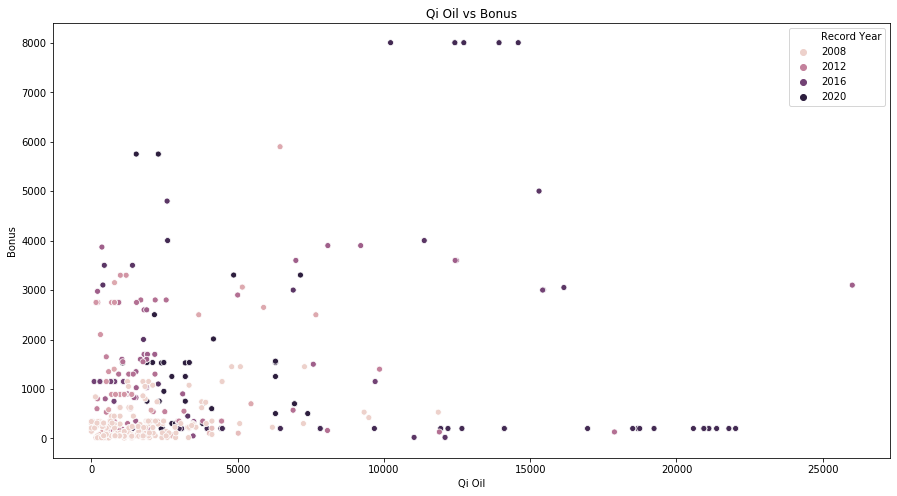

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs Bonus')

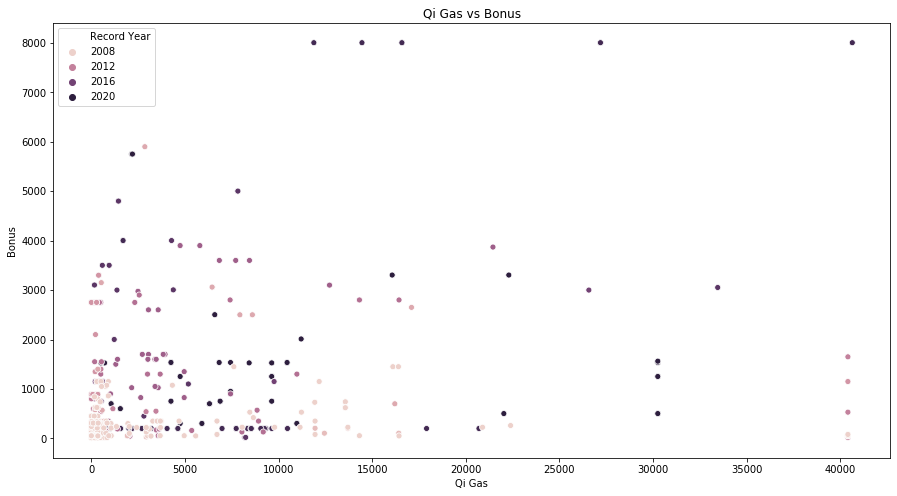

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs Bonus')

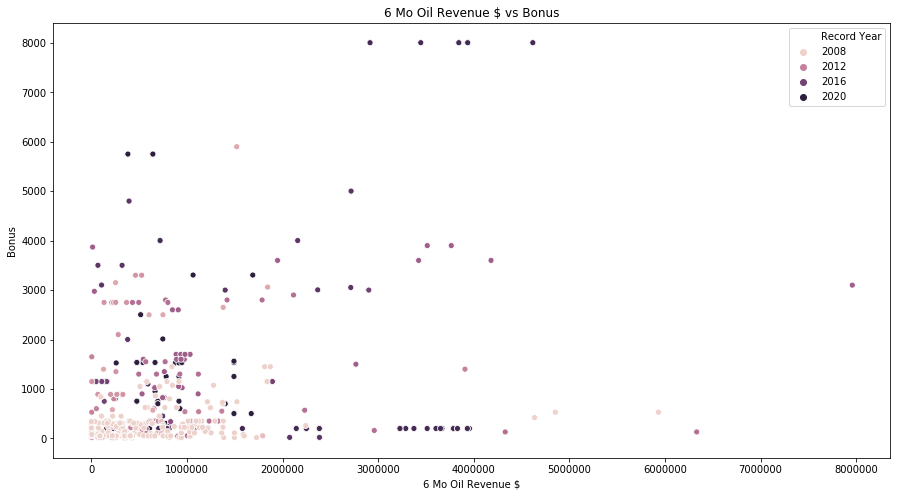

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs Bonus')

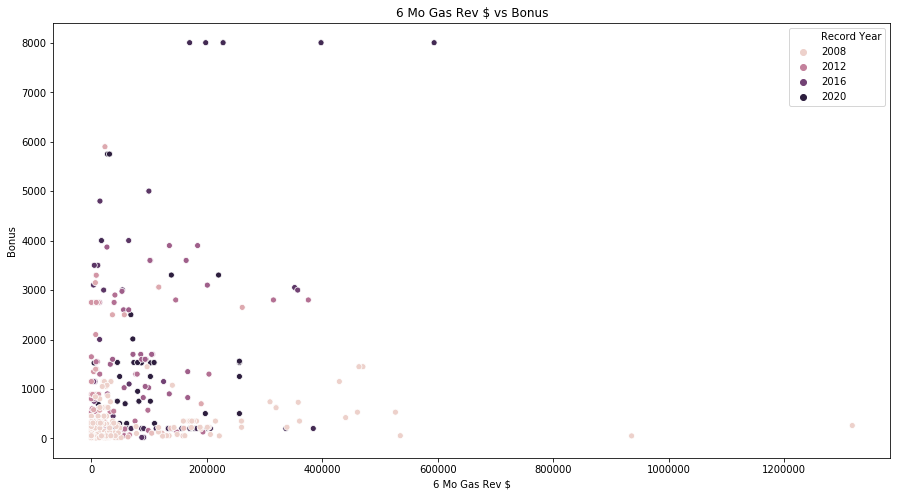

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs Bonus')

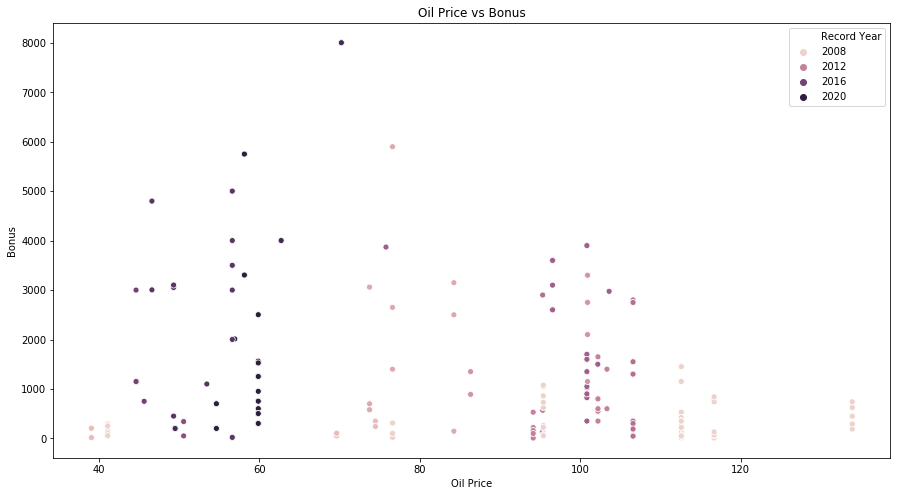

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs Bonus')

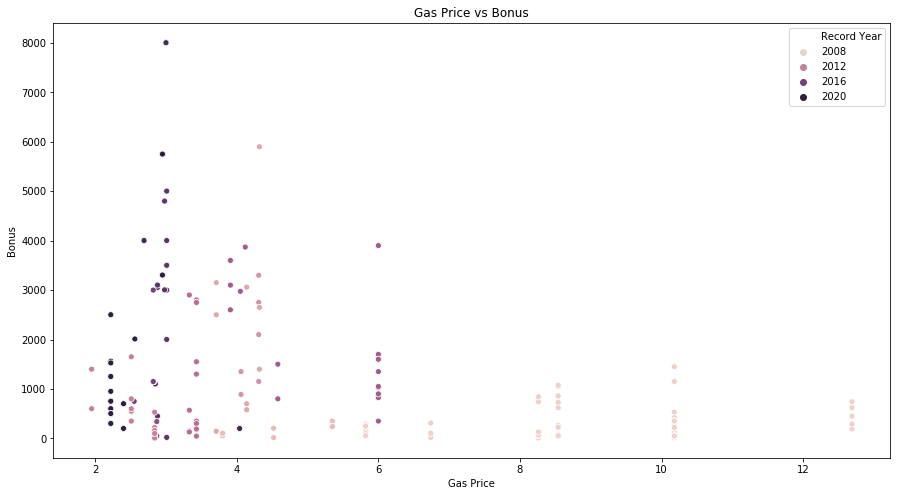

In [847]:
for col in learningCols:
    plt.figure(figsize = (15,8))
    plt.title(col + ' vs Bonus' )
    sns.scatterplot(x = cleanedLeases[col], y = cleanedLeases["Bonus"], hue = cleanedLeases["Record Year"])
    plt.show()

* We see that leases with less than 500 dollar bonus but high 6 mo oil revenue does not seem accurate
* Need to break down this data to see what type of data this is and to potentially clean it further

### Drilling Down on Potential Outliar Data

In [848]:
#getting dataframe of outliaars based on markdown comments above
outliars = cleanedLeases.loc[(cleanedLeases["6 Mo Oil Revenue $"]>2000000) & (cleanedLeases["Bonus"] < 1000)]

<Figure size 1080x720 with 0 Axes>

Text(0.5, 1.0, 'ScatterPlot - Oil Revenue vs Bonus - Outliar Line')

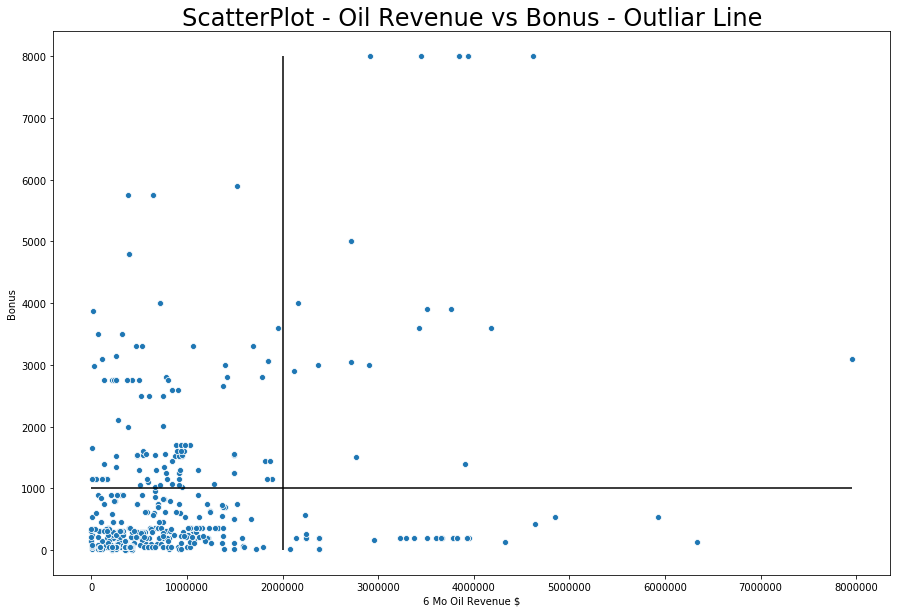

In [854]:
plt.figure(figsize = (15,10))
sns.scatterplot(cleanedLeases["6 Mo Oil Revenue $"], cleanedLeases["Bonus"])
plt.vlines(2000000, ymin = 0, ymax=cleanedLeases["Bonus"].max())
plt.hlines(1000, xmin = 0, xmax = cleanedLeases["6 Mo Oil Revenue $"].max())
plt.title("ScatterPlot - Oil Revenue vs Bonus - Outliar Line", size = 24)

* Bottom right rectangle shows outliars of low bonuses when oil revenue is high

In [850]:
len(outliars)

#filtering the full dataframe containing all prod around training lease to those only belonging to the outliar leases
outLiarTrainingProd = DFtrainProdFilter.loc[DFtrainProdFilter.index.isin(outliars.index)]


47

<Figure size 1080x720 with 0 Axes>

Text(0.5, 1.0, 'Scatterplot of Oil Production with abnormal low bonus price')

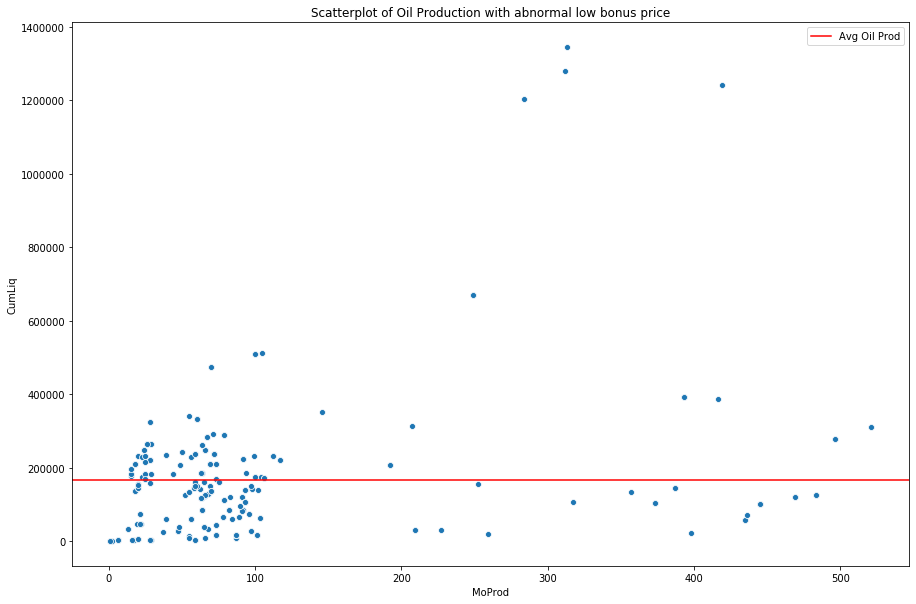

In [601]:
#creating scatterplot of outliar bonuses - showing production vs month prod to see if there are any...
#wells that would lead to low bonus prics
plt.figure(figsize=(15,10))
sns.scatterplot(outLiarTrainingProd["MoProd"], outLiarTrainingProd["CumLiq"])
plt.title("Scatterplot of Oil Production with abnormal low bonus price")
plt.axhline(outLiarTrainingProd["CumLiq"].mean(), color= 'r', label = "Avg Oil Prod")
plt.legend()

* plot shows that low bonus prices from outliars are indeed erraneous data - wells have good average cumulative oil

<Figure size 1080x504 with 0 Axes>

<Figure size 1080x504 with 0 Axes>

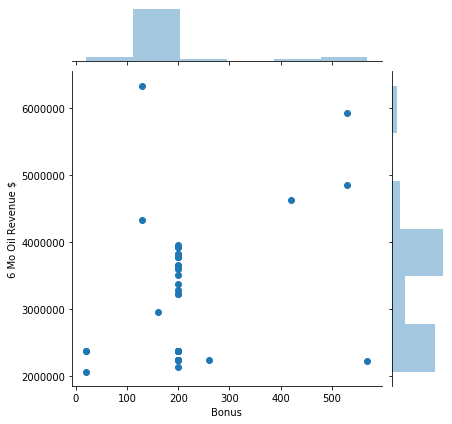

In [602]:
#plot to see how bonuses are distributed a month the outliar 
plt.figure(figsize = (15,7))
sns.jointplot(outliars["Bonus"], outliars["6 Mo Oil Revenue $"])

### Dropping Outliar Production and Regenerating Pairplots

In [603]:
#dropping outliars from cleanedLeases for further cleaning
cleanedLeases.drop(outliars.index, inplace = True)

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs Bonus')

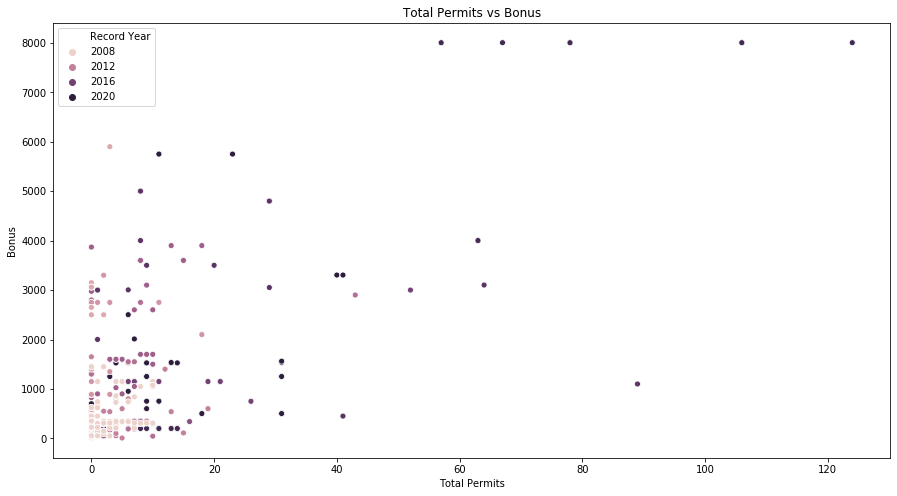

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs Bonus')

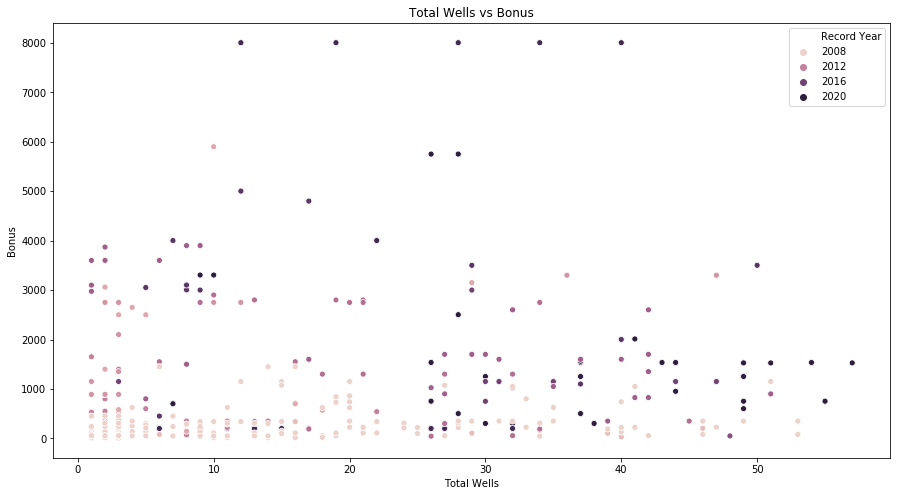

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs Bonus')

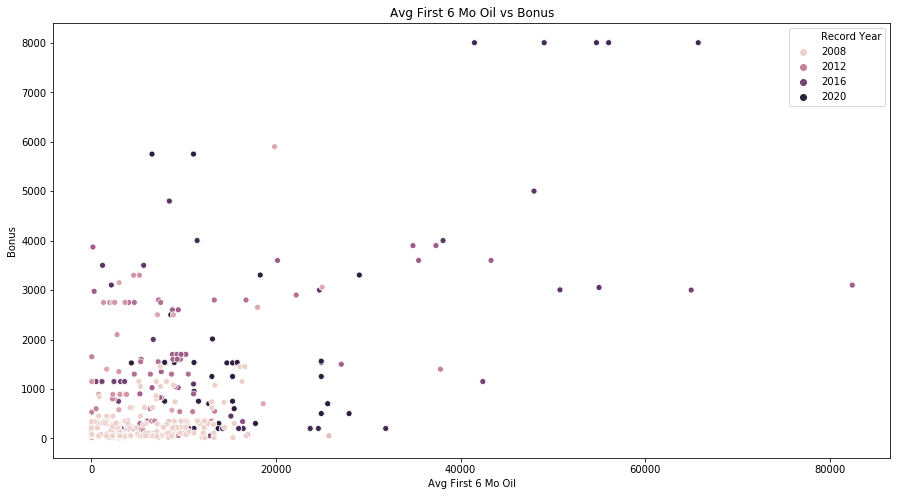

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs Bonus')

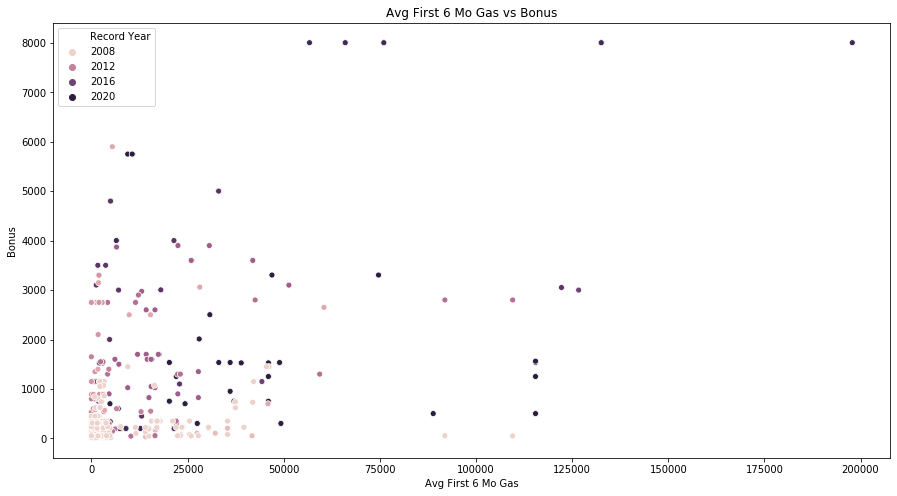

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs Bonus')

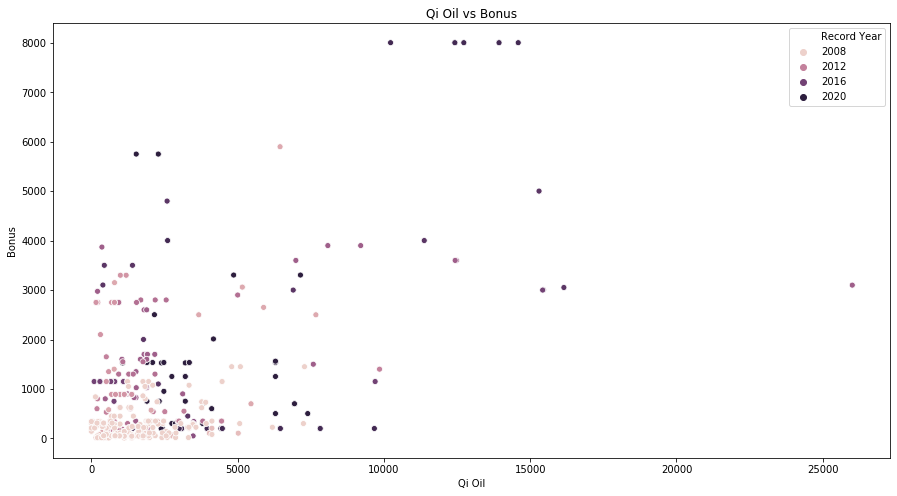

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs Bonus')

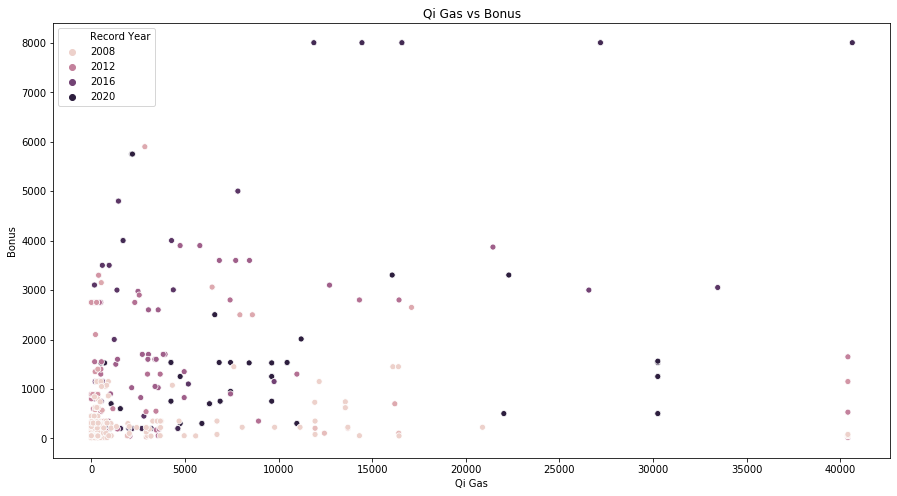

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs Bonus')

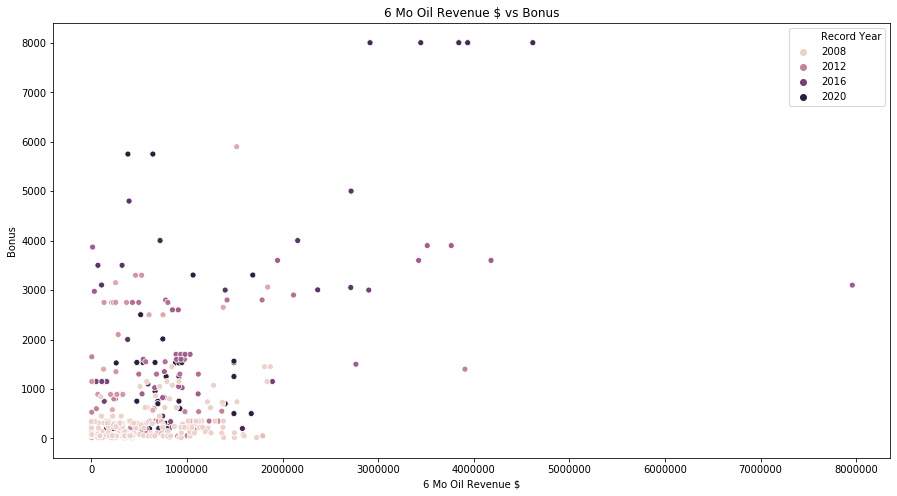

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs Bonus')

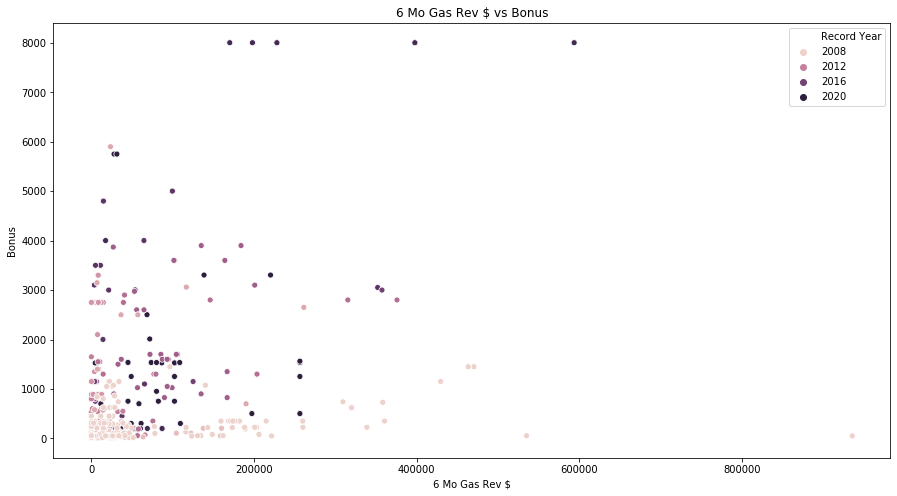

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs Bonus')

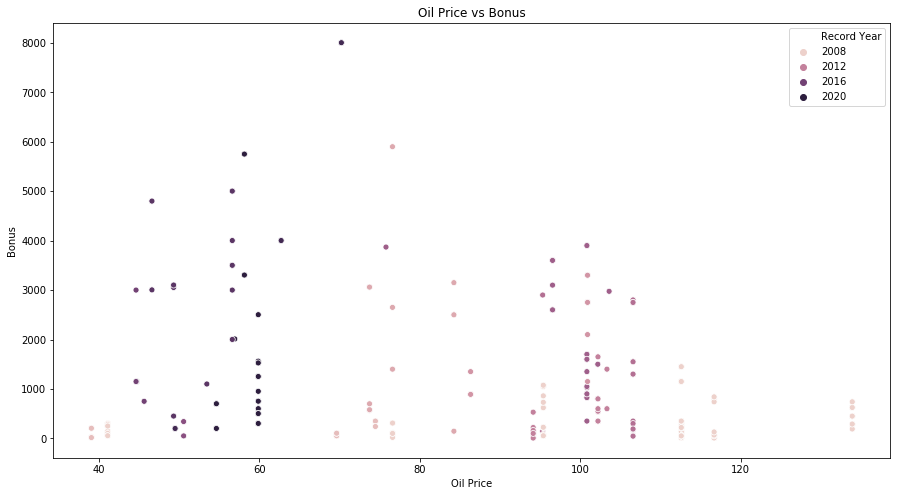

<Figure size 1080x576 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs Bonus')

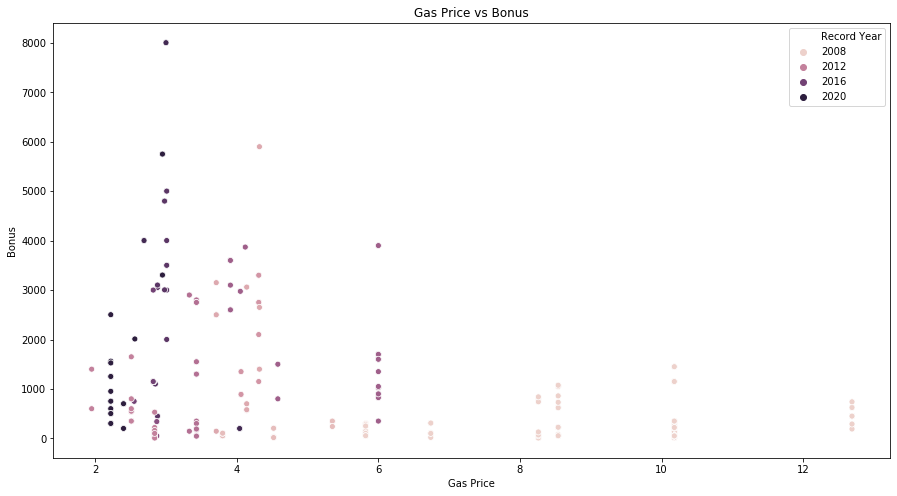

In [650]:
for col in learningCols:
    plt.figure(figsize = (15,8))
    plt.title(col + ' vs Bonus' )
    sns.scatterplot(x = cleanedLeases[col], y = cleanedLeases["Bonus"], hue = cleanedLeases["Record Year"])
    plt.show()

### Pairplot Plots

In [859]:
cleanedLeases[MLPredandResponseCols].shape

(484, 11)

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Bonus vs Bonus')

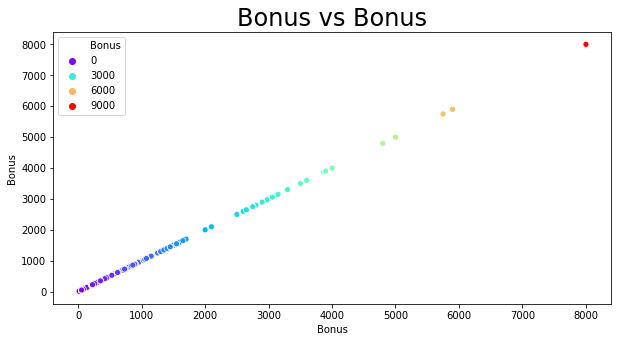

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Bonus vs Total Permits')

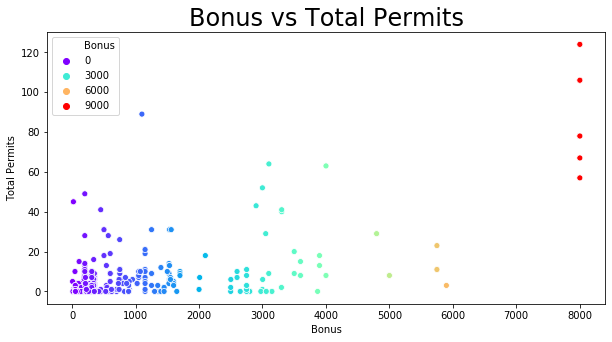

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Bonus vs Total Wells')

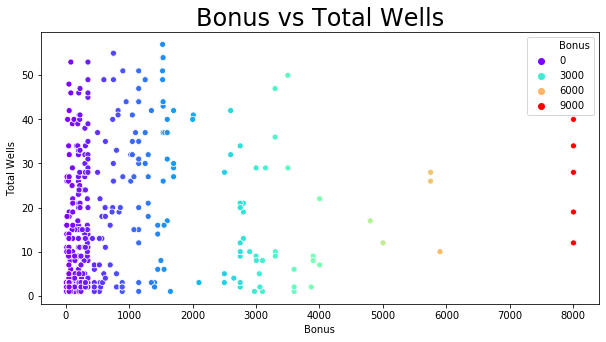

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Bonus vs Avg First 6 Mo Oil')

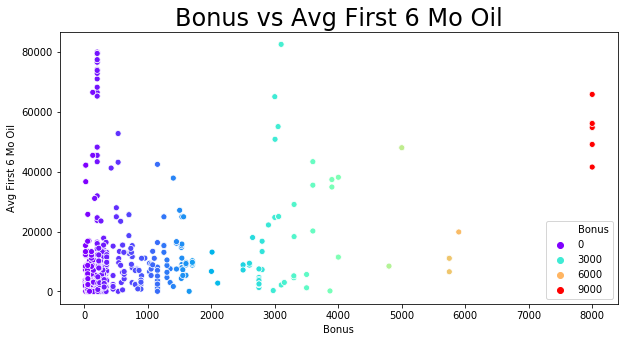

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Bonus vs Avg First 6 Mo Gas')

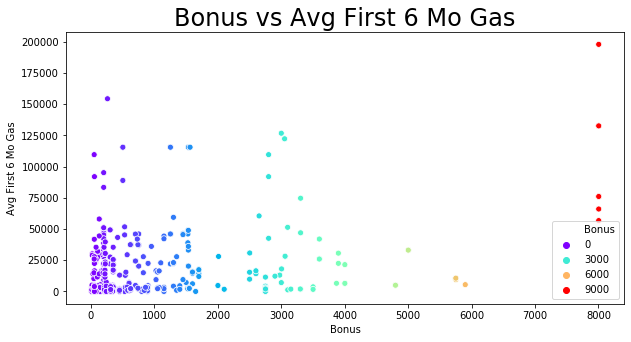

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Bonus vs Qi Oil')

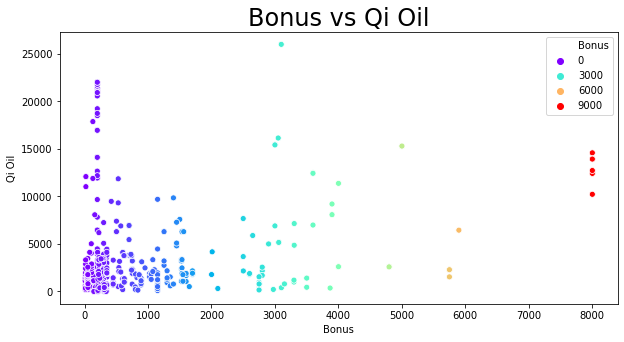

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Bonus vs Qi Gas')

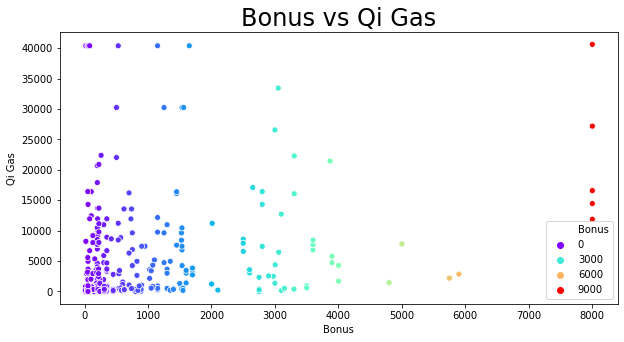

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Bonus vs 6 Mo Oil Revenue $')

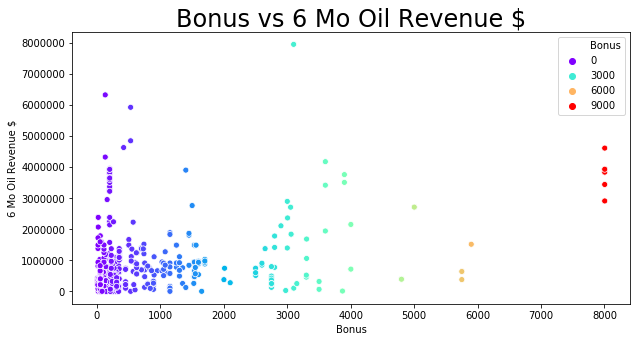

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Bonus vs 6 Mo Gas Rev $')

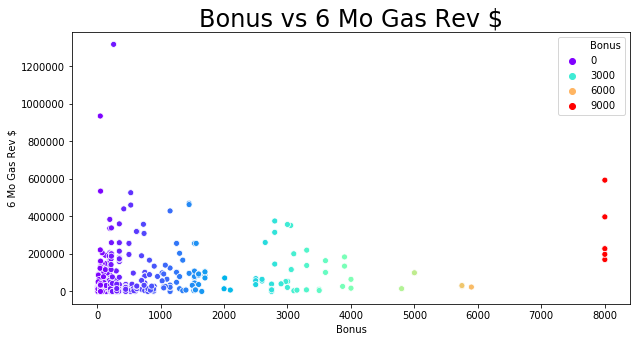

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Bonus vs Oil Price')

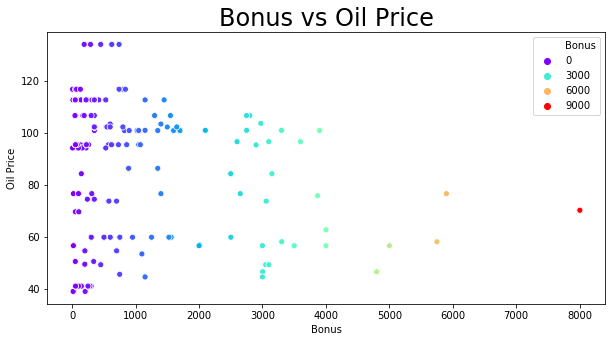

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Bonus vs Gas Price')

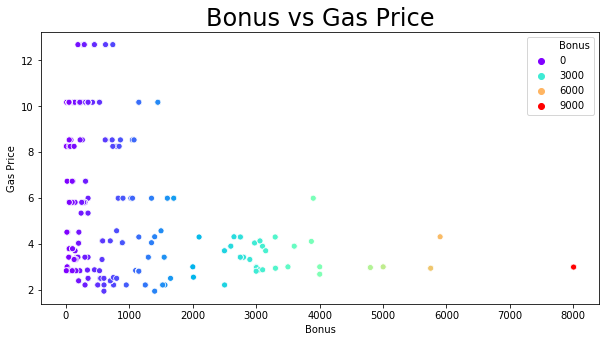

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs Bonus')

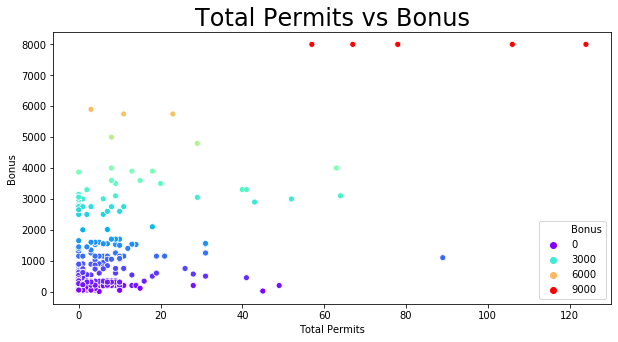

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs Total Permits')

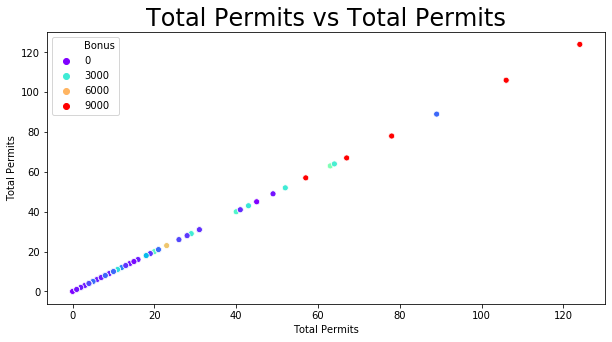

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs Total Wells')

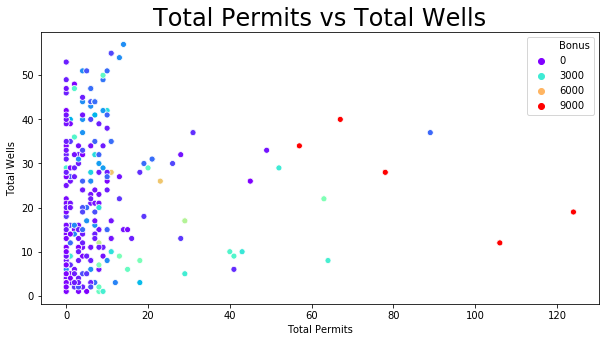

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs Avg First 6 Mo Oil')

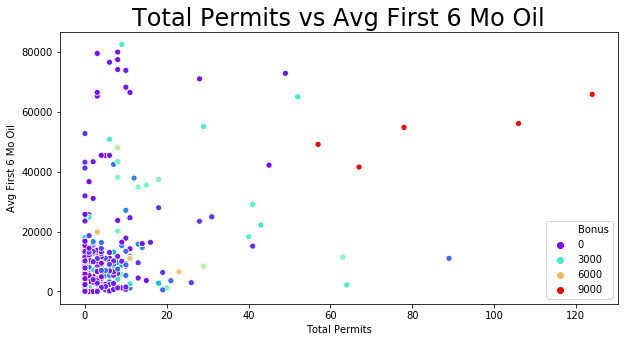

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs Avg First 6 Mo Gas')

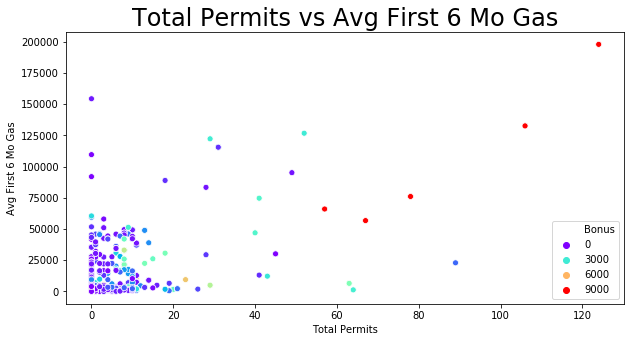

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs Qi Oil')

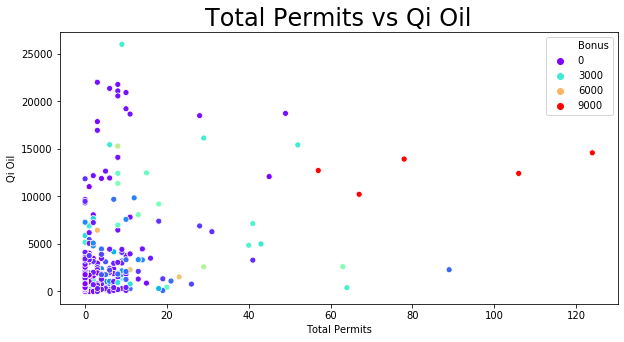

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs Qi Gas')

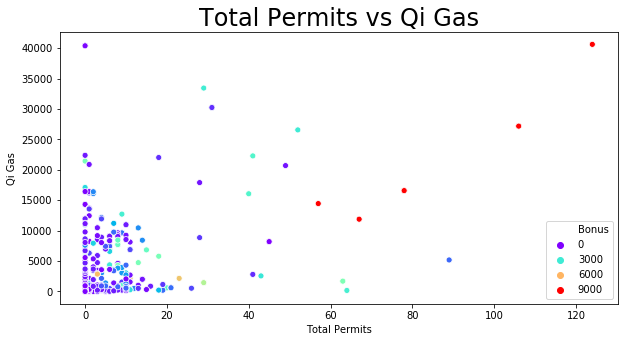

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs 6 Mo Oil Revenue $')

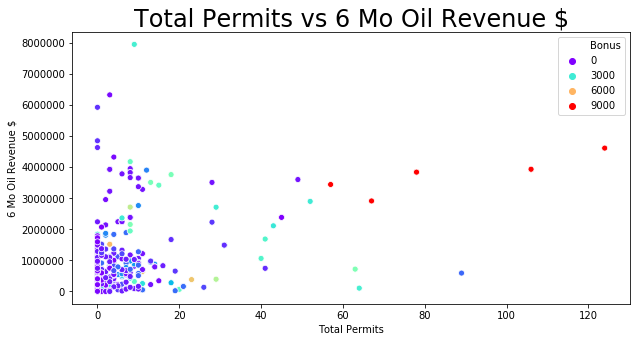

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs 6 Mo Gas Rev $')

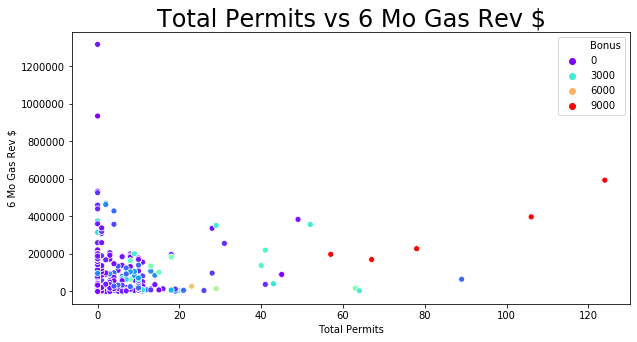

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs Oil Price')

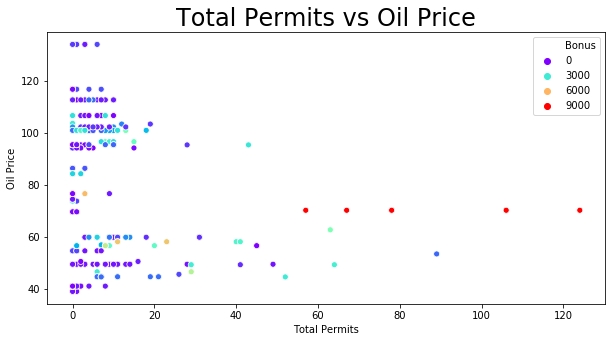

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Permits vs Gas Price')

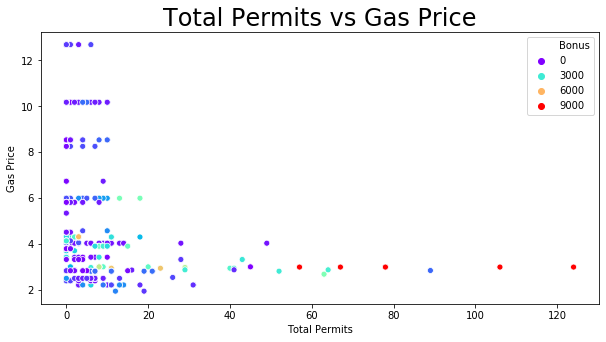

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs Bonus')

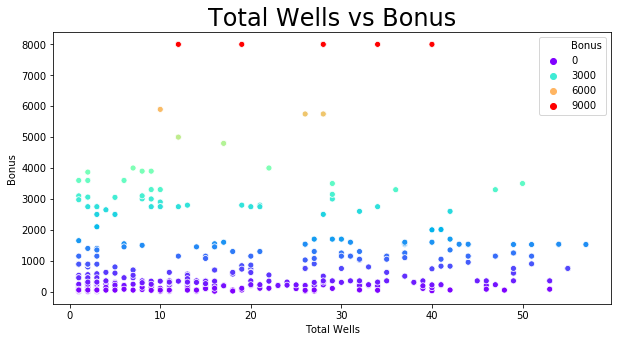

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs Total Permits')

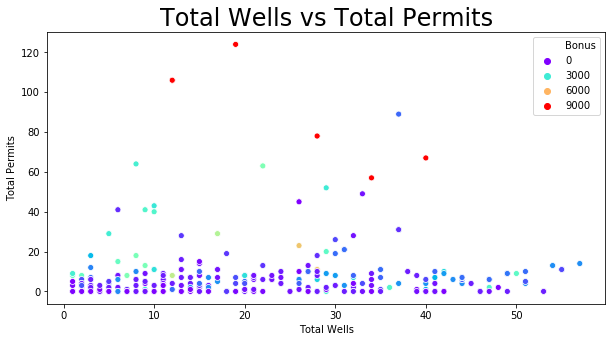

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs Total Wells')

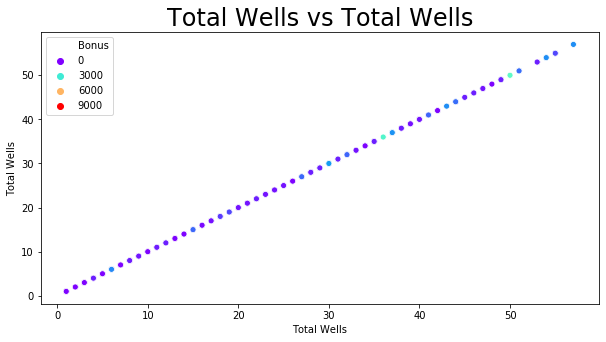

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs Avg First 6 Mo Oil')

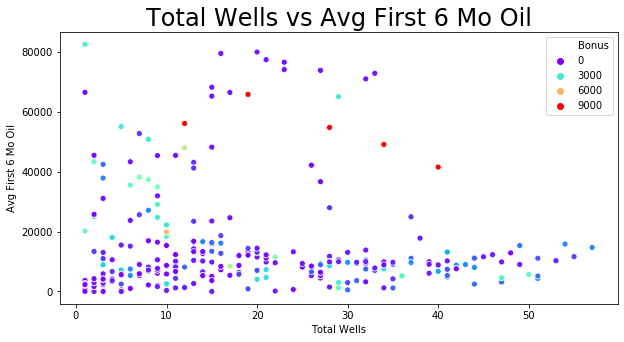

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs Avg First 6 Mo Gas')

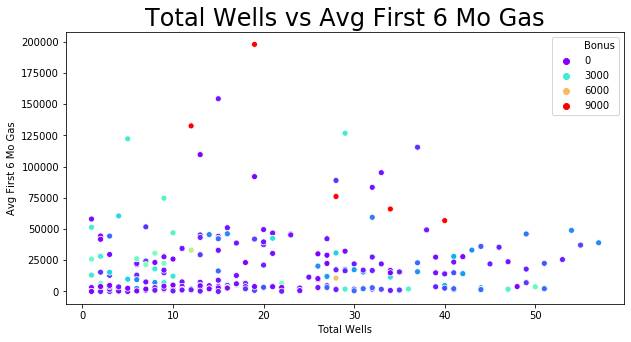

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs Qi Oil')

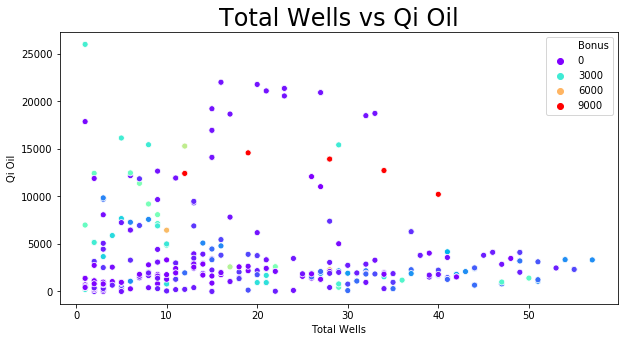

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs Qi Gas')

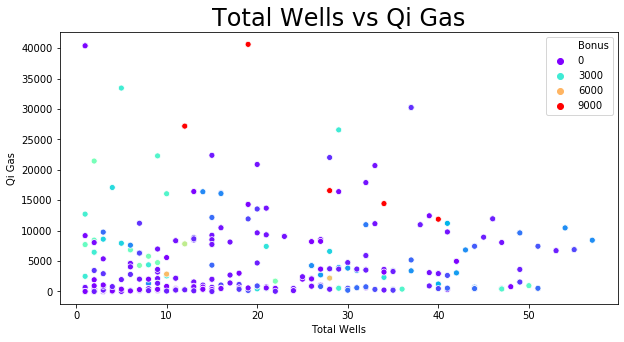

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs 6 Mo Oil Revenue $')

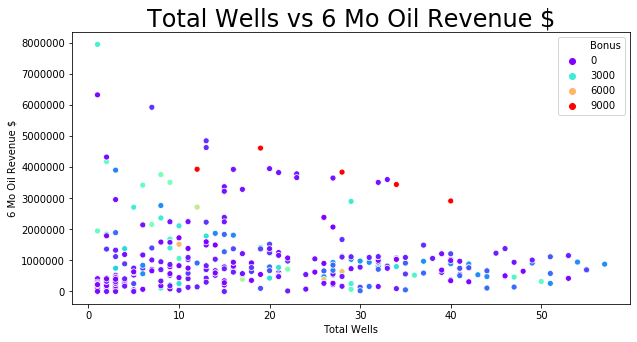

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs 6 Mo Gas Rev $')

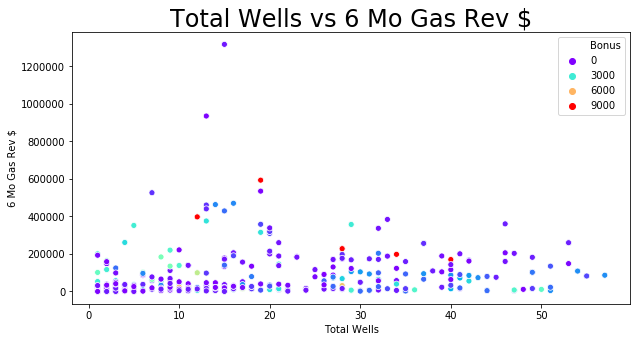

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs Oil Price')

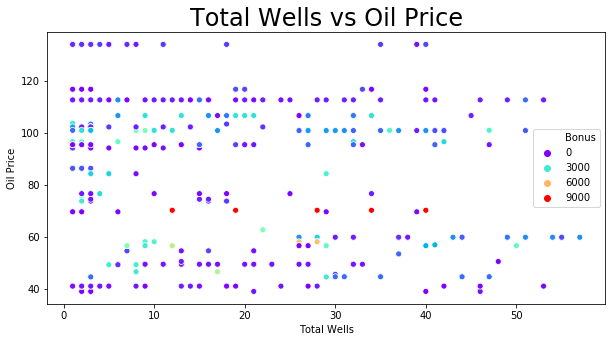

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Total Wells vs Gas Price')

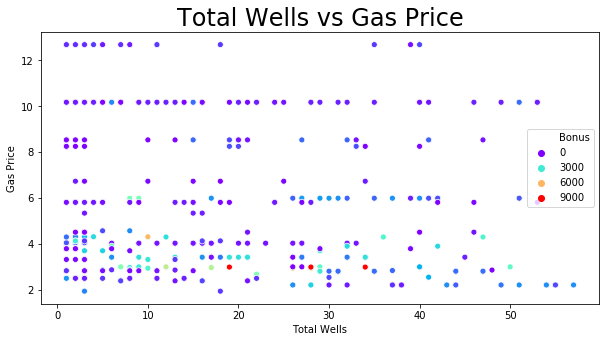

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs Bonus')

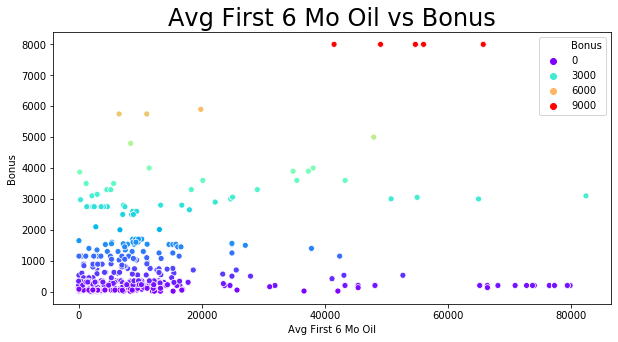

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs Total Permits')

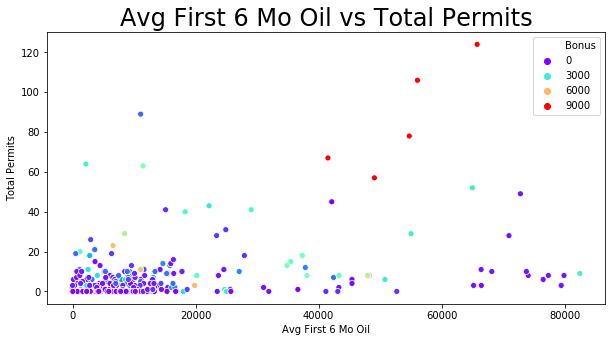

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs Total Wells')

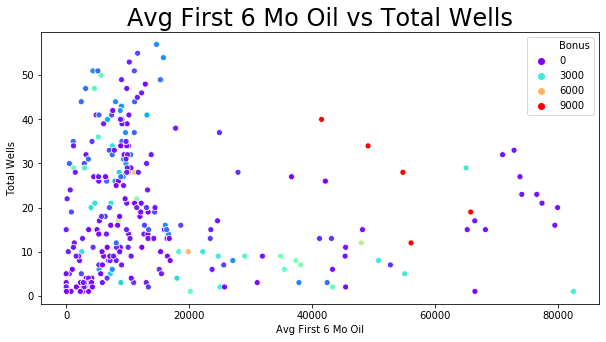

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs Avg First 6 Mo Oil')

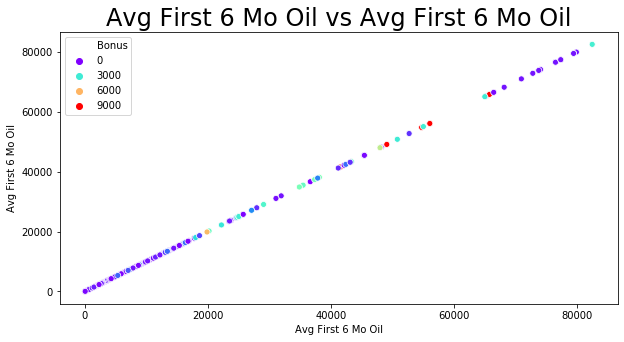

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs Avg First 6 Mo Gas')

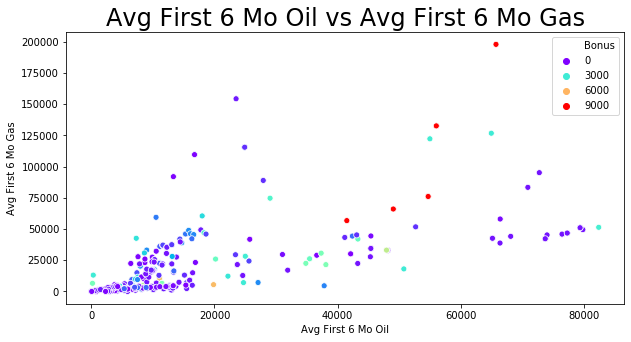

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs Qi Oil')

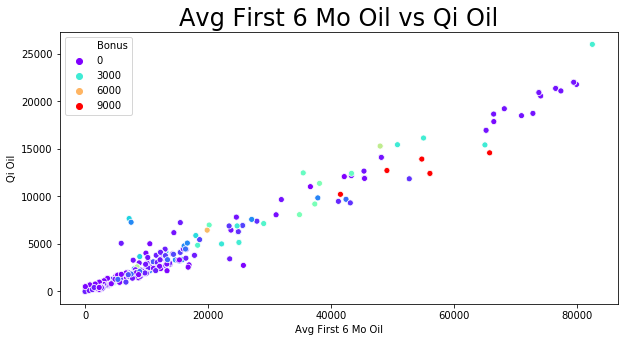

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs Qi Gas')

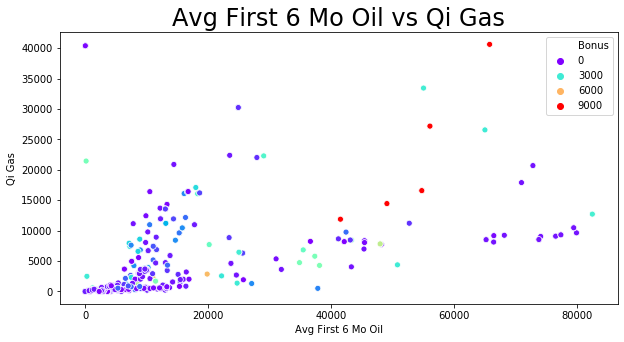

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs 6 Mo Oil Revenue $')

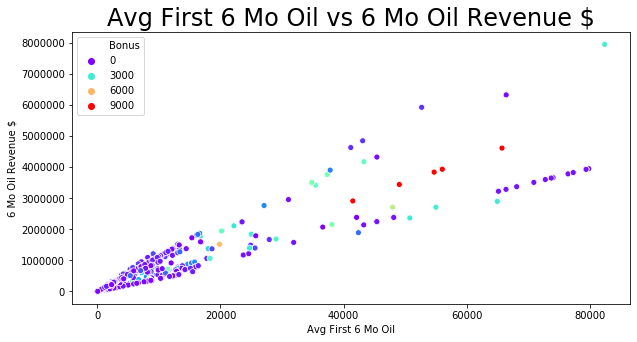

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs 6 Mo Gas Rev $')

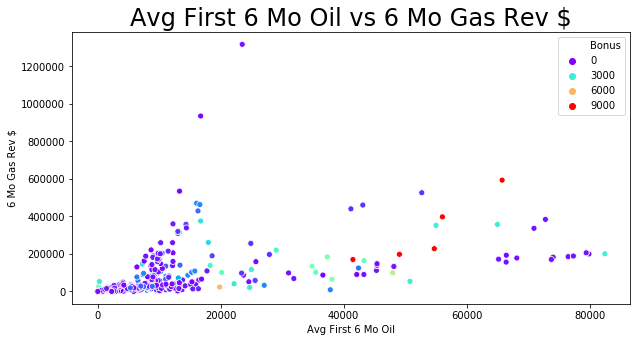

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs Oil Price')

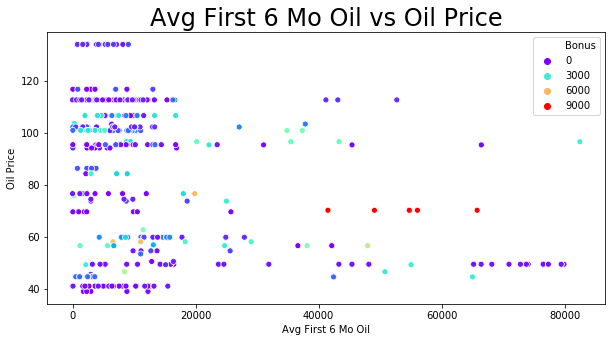

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Oil vs Gas Price')

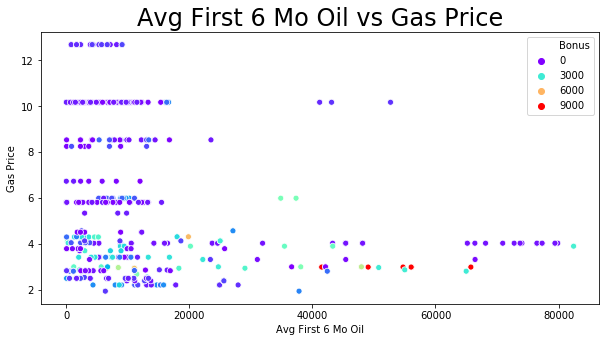

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs Bonus')

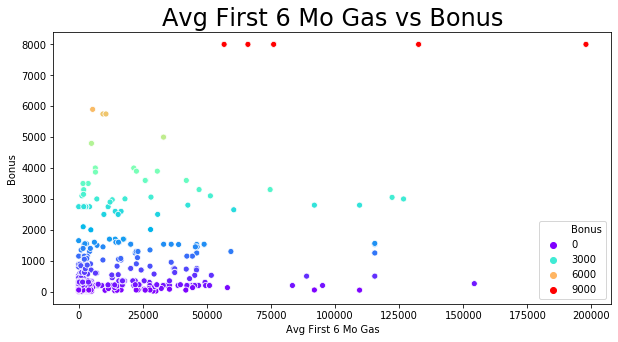

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs Total Permits')

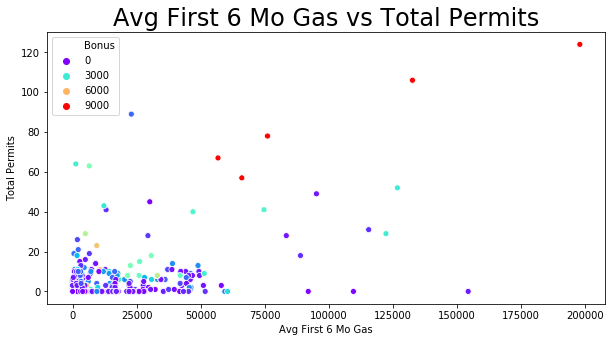

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs Total Wells')

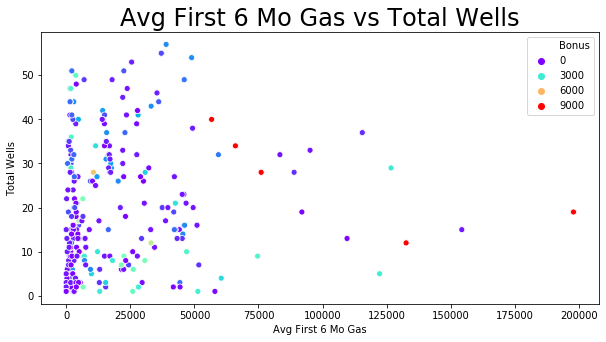

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs Avg First 6 Mo Oil')

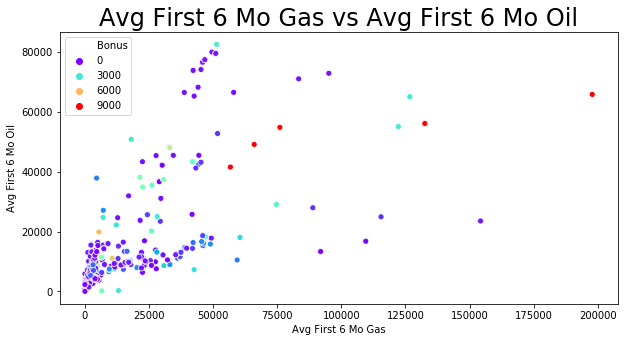

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs Avg First 6 Mo Gas')

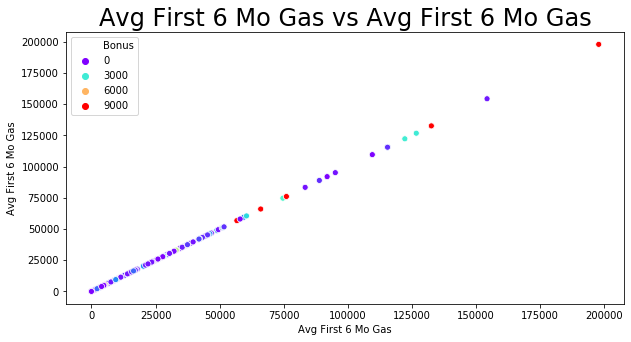

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs Qi Oil')

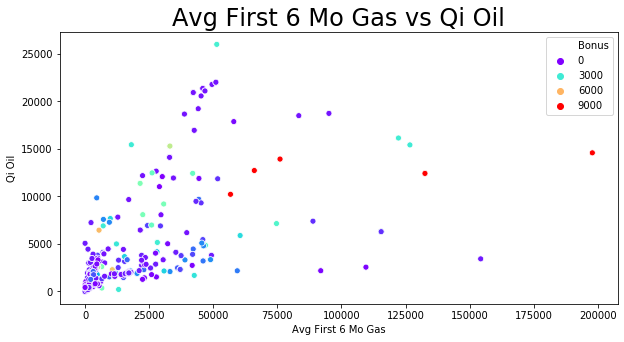

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs Qi Gas')

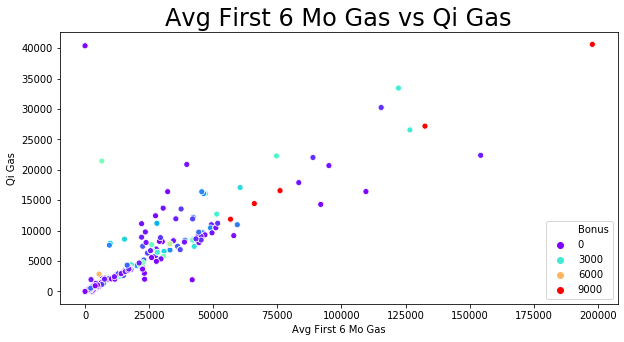

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs 6 Mo Oil Revenue $')

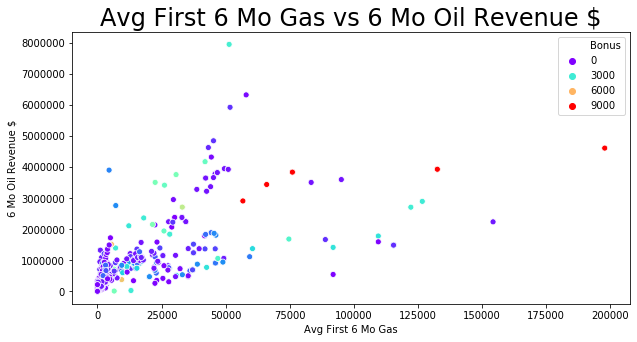

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs 6 Mo Gas Rev $')

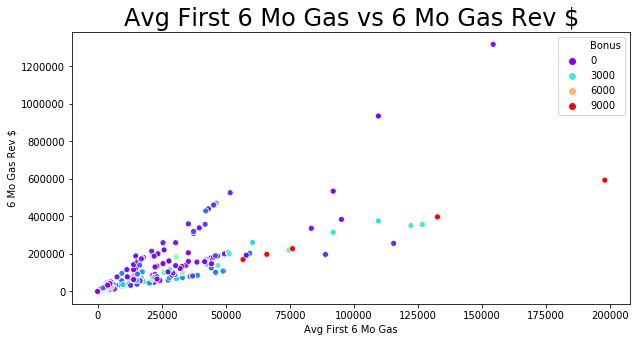

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs Oil Price')

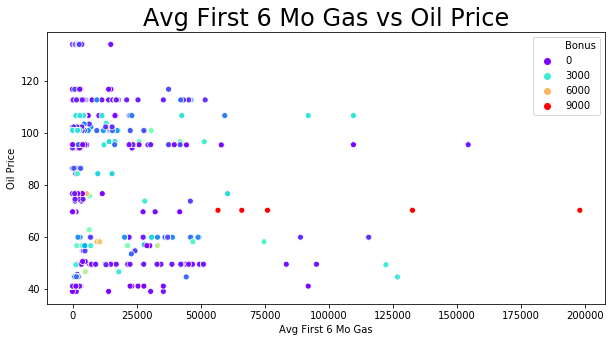

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Avg First 6 Mo Gas vs Gas Price')

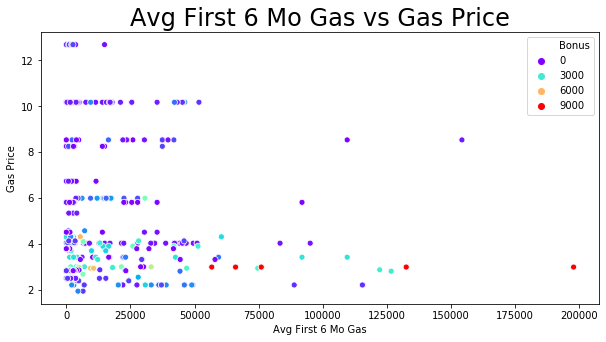

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs Bonus')

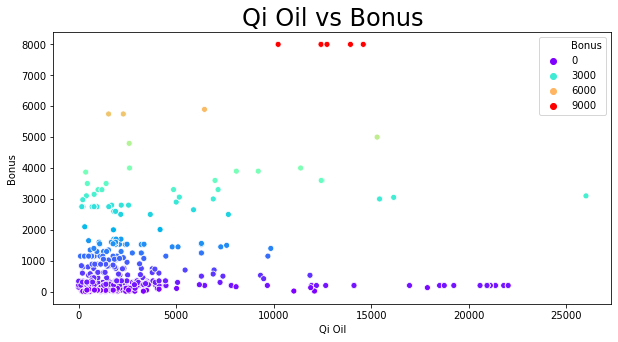

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs Total Permits')

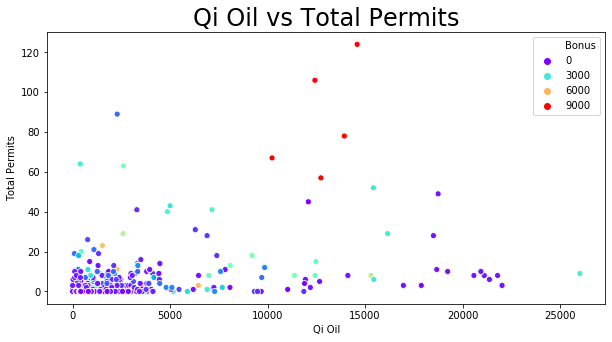

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs Total Wells')

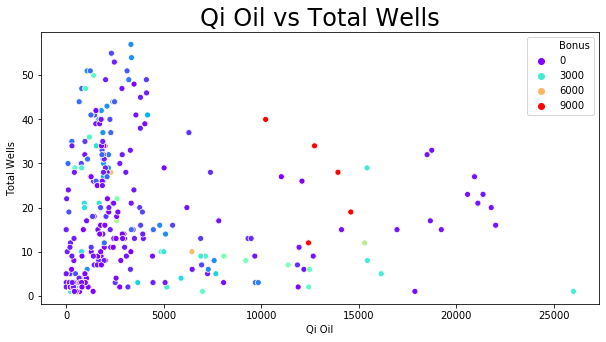

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs Avg First 6 Mo Oil')

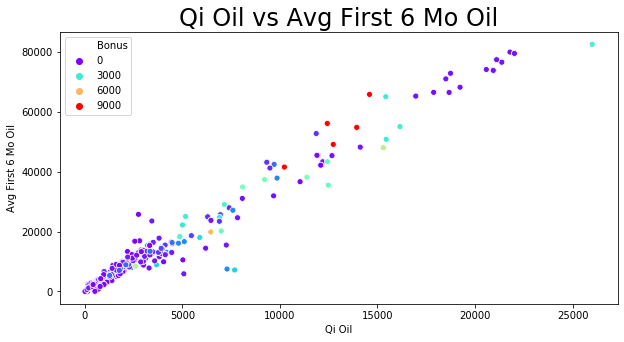

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs Avg First 6 Mo Gas')

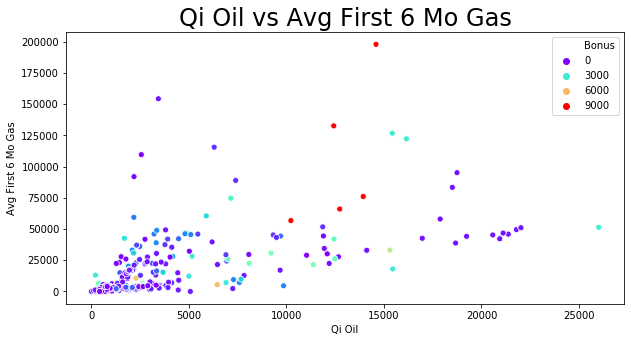

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs Qi Oil')

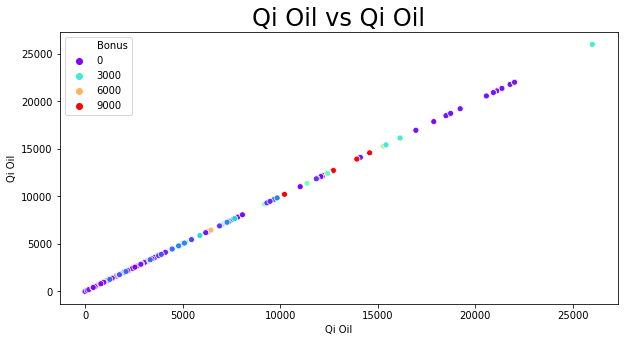

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs Qi Gas')

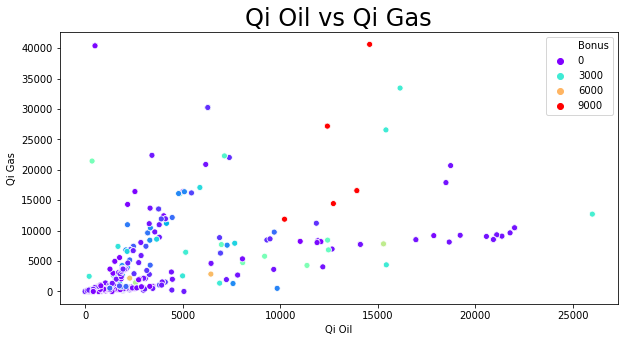

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs 6 Mo Oil Revenue $')

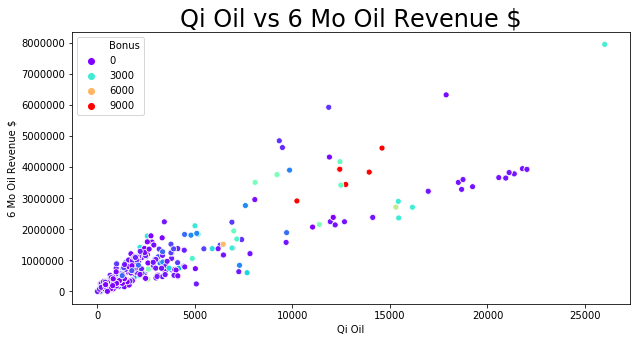

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs 6 Mo Gas Rev $')

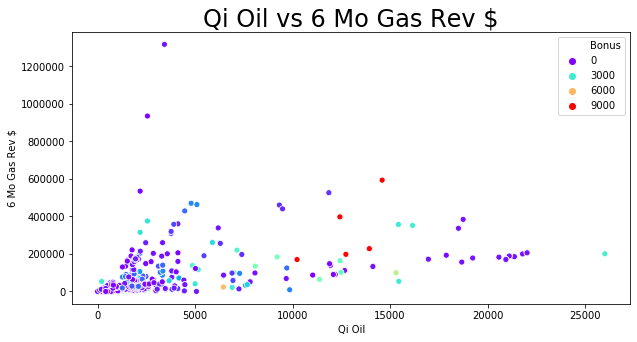

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs Oil Price')

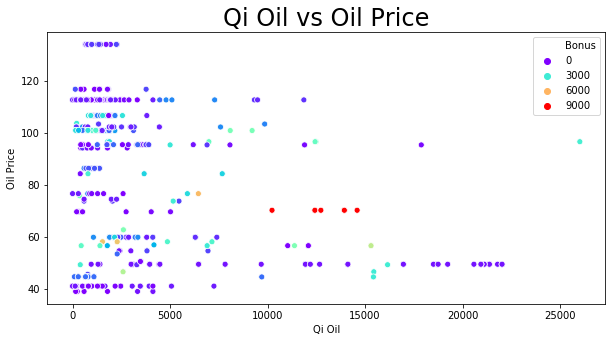

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Oil vs Gas Price')

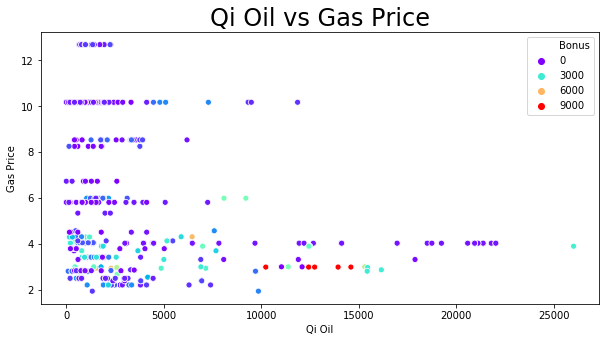

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs Bonus')

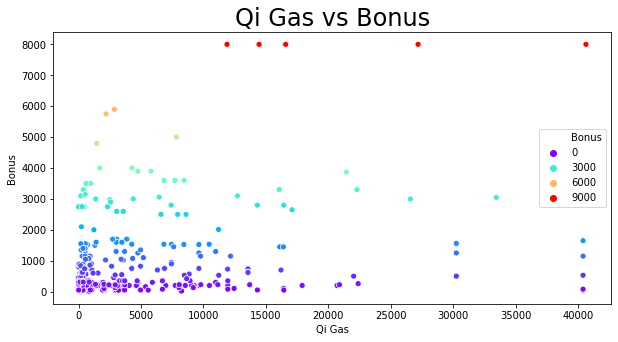

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs Total Permits')

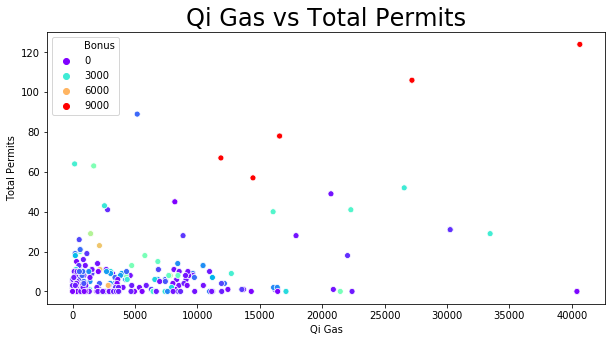

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs Total Wells')

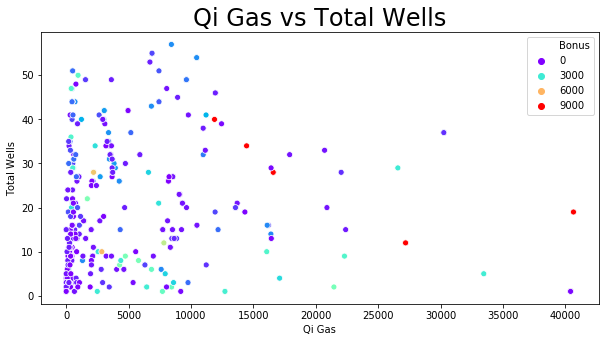

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs Avg First 6 Mo Oil')

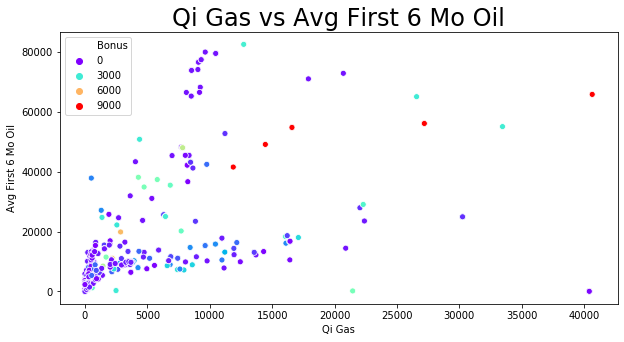

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs Avg First 6 Mo Gas')

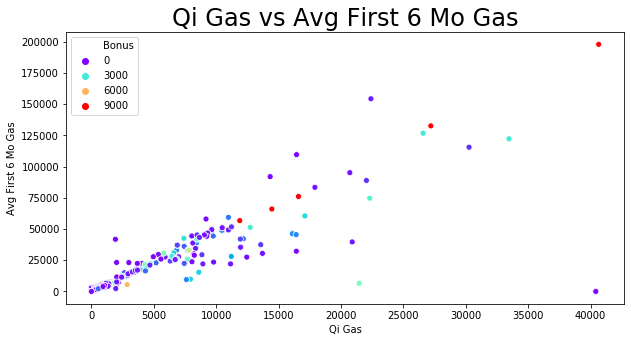

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs Qi Oil')

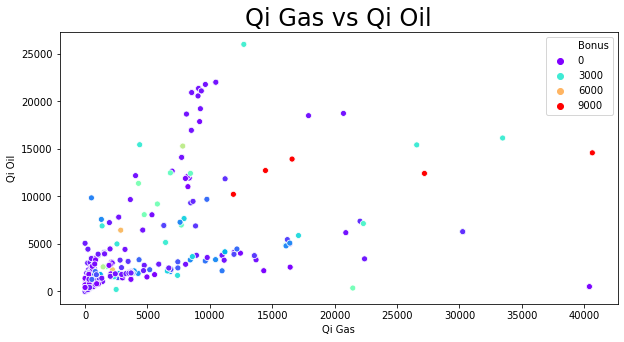

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs Qi Gas')

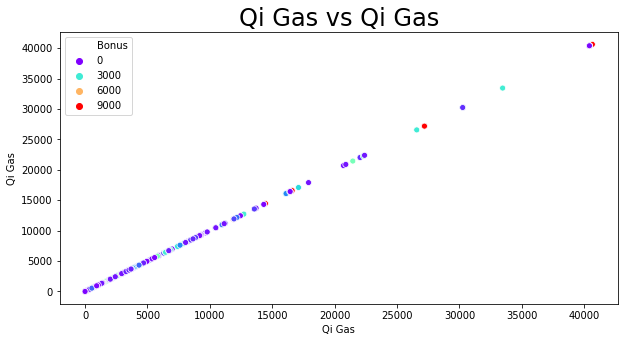

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs 6 Mo Oil Revenue $')

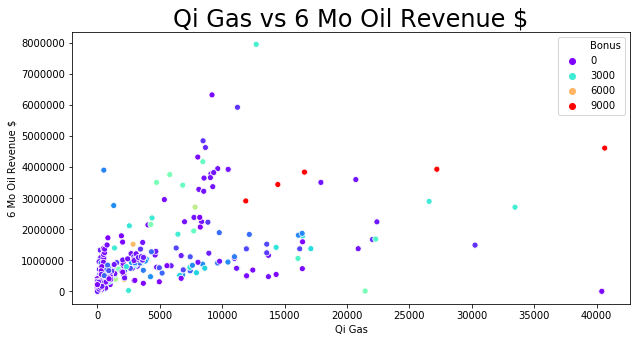

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs 6 Mo Gas Rev $')

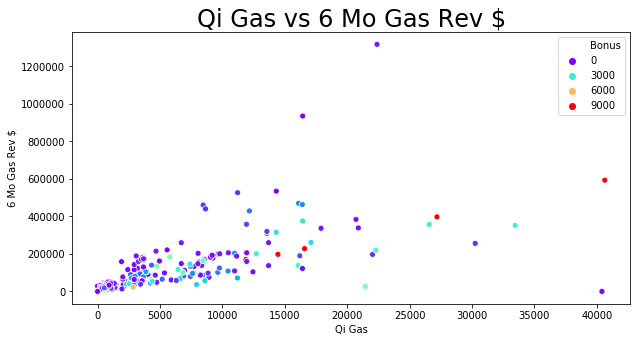

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs Oil Price')

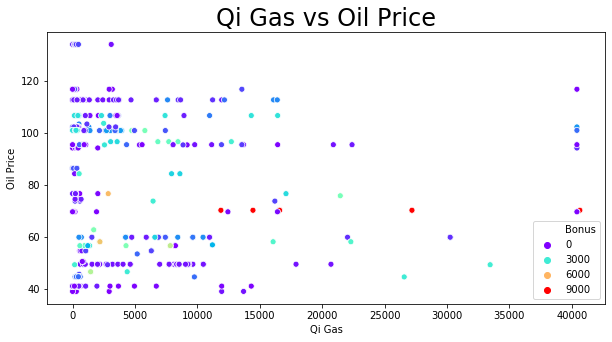

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Qi Gas vs Gas Price')

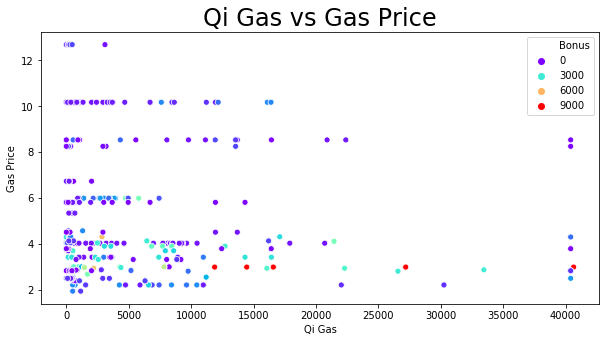

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs Bonus')

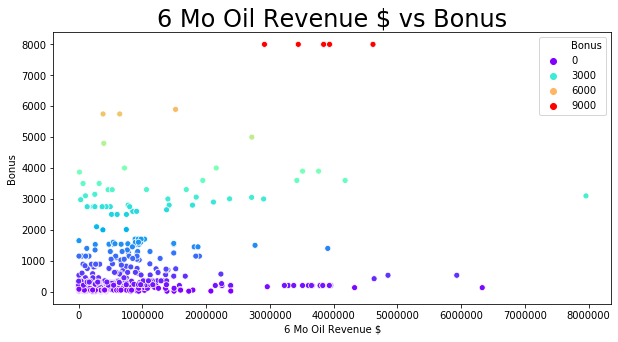

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs Total Permits')

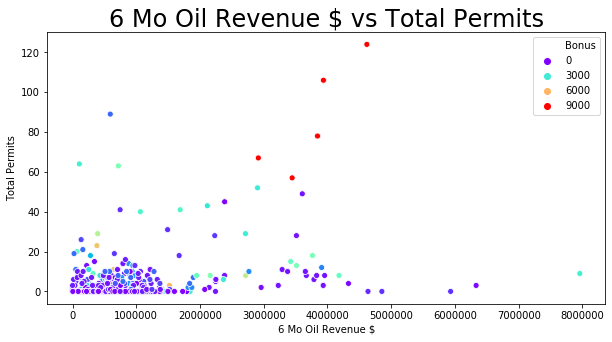

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs Total Wells')

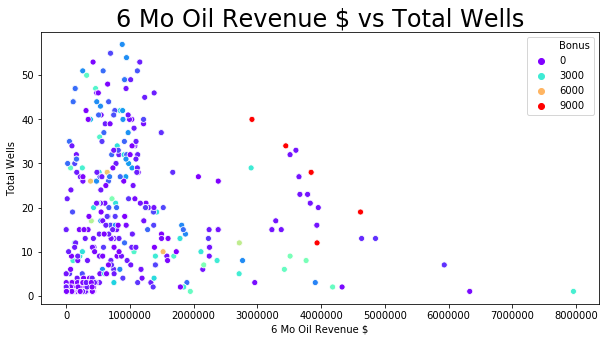

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs Avg First 6 Mo Oil')

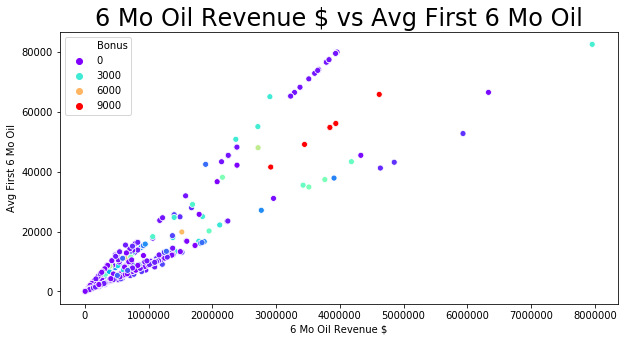

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs Avg First 6 Mo Gas')

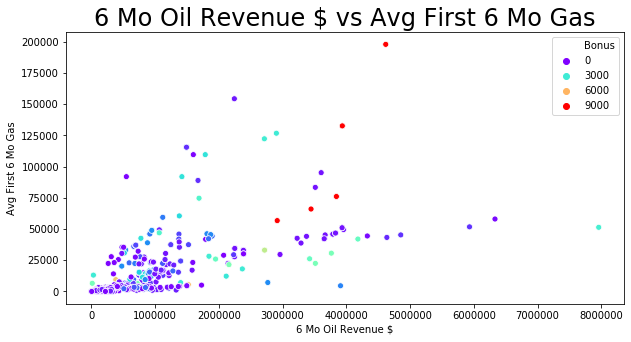

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs Qi Oil')

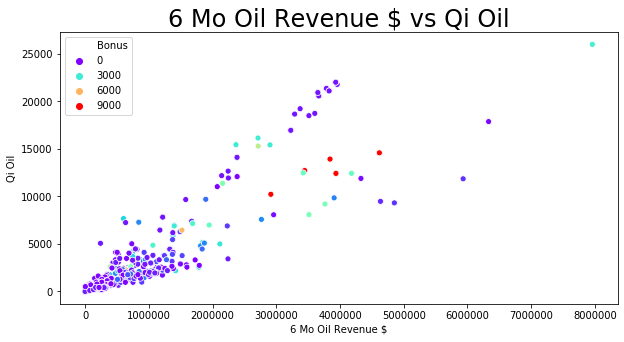

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs Qi Gas')

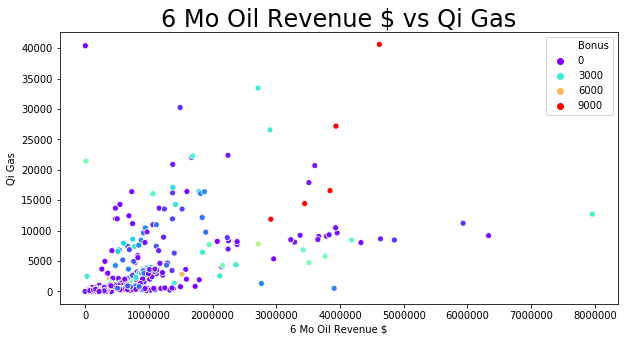

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs 6 Mo Oil Revenue $')

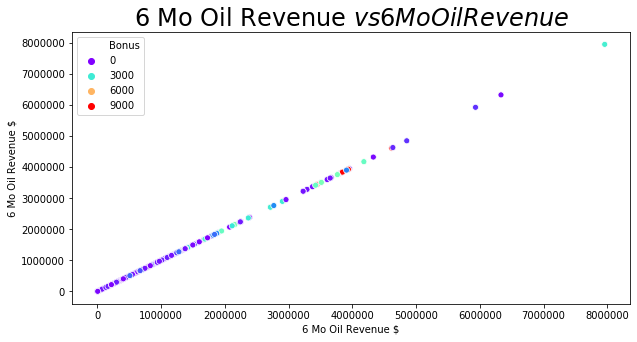

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs 6 Mo Gas Rev $')

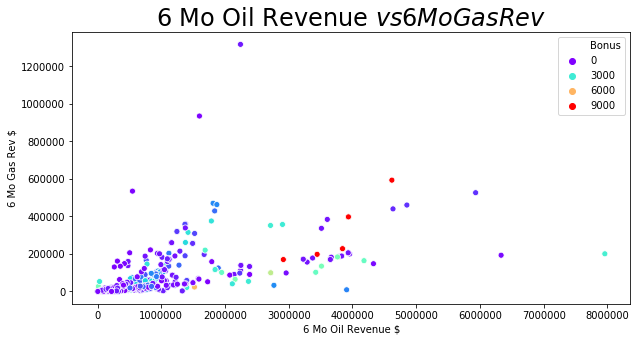

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs Oil Price')

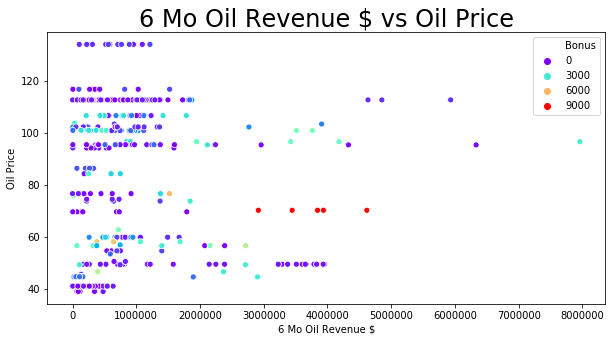

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Oil Revenue $ vs Gas Price')

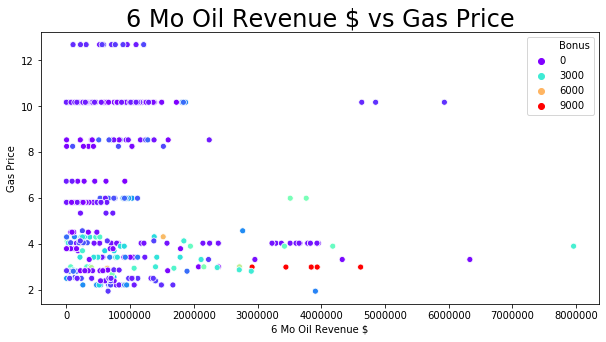

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs Bonus')

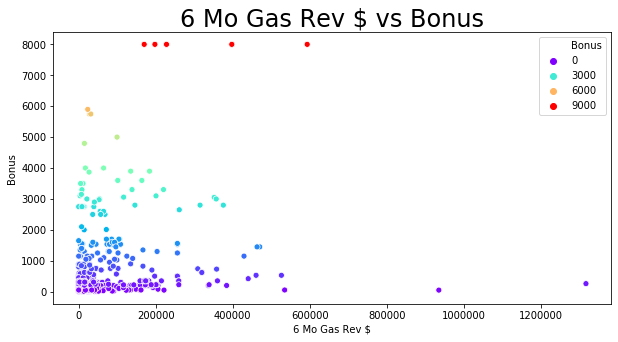

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs Total Permits')

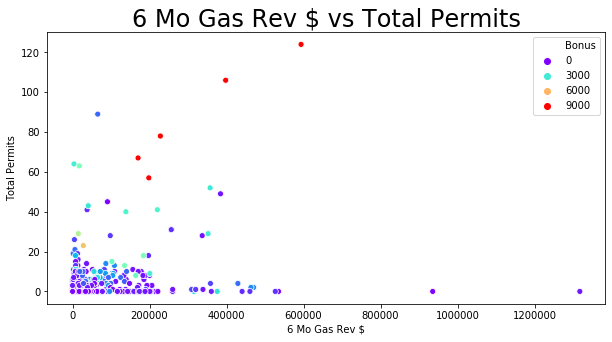

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs Total Wells')

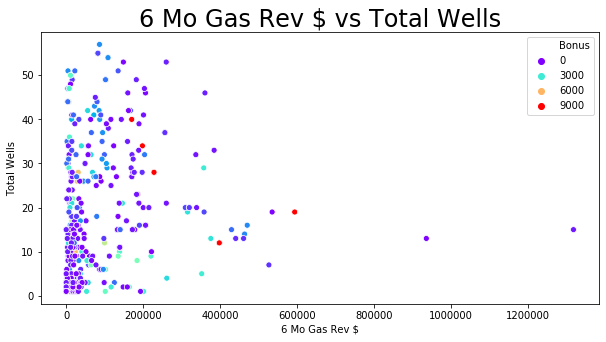

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs Avg First 6 Mo Oil')

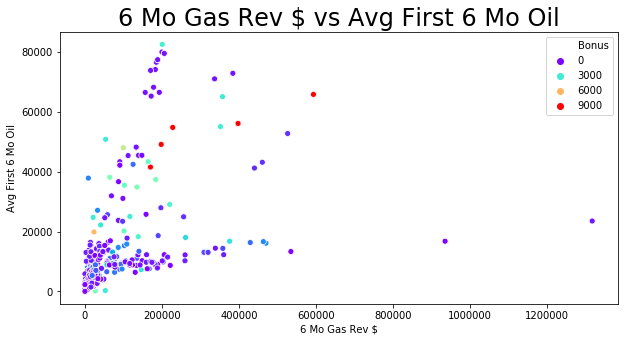

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs Avg First 6 Mo Gas')

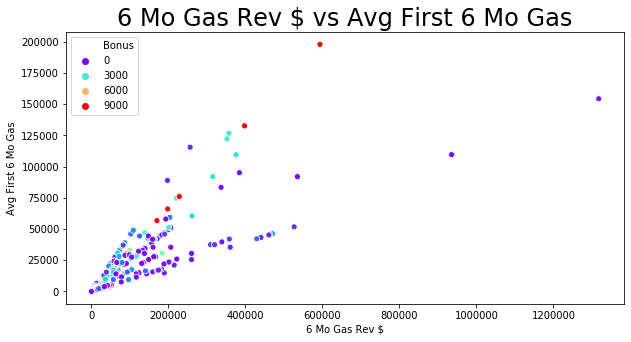

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs Qi Oil')

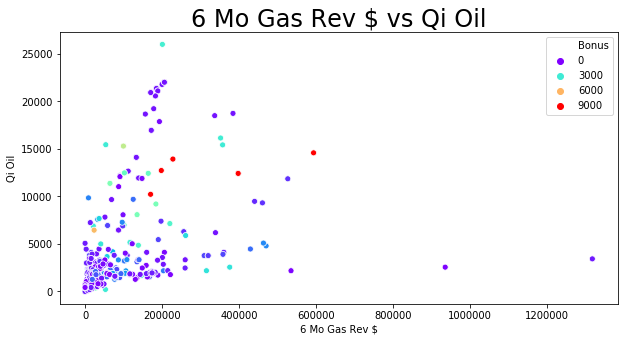

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs Qi Gas')

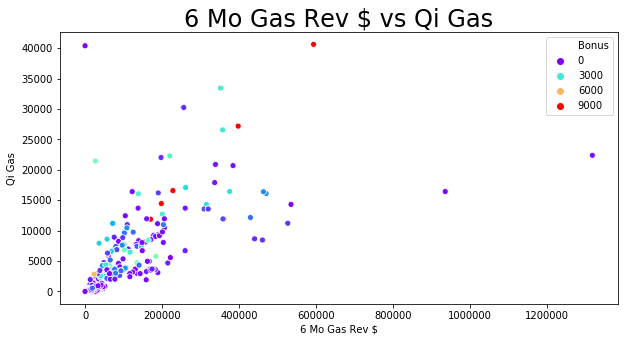

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs 6 Mo Oil Revenue $')

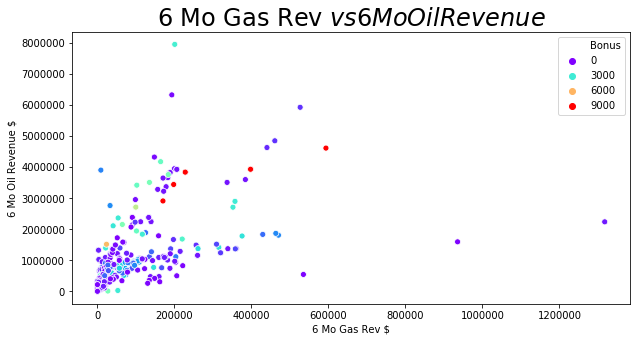

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs 6 Mo Gas Rev $')

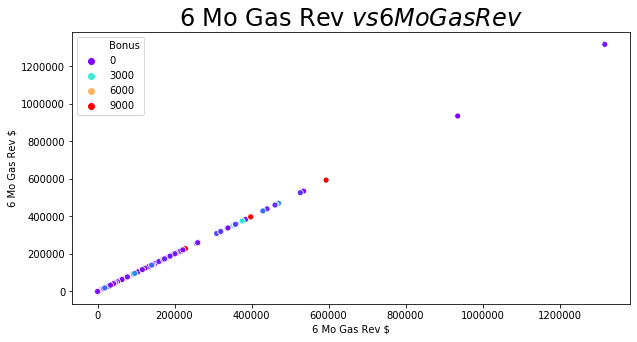

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs Oil Price')

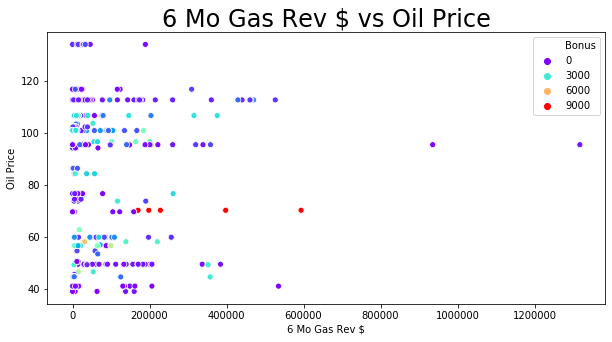

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, '6 Mo Gas Rev $ vs Gas Price')

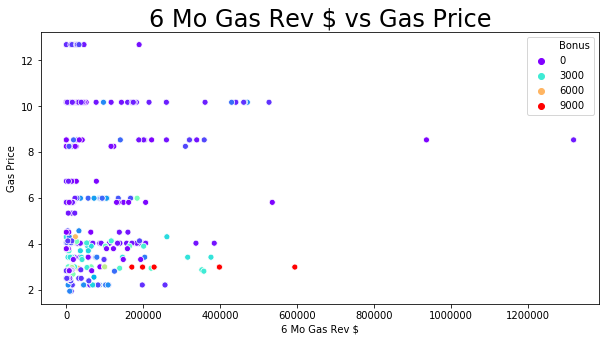

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs Bonus')

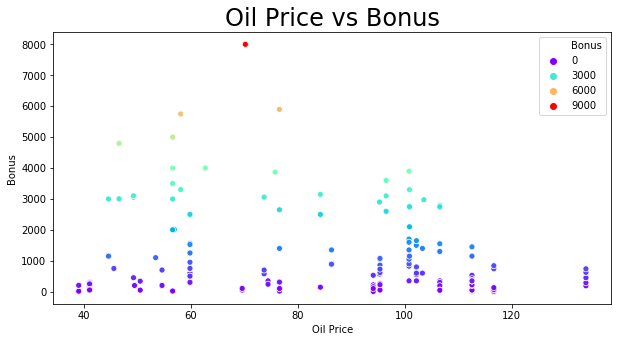

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs Total Permits')

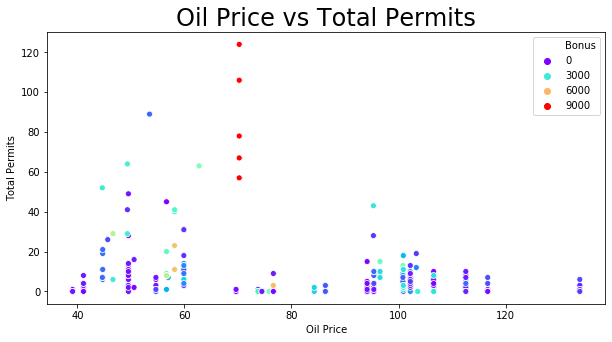

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs Total Wells')

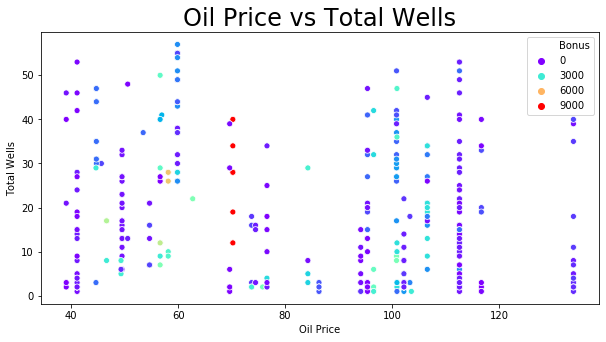

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs Avg First 6 Mo Oil')

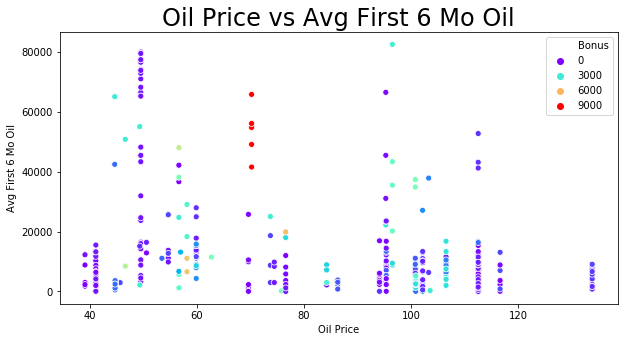

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs Avg First 6 Mo Gas')

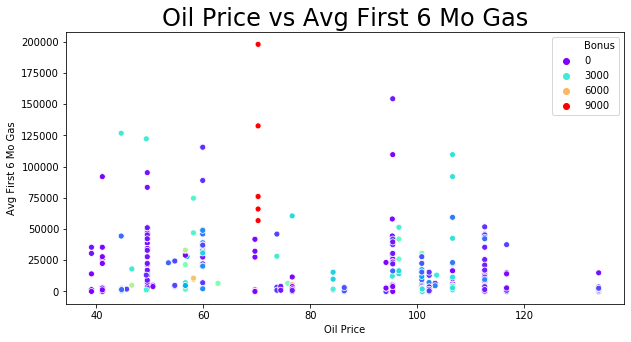

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs Qi Oil')

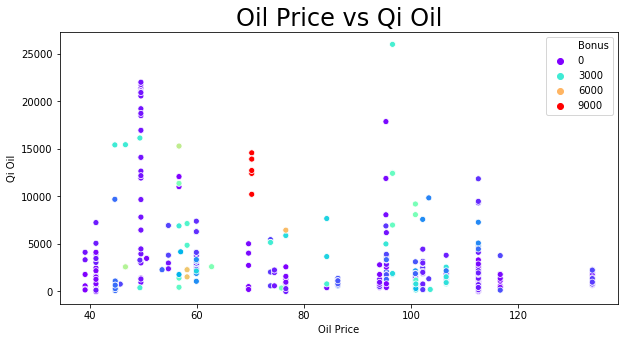

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs Qi Gas')

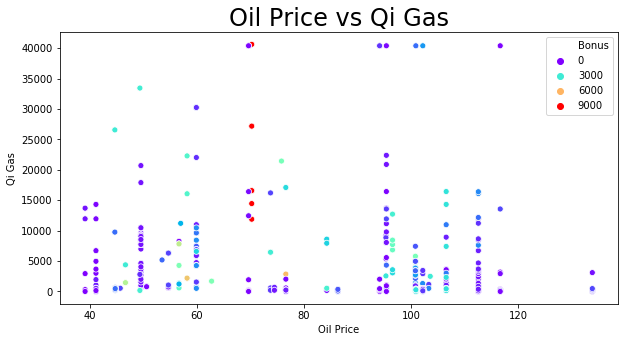

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs 6 Mo Oil Revenue $')

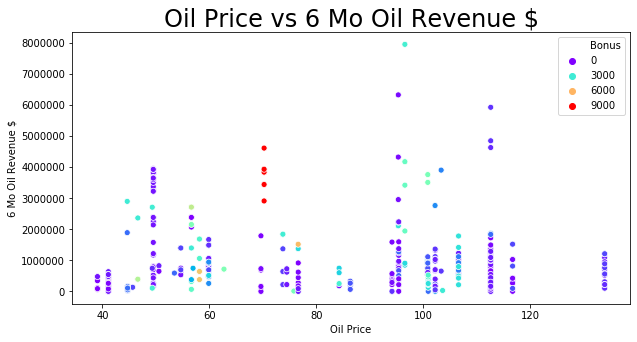

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs 6 Mo Gas Rev $')

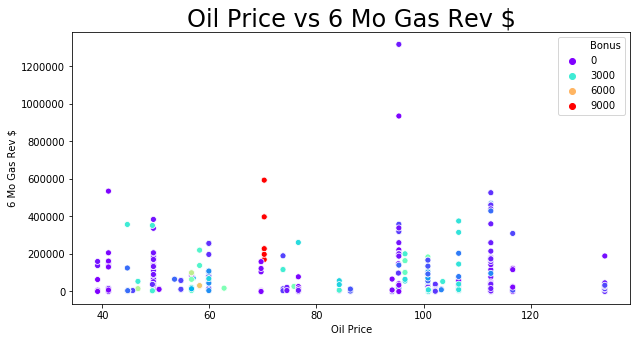

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs Oil Price')

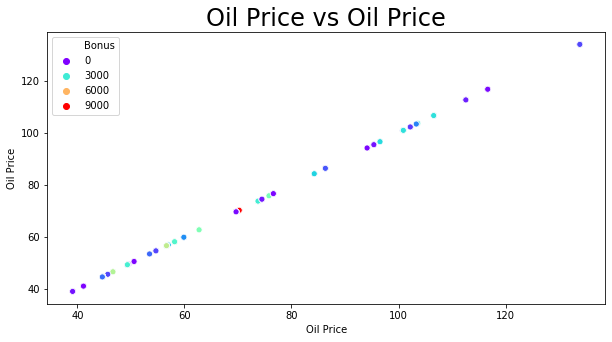

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Oil Price vs Gas Price')

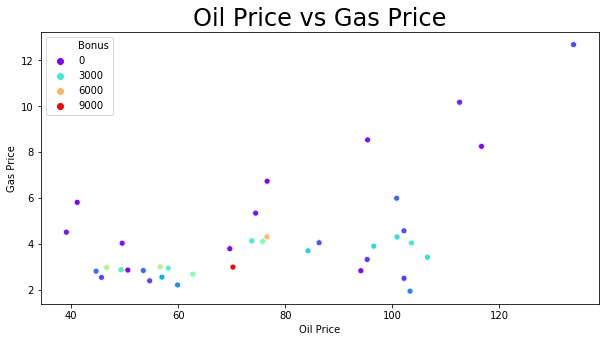

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs Bonus')

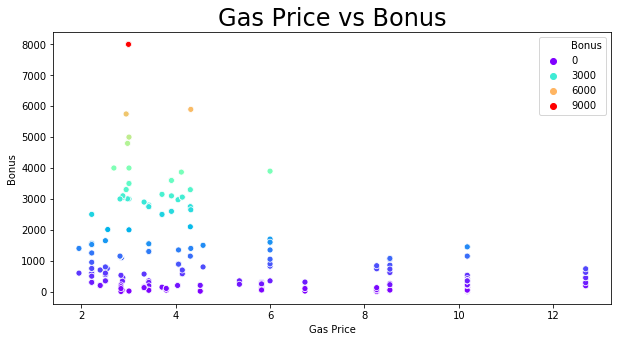

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs Total Permits')

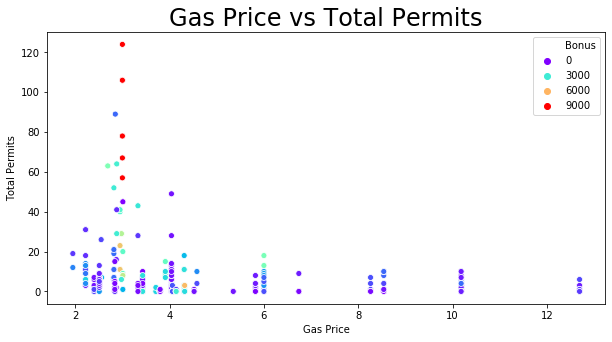

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs Total Wells')

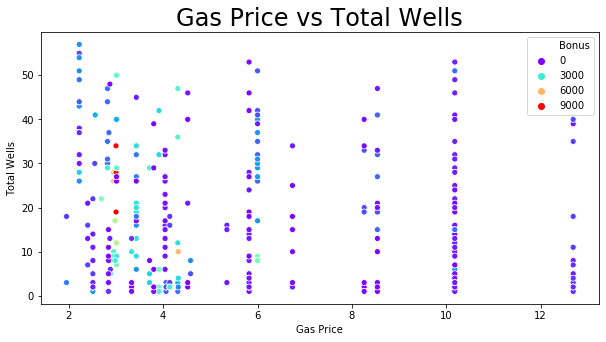

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs Avg First 6 Mo Oil')

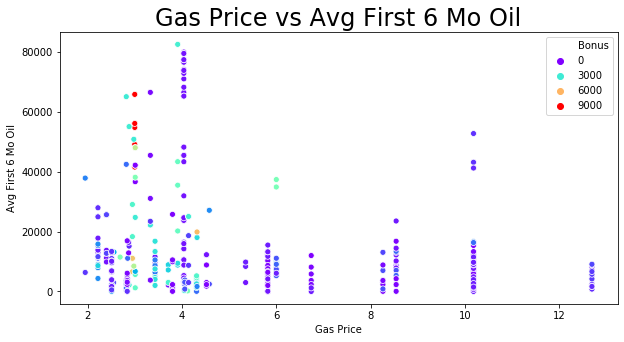

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs Avg First 6 Mo Gas')

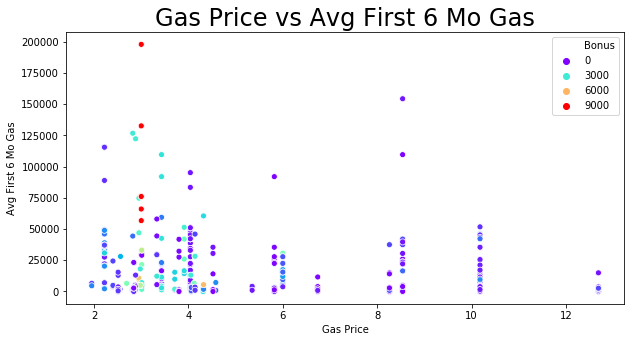

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs Qi Oil')

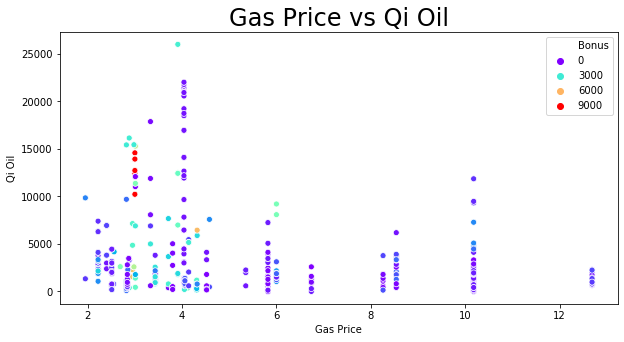

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs Qi Gas')

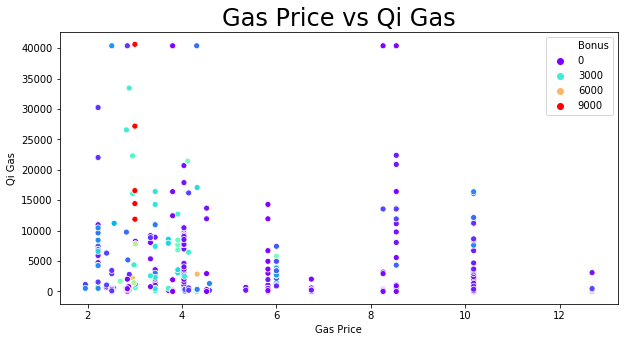

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs 6 Mo Oil Revenue $')

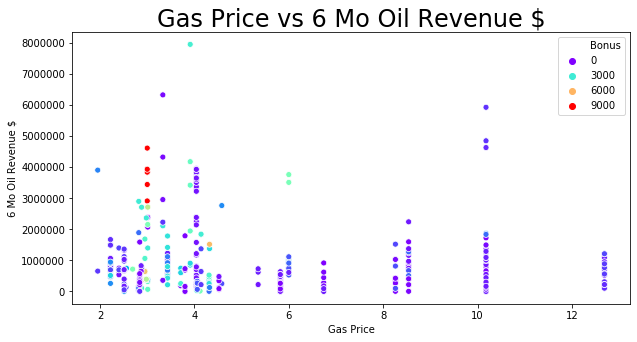

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs 6 Mo Gas Rev $')

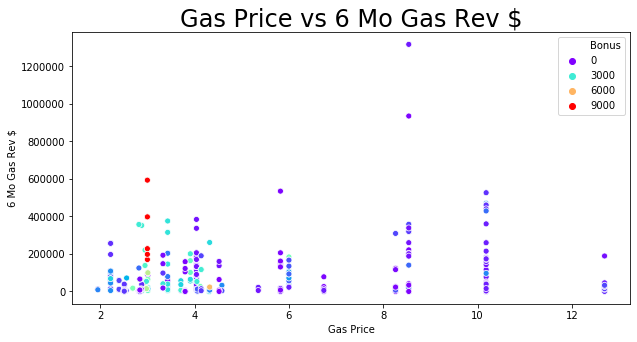

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs Oil Price')

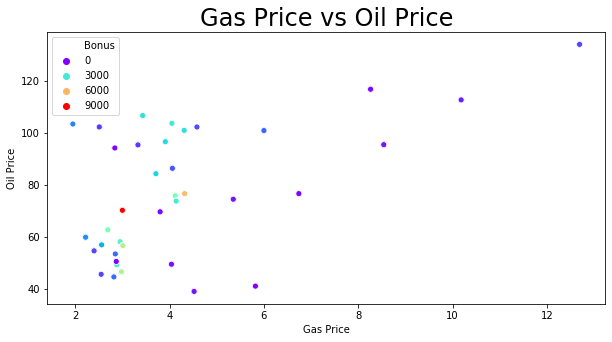

<Figure size 720x360 with 0 Axes>

Text(0.5, 1.0, 'Gas Price vs Gas Price')

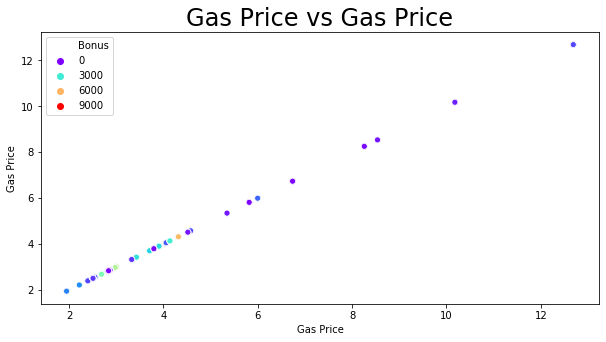

In [863]:
for xcol in MLPredandResponseCols:
    for ycol in MLPredandResponseCols:
        plt.figure(figsize=(10,5))
        sns.scatterplot(cleanedLeases[MLPredandResponseCols][xcol],cleanedLeases[MLPredandResponseCols][ycol], palette="rainbow", hue = cleanedLeases["Bonus"])
        plt.title(xcol + " vs " + ycol, size = 24)
        
        plt.show()

### Writing Cleaned Data Set to File

In [604]:
#writing cleaned Training Leases to file
cleanedLeases.to_excel("Output Data/Training Leases Activity Data/Cleaned Training Leases.xlsx")

# Testing a model with Sklearn

### Reading in Cleaned Data


In [3]:
from sklearn.preprocessing import StandardScaler

In [4]:
#reading in cleaned leases from file for easy retrieval
cleanedLeases = pd.read_excel("Output Data/Training Leases Activity Data/Cleaned Training Leases.xlsx")

In [5]:
#resetting index to original index prior to exporting to file
cleanedLeases.head()
cleanedLeases.set_index("LeaseIndex", inplace = True)

cleanedLeases.head()

,LeaseIndex,Record Date,Record Number,Bonus,Section,Township,Range,geometry,buffers,Total Permits,...,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price,TWSHP,Record Year,Log Bonus
0,57,2019-12-11,WYW189586,1527,3,39,73,POINT (450547.6131938574 4803344.147960225),"POLYGON ((455375.6331938574 4803344.147960225,...",9,...,46031.020833,3210.612245,9631.836735,9.161291e+05,102188.866250,59.88,2.22,39 73,2019,7.331060
1,58,2019-12-11,WYW189586,1527,9,39,73,POINT (448886.0374564391 4801760.549607107),"POLYGON ((453714.0574564391 4801760.549607107,...",14,...,38966.214286,3319.473684,8427.894737,8.790245e+05,86504.995714,59.88,2.22,39 73,2019,7.331060
2,59,2019-12-11,WYW189590,302,27,39,73,POINT (450464.34694615 4796947.371161564),"POLYGON ((455292.36694615 4796947.371161564, 4...",10,...,49281.540541,3801.315789,10975.263158,1.064804e+06,109405.020000,59.88,2.22,39 73,2019,5.710427
3,60,2019-12-11,WYW189596,1535,32,40,73,POINT (447329.5662888384 4804957.255790628),"POLYGON ((452157.5862888384 4804957.255790628,...",6,...,33128.175000,2092.325581,6826.046512,5.377658e+05,73544.548500,59.88,2.22,40 73,2019,7.336286
4,61,2019-12-11,WYW189593,752,28,40,73,POINT (448968.4909649936 4806538.52595432),"POLYGON ((453796.5109649936 4806538.52595432, ...",6,...,20281.240000,1899.230769,4250.769231,4.755215e+05,45024.352800,59.88,2.22,40 73,2019,6.622736


,Record Date,Record Number,Bonus,Section,Township,Range,geometry,buffers,Total Permits,Total Wells,...,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price,TWSHP,Record Year,Log Bonus
LeaseIndex,,,,,,,,,,,,,,,,,,,,,
57,2019-12-11,WYW189586,1527,3,39,73,POINT (450547.6131938574 4803344.147960225),"POLYGON ((455375.6331938574 4803344.147960225,...",9,49,...,46031.020833,3210.612245,9631.836735,9.161291e+05,102188.866250,59.88,2.22,39 73,2019,7.331060
58,2019-12-11,WYW189586,1527,9,39,73,POINT (448886.0374564391 4801760.549607107),"POLYGON ((453714.0574564391 4801760.549607107,...",14,57,...,38966.214286,3319.473684,8427.894737,8.790245e+05,86504.995714,59.88,2.22,39 73,2019,7.331060
59,2019-12-11,WYW189590,302,27,39,73,POINT (450464.34694615 4796947.371161564),"POLYGON ((455292.36694615 4796947.371161564, 4...",10,38,...,49281.540541,3801.315789,10975.263158,1.064804e+06,109405.020000,59.88,2.22,39 73,2019,5.710427
60,2019-12-11,WYW189596,1535,32,40,73,POINT (447329.5662888384 4804957.255790628),"POLYGON ((452157.5862888384 4804957.255790628,...",6,43,...,33128.175000,2092.325581,6826.046512,5.377658e+05,73544.548500,59.88,2.22,40 73,2019,7.336286
61,2019-12-11,WYW189593,752,28,40,73,POINT (448968.4909649936 4806538.52595432),"POLYGON ((453796.5109649936 4806538.52595432, ...",6,26,...,20281.240000,1899.230769,4250.769231,4.755215e+05,45024.352800,59.88,2.22,40 73,2019,6.622736


### Standardizing/Scaling inputs

In [138]:
#setting columns of dataframe that will be features or independent variables
inputs = cleanedLeases[["Total Permits",'6 Mo Oil Revenue $',"Total Wells", '6 Mo Gas Rev $']]
target = cleanedLeases["Log Bonus"]

scaler = StandardScaler()
scaler.fit(inputs)

StandardScaler(copy=True, with_mean=True, with_std=True)

In [139]:
inputs_scaled = scaler.transform(inputs)

### Variance inflation factor

In [8]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# To make this as easy as possible to use, we declare a variable where we put
# all features where we want to check for multicollinearity

#create a new data frame which will include all the VIFs
# note that each variable has its own variance inflation factor as this measure is variable specific (not model specific)
vif = pd.DataFrame()

# here we make use of the variance_inflation_factor, which will basically output the respective VIFs 
vif["VIF"] = [variance_inflation_factor(inputs.values, i) for i in range(inputs.shape[1])]
# Finally, I like to include names so it is easier to explore the result
vif["Features"] = inputs.columns

In [9]:
vif

,VIF,Features
0,1.604676,Total Permits
1,2.629100,6 Mo Oil Revenue $
2,1.590175,Total Wells
3,2.217620,6 Mo Gas Rev $


### Splitting training and testing data - Fitting multilinear regression

In [251]:
# Import the module for the split
from sklearn.model_selection import train_test_split

# Split the variables with an 80-20 split and some random state
# To have the same split as mine, use random_state = 365
x_train, x_test, y_train, y_test = train_test_split(inputs_scaled, target, test_size=0.15, random_state = 10)

In [252]:
#instantiating linear model
from sklearn.linear_model import LinearRegression
reg = LinearRegression()
reg.fit(x_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

### Retrieving Predictions from X train features

In [253]:
#predicting bonuses based on training data
y_pred = reg.predict(x_train)

Text(0.5, 1.0, 'predicted bonus vs acutal bonus')

Text(0, 0.5, 'Prediced Log Bonus')

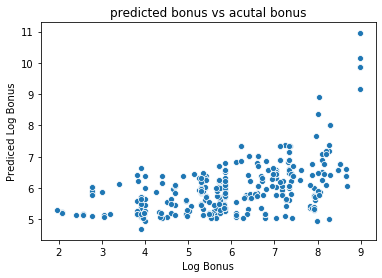

In [254]:
sns.scatterplot(y_train, y_pred)
plt.title("predicted bonus vs acutal bonus")
plt.ylabel("Prediced Log Bonus")


### Model Parameters

In [255]:
reg.coef_

inputs.columns

weights_Table = pd.DataFrame(data = reg.coef_, index = inputs.columns, columns = ["Weights"])

array([ 0.48504832,  0.39329113,  0.41489969, -0.15674212])

Index(['Total Permits', '6 Mo Oil Revenue $', 'Total Wells', '6 Mo Gas Rev $'], dtype='object')

In [256]:
weights_Table
print("Y intercept " + str(reg.intercept_))

,Weights
Total Permits,0.485048
6 Mo Oil Revenue $,0.393291
Total Wells,0.414900
6 Mo Gas Rev $,-0.156742


Y intercept 5.961871600154061


### Model Results and Predictions

In [293]:
def modelPerformance(actual, predictions):
    mae = metrics.mean_absolute_error(actual,predictions)
    var = metrics.explained_variance_score(actual, predictions)
    r2 = metrics.r2_score(actual, predictions)
    
    print("Mean Absolute Error: {} \nVariance Explained: {} \nR2 Score: {}".format(mae,var,r2))

In [257]:
y_pred_Bonus = np.exp(y_pred)

In [258]:
from sklearn import metrics
results = pd.DataFrame()

results["Bonus"] = np.exp(y_train)

results["Predicted"] = y_pred_Bonus

results["Perc Error"] = ((results["Predicted"] - results["Bonus"])/results["Bonus"]) * 100

In [259]:
results["Perc Error"].apply(lambda x: abs(x)).mean()
results["Perc Error"].mean()

195.4978382371477

138.9664911195031

In [260]:
metrics.mean_absolute_error(y_pred_Bonus, np.exp(y_train))

886.5214100274991

In [261]:
results

,Bonus,Predicted,Perc Error
LeaseIndex,,,
2505,55.0,589.983141,972.696620
2502,2750.0,321.279975,-88.317092
2704,350.0,371.920640,6.263040
3072,50.0,163.093619,226.187239
2356,1500.0,934.645823,-37.690278
2507,2800.0,278.794616,-90.043049
1858,451.0,920.832631,104.175750
3079,300.0,250.464652,-16.511783
3255,13.0,172.068883,1223.606789


### Merging Full Train Leases Dataframe with Model Predicted Information

In [262]:
#joining cleanedLeases information with index of predicted and training bonuses
resultsConcat = pd.concat([cleanedLeases, results], axis = 1, join="inner")

#rounding results to clean up dataframe
resultsConcat = resultsConcat.round(decimals = 0)

In [263]:
resultsConcat.head(3)
resultsConcat.columns

,Record Date,Record Number,Bonus,Section,Township,Range,geometry,buffers,Total Permits,Total Wells,...,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price,TWSHP,Record Year,Log Bonus,Bonus,Predicted,Perc Error
LeaseIndex,,,,,,,,,,,,,,,,,,,,,
57,2019-12-11,WYW189586,1527,3,39,73,POINT (450547.6131938574 4803344.147960225),"POLYGON ((455375.6331938574 4803344.147960225,...",9,49,...,916129.0,102189.0,60.0,2.0,39 73,2019,7.0,1527.0,978.0,-36.0
59,2019-12-11,WYW189590,302,27,39,73,POINT (450464.34694615 4796947.371161564),"POLYGON ((455292.36694615 4796947.371161564, 4...",10,38,...,1064804.0,109405.0,60.0,2.0,39 73,2019,6.0,302.0,803.0,166.0
60,2019-12-11,WYW189596,1535,32,40,73,POINT (447329.5662888384 4804957.255790628),"POLYGON ((452157.5862888384 4804957.255790628,...",6,43,...,537766.0,73545.0,60.0,2.0,40 73,2019,7.0,1535.0,656.0,-57.0


Index(['Record Date', 'Record Number', 'Bonus', 'Section', 'Township', 'Range',
       'geometry', 'buffers', 'Total Permits', 'Total Wells',
       'Avg First 6 Mo Oil', 'Avg First 6 Mo Gas', 'Qi Oil', 'Qi Gas',
       '6 Mo Oil Revenue $', '6 Mo Gas Rev $', 'Oil Price', 'Gas Price',
       'TWSHP', 'Record Year', 'Log Bonus', 'Bonus', 'Predicted',
       'Perc Error'],
      dtype='object')

In [264]:
#counting how many leases were over predicted by over 500%
len(results)
resultsConcat[resultsConcat["Perc Error"] > 500].count()

371

Record Date           29
Record Number         29
Bonus                 29
Section               29
Township              29
Range                 29
geometry              29
buffers               29
Total Permits         29
Total Wells           29
Avg First 6 Mo Oil    29
Avg First 6 Mo Gas    29
Qi Oil                29
Qi Gas                29
6 Mo Oil Revenue $    29
6 Mo Gas Rev $        29
Oil Price             29
Gas Price             29
TWSHP                 29
Record Year           29
Log Bonus             29
Bonus                 29
Predicted             29
Perc Error            29
dtype: int64

### Univariate Distrubtion of Percent Error

<Figure size 720x288 with 0 Axes>

Text(0.5, 1.0, 'Distribution of Percent Error')

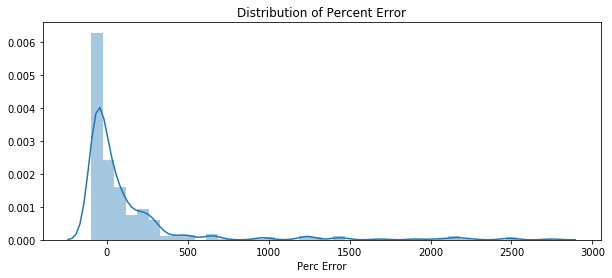

In [265]:
#looking at the distrubtion of our error

plt.figure(figsize=(10,4))
sns.distplot(resultsConcat["Perc Error"], bins = 40)
plt.title("Distribution of Percent Error")


In [266]:
resultsConcat["Perc Error"].quantile(.80)

207.0

* 80% of the training data has an error of less than 184% 
* Considering the volatility of bonus prices this is not a huge surprise

### Scatter Plot Showing Predicted vs Actual Bonus Prices - Lease by Lease

Text(0.5, 1.0, 'Actual Bonus (Green) vs Predicted Bonus (Red)')

Text(0.5, 0, 'Lease Index')

Text(0, 0.5, '$/acre')

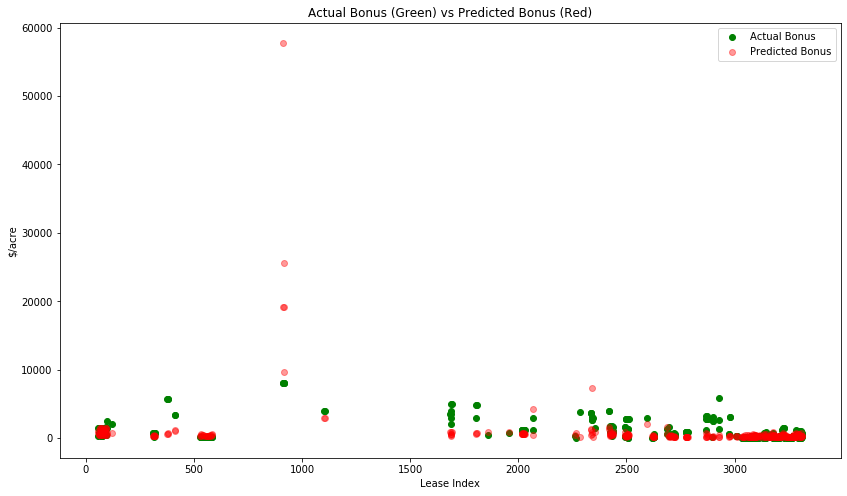

In [267]:
#scatter plot to overlay lease by lease, actual bonus vs predicted bonus
fig, ax1 = plt.subplots(1, figsize = (14,8))
ax1.scatter(resultsConcat.index, resultsConcat.iloc[:,2], c = 'g', label = "Actual Bonus")
ax1.scatter(resultsConcat.index, resultsConcat["Predicted"], c = 'r', alpha = .4, label = "Predicted Bonus")
ax1.set_title("Actual Bonus (Green) vs Predicted Bonus (Red)")
ax1.set_xlabel("Lease Index")
ax1.set_ylabel("$/acre")
ax1.legend()

#### * **We see that the model generally underestimates values** 

In [268]:
resultsConcat.describe().T

,count,mean,std,min,25%,50%,75%,max
Bonus,371.0,990.654987,1417.418897,7.0,147.5,350.0,1201.0,8004.0
Section,371.0,18.760108,10.633660,1.0,9.0,19.0,28.0,36.0
Township,371.0,38.226415,1.071726,37.0,37.0,38.0,39.0,40.0
Range,371.0,72.110512,1.008704,70.0,71.5,72.0,73.0,74.0
Total Permits,371.0,6.150943,13.323780,0.0,0.0,1.0,7.0,124.0
Total Wells,371.0,17.773585,15.641506,1.0,3.0,13.0,29.0,55.0
Avg First 6 Mo Oil,371.0,10011.646900,11160.853019,0.0,3090.0,7282.0,12277.0,82446.0
Avg First 6 Mo Gas,371.0,15269.902965,25446.200952,0.0,1754.0,3628.0,20281.0,197850.0
Qi Oil,371.0,2619.509434,3084.854426,0.0,795.0,1790.0,3104.0,26010.0
Qi Gas,371.0,4281.234501,7689.151727,0.0,314.0,816.0,4620.0,40644.0


* model is predicting one huge error of 2802% and 45k/acre - throwing off avg percent error

In [269]:
resultsConcat.head(3)

,Record Date,Record Number,Bonus,Section,Township,Range,geometry,buffers,Total Permits,Total Wells,...,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price,TWSHP,Record Year,Log Bonus,Bonus,Predicted,Perc Error
LeaseIndex,,,,,,,,,,,,,,,,,,,,,
57,2019-12-11,WYW189586,1527,3,39,73,POINT (450547.6131938574 4803344.147960225),"POLYGON ((455375.6331938574 4803344.147960225,...",9,49,...,916129.0,102189.0,60.0,2.0,39 73,2019,7.0,1527.0,978.0,-36.0
59,2019-12-11,WYW189590,302,27,39,73,POINT (450464.34694615 4796947.371161564),"POLYGON ((455292.36694615 4796947.371161564, 4...",10,38,...,1064804.0,109405.0,60.0,2.0,39 73,2019,6.0,302.0,803.0,166.0
60,2019-12-11,WYW189596,1535,32,40,73,POINT (447329.5662888384 4804957.255790628),"POLYGON ((452157.5862888384 4804957.255790628,...",6,43,...,537766.0,73545.0,60.0,2.0,40 73,2019,7.0,1535.0,656.0,-57.0


In [270]:
#looking at what the training parameters were for the abnormal prediciton of 40k/acre
resultsConcat.loc[resultsConcat["Predicted"]>30000]


,Record Date,Record Number,Bonus,Section,Township,Range,geometry,buffers,Total Permits,Total Wells,...,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price,TWSHP,Record Year,Log Bonus,Bonus,Predicted,Perc Error
LeaseIndex,,,,,,,,,,,,,,,,,,,,,
913,2018-09-18,WYW187435,8004,17,39,72,POINT (456987.9394583493 4800362.80558945),"POLYGON ((461815.9594583493 4800362.80558945, ...",124,19,...,4617697.0,593549.0,70.0,3.0,39 72,2018,9.0,8004.0,57728.0,621.0


* good news is that this abnormal prediciton occured on highest bonus in training data - leads to indication we need to tune the model with potential isotonic regression

In [271]:
DFtrainProdFilter.loc[913]

NameError: name 'DFtrainProdFilter' is not defined

### Honing in on Percent Error on Bonus Price

<Figure size 1080x504 with 0 Axes>

Text(0.5, 1.0, '% Error vs. Bonus')

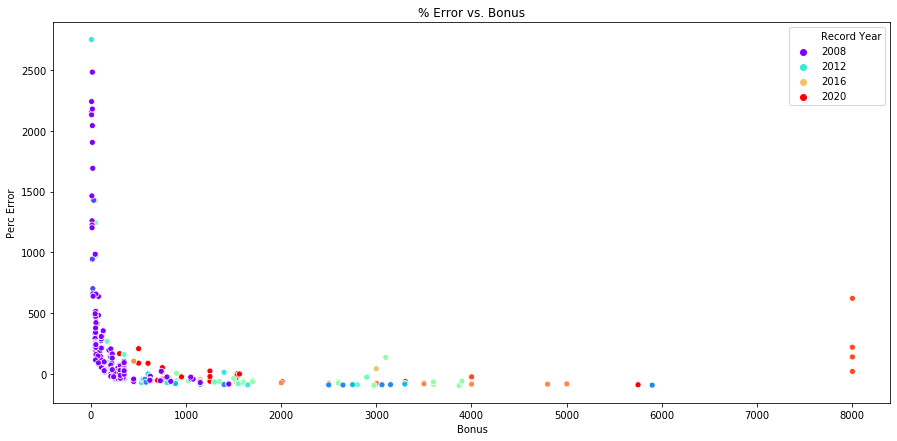

In [272]:
plt.figure(figsize=(15,7))
#bonus column is duplicated - thus - using .iloc[:,2]
sns.scatterplot(resultsConcat.iloc[:,2], resultsConcat["Perc Error"], hue = resultsConcat["Record Year"], palette = "rainbow")
plt.title("% Error vs. Bonus")

* Large errors occur at bonuses less than $500
* Need to determine how characteristics of learning features appear to look like at small bonus prices
* Also, bonuses of leases in 2008 appear to be causing the most errors - maybe we can remove 2008 lease prices for training the model

In [273]:
resultsConcat['Perc Error'].quantile(.90)
resultsConcat["Bonus"].quantile(.01)

341.0

Bonus    10.1
Bonus    10.1
Name: 0.01, dtype: float64

Text(0.5, 1.0, 'Zooming on Lease Bonus with Error \n% Error vs. Bonus\n Predicted (black) vs. Actual (rainbow)')

(0, 500)

(0, 4000)

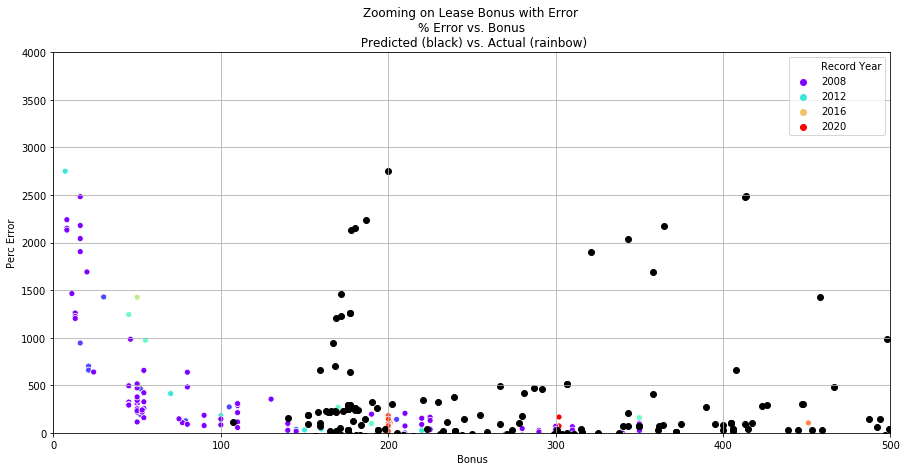

In [274]:
#Zooming in on smaller bonuses where large errors occured
fig, ax = plt.subplots(1,1, figsize=(15,7))
#bonus column is duplicated - thus - using .iloc[:,2]
sns.scatterplot(resultsConcat.iloc[:,2], resultsConcat["Perc Error"], hue = resultsConcat["Record Year"], palette = "rainbow", ax = ax)
ax.set_title("Zooming on Lease Bonus with Error \n% Error vs. Bonus\n Predicted (black) vs. Actual (rainbow)")
ax.set_xlim([0,500])
ax.set_ylim([0,4000])

ax.scatter(resultsConcat["Predicted"], resultsConcat["Perc Error"], c = "k")
plt.grid(True)

* Large errors occur under $50/acre  - multiple linear regression over entire data range may not work - may have to split up data or perform isotonic regression

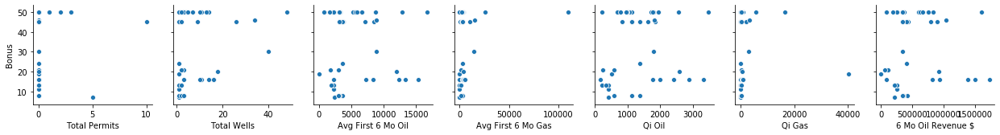

In [275]:

a = sns.pairplot(cleanedLeases[cleanedLeases["Bonus"]<51], y_vars="Bonus", x_vars = learningCols[0:7])


* we see that there is a lot high variance on bonus price when there is 0 to minimal magnitude on the learning features

* we may need to do isotonic regressions at different intervals of each learning feature to better fit low bonus priced tracts

In [276]:
cleanedLeases[cleanedLeases["Bonus"]<51][MLPredandResponseCols].describe().T

NameError: name 'MLPredandResponseCols' is not defined

## Decision Tree Model

In [277]:
#importing libraries for creating decision tree model
import math                                               # basic calculations like square root
from sklearn import tree                                  # tree program from scikit learn (package for machine learning)
from sklearn.tree import _tree                            # for accessing tree information
from sklearn import metrics                               # measures to check our models
from sklearn.model_selection import cross_val_score       # cross validation methods
from sklearn.tree import export_graphviz  

### Sample Decision Tree - No Scaled or Transformed Data
* Helps to interpret decision tree flow chart

In [278]:
#establishing initial simple model
treeModel = tree.DecisionTreeRegressor(criterion='mae', min_samples_leaf=4, max_depth = 4)
treeModel = treeModel.fit(scaler.inverse_transform(x_train), np.exp(y_train))

### Visualizing Decision Tree with Packages

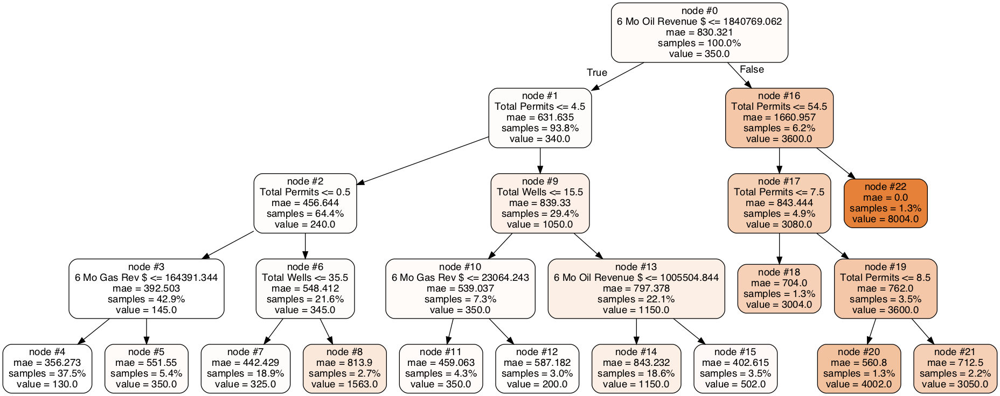

In [279]:
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(treeModel, out_file=dot_data, feature_names=inputs.columns,  
                filled=True, rounded=True,leaves_parallel = False, impurity = True,
                special_characters=False, node_ids = True, proportion = True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [280]:
sampletreePredictions = treeModel.predict(scaler.inverse_transform(x_train))

In [281]:
metrics.mean_absolute_error(np.exp(y_train), sampletreePredictions)

509.1832884097035

### Iterating Tree Model with Different Parameters - Data is Scaled and Transformed (Inputs are standardized, Response is log transformed)

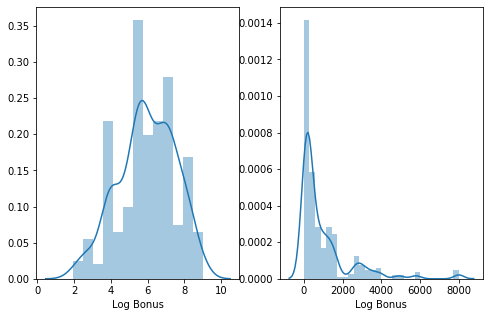

In [282]:
fig, ax = plt.subplots(1,2, figsize = (8,5))
sns.distplot(y_train, ax = ax[0])
sns.distplot(np.exp(y_train), ax = ax[1])

In [283]:
#creating empty arrays to store model data, error, information
error = []
varexp = []
treeModels = []
minSampleList = []
levels = []
minSamples = []

#looping through different sample minimums per leaf along with different levels
#running criterion on model as L1 loss function to reduce the sensitivity to outliars and large variance of response feature
for sample in range(2,16,2):
    for level in range(2,15):
        iterTreeMod = tree.DecisionTreeRegressor(criterion='mae', max_depth=level, min_samples_leaf=sample)
        iterTreeMod.fit(x_train, y_train)
        treeModels.append(iterTreeMod)
        minSamples.append(sample)
        levels.append(level)

for model in treeModels:
    error.append(metrics.mean_absolute_error(np.exp(y_train), np.exp(model.predict(x_train))))
    varexp.append(metrics.explained_variance_score(np.exp(y_train), np.exp(model.predict(x_train))))

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=2,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=3,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=4,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=5,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=6,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=7,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=8,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=9,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=10,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=11,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=12,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=13,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=14,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=2,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=3,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=4,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=5,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=6,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=7,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=8,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=9,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=10,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=11,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=12,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=13,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=14,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=4, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=2,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=3,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=4,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=5,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=6,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=7,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=8,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=9,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=10,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=11,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=12,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=13,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=14,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=6, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=2,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=3,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=4,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=5,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=6,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=7,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=8,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=9,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=10,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=11,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=12,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=13,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=14,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=8, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=2,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=3,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=4,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=5,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=6,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=7,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=8,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=9,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=10,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=11,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=12,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=13,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=14,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=10, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=2,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=3,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=4,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=5,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=6,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=7,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=8,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=9,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=10,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=11,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=12,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=13,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=14,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=12, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=2,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=3,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=4,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=5,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=6,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=7,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=8,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=9,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=10,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=11,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=12,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=13,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=14,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=14, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

<Figure size 864x504 with 0 Axes>

Text(0.5, 1.0, 'Absolute Mean Error vs Tree Branches - Colored by Min Sample Size in Each Leaf')

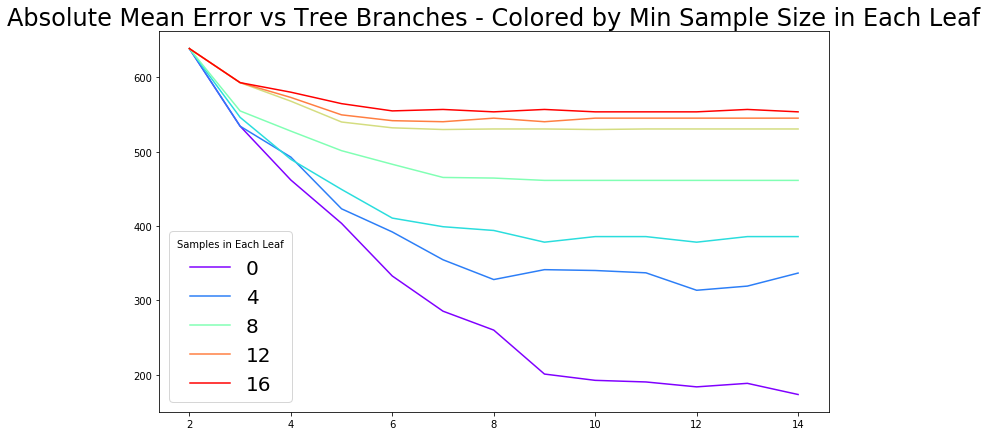

In [284]:
plt.figure(figsize=(12,7))
sns.lineplot(x=levels, y = error, hue = minSamples, palette="rainbow")
plt.title("Absolute Mean Error vs Tree Branches - Colored by Min Sample Size in Each Leaf", size = 24)
plt.legend(title = "Samples in Each Leaf", prop={'size': 20})

<Figure size 864x504 with 0 Axes>

Text(0.5, 1.0, 'Variance Explained vs Tree Branches - Colored by Min Sample Size in Each Leaf')

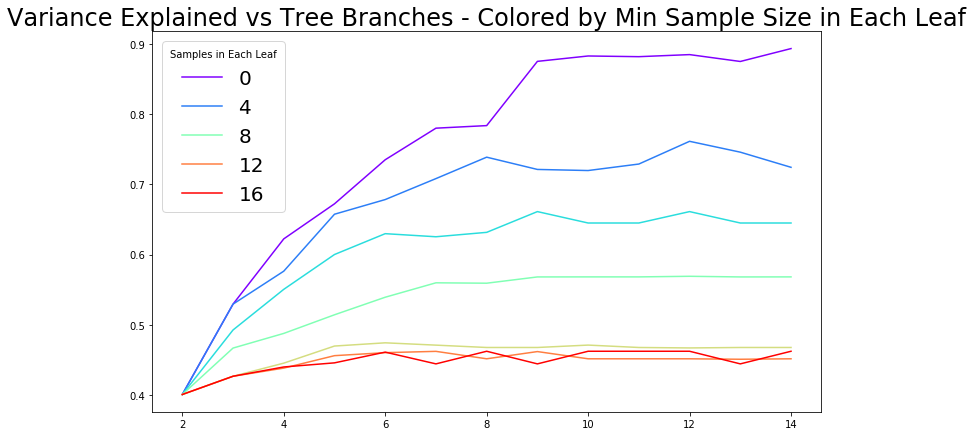

In [285]:
plt.figure(figsize=(12,7))
sns.lineplot(x=levels, y = varexp, hue = minSamples, palette="rainbow")
plt.title("Variance Explained vs Tree Branches - Colored by Min Sample Size in Each Leaf", size = 24)
plt.legend(title = "Samples in Each Leaf", prop={'size': 20})

* We see the most optimal model, one that does not overfit, while still producing an error under 400, appears to be model with 4 samples as minimum, and 6-8 levels

In [286]:
finalTreeModel = tree.DecisionTreeRegressor(criterion='mae', max_depth=8, min_samples_leaf=4)
finalTreeModel=finalTreeModel.fit(x_train,y_train)
treePredictions = np.exp(finalTreeModel.predict(x_train))


In [294]:
modelPerformance(np.exp(y_train), treePredictions)

Mean Absolute Error: 321.0700808625337 
Variance Explained: 0.7553532040928085 
R2 Score: 0.7485986246813092


In [288]:
treeResults = pd.DataFrame()
treeResults["Actual Bonus"] = np.exp(y_train)
treeResults["Tree Predicted Bonus"] = treePredictions
treeResults

,Actual Bonus,Tree Predicted Bonus
LeaseIndex,,
2505,55.0,350.000000
2502,2750.0,570.000000
2704,350.0,350.000000
3072,50.0,52.000000
2356,1500.0,2085.665361
2507,2800.0,989.949494
1858,451.0,1220.698161
3079,300.0,570.000000
3255,13.0,45.000000


In [289]:
resultsConcat = pd.concat([resultsConcat, treeResults["Tree Predicted Bonus"]], axis=1, join="inner")

In [290]:
resultsConcat["Diff Linear vs Tree"] = resultsConcat["Predicted"] - resultsConcat["Tree Predicted Bonus"]

In [291]:

resultsConcat.describe().T

,count,mean,std,min,25%,50%,75%,max
Bonus,371.0,990.654987,1417.418897,7.0,147.500000,350.0,1201.0,8004.0
Section,371.0,18.760108,10.633660,1.0,9.000000,19.0,28.0,36.0
Township,371.0,38.226415,1.071726,37.0,37.000000,38.0,39.0,40.0
Range,371.0,72.110512,1.008704,70.0,71.500000,72.0,73.0,74.0
Total Permits,371.0,6.150943,13.323780,0.0,0.000000,1.0,7.0,124.0
Total Wells,371.0,17.773585,15.641506,1.0,3.000000,13.0,29.0,55.0
Avg First 6 Mo Oil,371.0,10011.646900,11160.853019,0.0,3090.000000,7282.0,12277.0,82446.0
Avg First 6 Mo Gas,371.0,15269.902965,25446.200952,0.0,1754.000000,3628.0,20281.0,197850.0
Qi Oil,371.0,2619.509434,3084.854426,0.0,795.000000,1790.0,3104.0,26010.0
Qi Gas,371.0,4281.234501,7689.151727,0.0,314.000000,816.0,4620.0,40644.0


## Testing Tree and Linear Model on Y Test

In [296]:
linearTest = np.exp(reg.predict(x_test))
print("Linear Model")
modelPerformance(np.exp(y_test), linearTest)


treeTest = np.exp(finalTreeModel.predict(x_test))
print("\nDecision Tree")
modelPerformance(np.exp(y_test), treeTest)

Linear Model
Mean Absolute Error: 880.9124659663399 
Variance Explained: -1.9842780934169775 
R2 Score: -2.00268352390639

Decision Tree
Mean Absolute Error: 544.5556065524945 
Variance Explained: 0.6373253172788558 
R2 Score: 0.6325811068154032



## Applying Model to Sales Tracts

### Data Preparation

In [868]:
#adding record date to tractshp in order for it to work with getTrainingMeasures functions
tractshp["Record Date"] = saleDate

#filtering leaes within AOI where model data was built on
leasesInAOI = tractshp.loc[tractshp["geometry"].within(AOI["geometry"].iloc[0])]

NameError: name 'tractshp' is not defined

### Looping through all tracts within selected AOI to gather permit and production data

In [ ]:
for i in leasesInAOI.index:
    getTrainingMeasures(leasesInAOI, i, prodshp, permitshp)

In [ ]:
#detecting null columns that may have occured when getting training measures that did not have wells to generate revenue, Qi oil, etc
nullCols = leasesInAOI.columns[leasesInAOI.isnull().any()]

In [ ]:
#filling null values with a loop, as df.fillna does not work on a geo dataframe - therefore have to iterate through columns
nullCols
for col in nullCols:
    leasesInAOI[col].fillna(0,inplace=True)

In [ ]:
#exporting training measures on sale tracts to file
leasesInAOI.to_excel("Output Data/Sale Tracts Learning Measures.xlsx")

### Read In Prepared Data
### Preparing model by gathering inputs, scaling, and predicting based on training model

In [297]:
#reading in leasesinAOI from file for model
leasesInAOI = pd.read_excel("Output Data/Sale Tracts Learning Measures.xlsx", index_col = 0)
leasesInAOI.head()

,SaleParcel,lot_no,tract_id,short_code,label,geometry,centroids,Acres,buffers,Permit Summary,...,Total Permits,Total Wells,Avg First 6 Mo Oil,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price
16,WY-201Q-014,64921,40,BLMWY-2020-Q1-3,WY-2020-03-6317,"POLYGON ((470775.3766748243 4783849.638091538,...",POINT (469958.273277905 4783844.910772996),325,"POLYGON ((474786.293277905 4783844.910772996, ...",In a 3 mile radius there are 12 active permits...,...,12,6,107657.200000,85665.000000,26755.000000,20090.000000,2.691430e+06,153340.350000,25,1.79
17,WY-201Q-100,65007,41,BLMWY-2020-Q1-3,WY-2020-03-6318,"POLYGON ((470776.0512321209 4785061.1477955, 4...",POINT (469953.1518195324 4784853.058404164),166,"POLYGON ((474781.1718195324 4784853.058404164,...",In a 3 mile radius there are 10 active permits...,...,10,5,107657.200000,85665.000000,27732.000000,18996.000000,2.691430e+06,153340.350000,25,1.79
18,WY-201Q-101,65008,42,BLMWY-2020-Q1-3,WY-2020-03-6319,MULTIPOLYGON (((467495.5528191004 4784235.8869...,POINT (467757.130082407 4784036.616042774),494,"POLYGON ((472585.150082407 4784036.616042774, ...",In a 3 mile radius there are 13 active permits...,...,13,10,122775.000000,85716.833333,27903.000000,18525.000000,3.069375e+06,153433.131667,25,1.79
19,WY-201Q-015,64922,45,BLMWY-2020-Q1-3,WY-2020-03-6324,MULTIPOLYGON (((466663.7560363491 4802008.3005...,POINT (468832.8359083962 4802293.450434712),1539,"POLYGON ((473660.8559083962 4802293.450434712,...",In a 3 mile radius there are 11 active permits...,...,11,15,84078.600000,136917.200000,19838.000000,32556.000000,2.101965e+06,245081.788000,25,1.79
20,WY-201Q-102,65009,44,BLMWY-2020-Q1-3,WY-2020-03-6322,"POLYGON ((467881.7929990217 4802005.905810955,...",POINT (467608.471182364 4801534.516088142),243,"POLYGON ((472436.491182364 4801534.516088142, ...",In a 3 mile radius there are 20 active permits...,...,20,22,103078.416667,211061.500000,23465.454545,38686.363636,2.576960e+06,377800.085000,25,1.79


### Scaling Inputs and Predicting Bonuses Based on Models

In [298]:
#getting inputs based on the model defined before
inputsTractProjection = leasesInAOI[inputs.columns]

#scaling independent variables and tranforming
scaler.fit(inputsTractProjection)
inputsTractProjection = scaler.transform(inputsTractProjection)

#predicting bonuses
projBonus = reg.predict(inputsTractProjection)

#creating column for projected Bonuses
leasesInAOI["Projected Bonus"] = np.exp(projBonus)

StandardScaler(copy=True, with_mean=True, with_std=True)

In [304]:
leasesInAOI["Tree Predicted Bonus"] = np.exp(finalTreeModel.predict(inputsTractProjection))

In [305]:
#rounding numeric values for cleaner presentation
leasesInAOI = leasesInAOI.round()

In [306]:
#Since we had model error - we will use it to get an estimated range  - since this model tended to underestimate - we will use the projected value x only 75% to get low end and 200% to get highend

In [307]:
def getBidIntervals(lowEndRate, highEndRate, BaseBonus):
    
    '''
    This function will create an interval based on adjustments to the projected BaseBonus prices
    BaseBonus price will be a pandas series
    lowEndRate and highEndRate will be user defined based on the error of the model
    Basebonus will be a pandas series and the function should be called on the dataframe apply method
    '''
    
    lowProjection = BaseBonus * lowEndRate
    highProjection = BaseBonus * highEndRate
    average = (lowProjection + highProjection) /2
    
    return [lowProjection, highProjection]
    

In [308]:
leasesInAOI["Expected Bonus Range"] = leasesInAOI["Projected Bonus"].apply(lambda x: getBidIntervals(.75, 2, x))

In [309]:
leasesInAOI

,SaleParcel,lot_no,tract_id,short_code,label,geometry,centroids,Acres,buffers,Permit Summary,...,Avg First 6 Mo Gas,Qi Oil,Qi Gas,6 Mo Oil Revenue $,6 Mo Gas Rev $,Oil Price,Gas Price,Projected Bonus,Expected Bonus Range,Tree Predicted Bonus
16,WY-201Q-014,64921,40,BLMWY-2020-Q1-3,WY-2020-03-6317,"POLYGON ((470775.3766748243 4783849.638091538,...",POINT (469958.273277905 4783844.910772996),325,"POLYGON ((474786.293277905 4783844.910772996, ...",In a 3 mile radius there are 12 active permits...,...,85665.0,26755.0,20090.0,2691430.0,153340.0,25,2.0,347.0,"[260.25, 694.0]",250.0
17,WY-201Q-100,65007,41,BLMWY-2020-Q1-3,WY-2020-03-6318,"POLYGON ((470776.0512321209 4785061.1477955, 4...",POINT (469953.1518195324 4784853.058404164),166,"POLYGON ((474781.1718195324 4784853.058404164,...",In a 3 mile radius there are 10 active permits...,...,85665.0,27732.0,18996.0,2691430.0,153340.0,25,2.0,287.0,"[215.25, 574.0]",250.0
18,WY-201Q-101,65008,42,BLMWY-2020-Q1-3,WY-2020-03-6319,MULTIPOLYGON (((467495.5528191004 4784235.8869...,POINT (467757.130082407 4784036.616042774),494,"POLYGON ((472585.150082407 4784036.616042774, ...",In a 3 mile radius there are 13 active permits...,...,85717.0,27903.0,18525.0,3069375.0,153433.0,25,2.0,532.0,"[399.0, 1064.0]",620.0
19,WY-201Q-015,64922,45,BLMWY-2020-Q1-3,WY-2020-03-6324,MULTIPOLYGON (((466663.7560363491 4802008.3005...,POINT (468832.8359083962 4802293.450434712),1539,"POLYGON ((473660.8559083962 4802293.450434712,...",In a 3 mile radius there are 11 active permits...,...,136917.0,19838.0,32556.0,2101965.0,245082.0,25,2.0,427.0,"[320.25, 854.0]",110.0
20,WY-201Q-102,65009,44,BLMWY-2020-Q1-3,WY-2020-03-6322,"POLYGON ((467881.7929990217 4802005.905810955,...",POINT (467608.471182364 4801534.516088142),243,"POLYGON ((472436.491182364 4801534.516088142, ...",In a 3 mile radius there are 20 active permits...,...,211062.0,23465.0,38686.0,2576960.0,377800.0,25,2.0,1222.0,"[916.5, 2444.0]",1535.0
21,WY-201Q-016,64923,49,BLMWY-2020-Q1-3,WY-2020-03-6340,"POLYGON ((468685.6574361854 4801198.093584971,...",POINT (468890.6774940442 4801400.067115995),40,"POLYGON ((473718.6974940442 4801400.067115995,...",In a 3 mile radius there are 11 active permits...,...,117010.0,17924.0,28632.0,1859872.0,209447.0,25,2.0,360.0,"[270.0, 720.0]",110.0
22,WY-201Q-017,64924,46,BLMWY-2020-Q1-3,WY-2020-03-6331,"POLYGON ((472330.6638150535 4800025.069974388,...",POINT (471858.2048892394 4800294.277369834),243,"POLYGON ((476686.2248892394 4800294.277369834,...",In a 3 mile radius there are 22 active permits...,...,190096.0,22800.0,45960.0,2316950.0,340272.0,25,2.0,396.0,"[297.0, 792.0]",1221.0
23,WY-201Q-103,65010,60,BLMWY-2020-Q1-3,WY-2020-03-6401,"POLYGON ((471122.0037354486 4801241.216803673,...",POINT (471114.8075752032 4800429.924610612),325,"POLYGON ((475942.8275752033 4800429.924610612,...",In a 3 mile radius there are 13 active permits...,...,190096.0,22800.0,45960.0,2316950.0,340272.0,25,2.0,221.0,"[165.75, 442.0]",450.0
24,WY-201Q-018,64925,47,BLMWY-2020-Q1-3,WY-2020-03-6333,MULTIPOLYGON (((467066.8207937301 4801197.1337...,POINT (467602.4846453754 4799779.674300328),243,"POLYGON ((472430.5046453754 4799779.674300328,...",In a 3 mile radius there are 21 active permits...,...,155514.0,23270.0,28696.0,2668385.0,278371.0,25,2.0,958.0,"[718.5, 1916.0]",1535.0
25,WY-201Q-019,64926,51,BLMWY-2020-Q1-3,WY-2020-03-6345,"POLYGON ((465830.3683772773 4798767.101425705,...",POINT (465426.4270627511 4798968.314839863),243,"POLYGON ((470254.4470627511 4798968.314839863,...",In a 3 mile radius there are 25 active permits...,...,147115.0,25604.0,30786.0,2790265.0,263336.0,25,2.0,1768.0,"[1326.0, 3536.0]",302.0


## Sales Results - Compare Projected Prices vs What was Sold

### Reading sales results excel file

In [310]:
salesResults = pd.read_excel('Data/Sales_Results.xlsx', header = 4)
#removing unamed null columns
salesResults = salesResults.drop(columns = salesResults.columns[[1,-1]])
#renaming column for merging
salesResults.rename(columns = {'PAR': 'Label Code'}, inplace = True)

In [311]:
#generating label code from sales results to make a primary key to join published sale results with presale codes
leasesInAOI["Label Code"] = leasesInAOI["label"].apply(lambda x: int(x.split('-')[3]))

In [312]:
#checking datatypes to ensure matching column for joining contain same datatype
salesResults.dtypes
leasesInAOI.dtypes

SERIAL         object
Label Code     object
NAME           object
ADDRESS        object
CITY           object
ST             object
ZIP            object
Bid/Acre       object
ACRES          object
Total Bonus    object
dtype: object

SaleParcel                        object
lot_no                             int64
tract_id                           int64
short_code                        object
label                             object
geometry                          object
centroids                         object
Acres                              int64
buffers                           object
Permit Summary                    object
Recent Prod Summary               object
Leases Summary                    object
Old Production Summary            object
Record Date               datetime64[ns]
Total Permits                      int64
Total Wells                        int64
Avg First 6 Mo Oil               float64
Avg First 6 Mo Gas               float64
Qi Oil                           float64
Qi Gas                           float64
6 Mo Oil Revenue $               float64
6 Mo Gas Rev $                   float64
Oil Price                          int64
Gas Price                        float64
Projected Bonus 

In [313]:
#converting to string in order for joining to work when inner joining the sales results
leasesInAOI["Label Code"] = leasesInAOI["Label Code"].apply(lambda x: str(x))
salesResults["Label Code"] = salesResults["Label Code"].astype(str)

In [314]:
#checking datatypes to ensure matching column for joining contain same datatype
salesResults.dtypes
leasesInAOI.dtypes

SERIAL         object
Label Code     object
NAME           object
ADDRESS        object
CITY           object
ST             object
ZIP            object
Bid/Acre       object
ACRES          object
Total Bonus    object
dtype: object

SaleParcel                        object
lot_no                             int64
tract_id                           int64
short_code                        object
label                             object
geometry                          object
centroids                         object
Acres                              int64
buffers                           object
Permit Summary                    object
Recent Prod Summary               object
Leases Summary                    object
Old Production Summary            object
Record Date               datetime64[ns]
Total Permits                      int64
Total Wells                        int64
Avg First 6 Mo Oil               float64
Avg First 6 Mo Gas               float64
Qi Oil                           float64
Qi Gas                           float64
6 Mo Oil Revenue $               float64
6 Mo Gas Rev $                   float64
Oil Price                          int64
Gas Price                        float64
Projected Bonus 

In [315]:
FullResultsandTracts = pd.merge(leasesInAOI, salesResults)

In [316]:
FullResultsandTracts.head()

,SaleParcel,lot_no,tract_id,short_code,label,geometry,centroids,Acres,buffers,Permit Summary,...,Label Code,SERIAL,NAME,ADDRESS,CITY,ST,ZIP,Bid/Acre,ACRES,Total Bonus
0,WY-201Q-014,64921,40,BLMWY-2020-Q1-3,WY-2020-03-6317,"POLYGON ((470775.3766748243 4783849.638091538,...",POINT (469958.273277905 4783844.910772996),325,"POLYGON ((474786.293277905 4783844.910772996, ...",In a 3 mile radius there are 12 active permits...,...,6317,WYW189804,R&R ROYALTY LTD,500 N SHORELINE BLVD STE 322,CORPUS CHRISTI,TX,784010313,516,320,165120
1,WY-201Q-100,65007,41,BLMWY-2020-Q1-3,WY-2020-03-6318,"POLYGON ((470776.0512321209 4785061.1477955, 4...",POINT (469953.1518195324 4784853.058404164),166,"POLYGON ((474781.1718195324 4784853.058404164,...",In a 3 mile radius there are 10 active permits...,...,6318,WYW189805,K2T2 RESOURCES LLC,2993 S MILWAUKEE CIR,DENVER,CO,802106755,634,162.94,103342
2,WY-201Q-101,65008,42,BLMWY-2020-Q1-3,WY-2020-03-6319,MULTIPOLYGON (((467495.5528191004 4784235.8869...,POINT (467757.130082407 4784036.616042774),494,"POLYGON ((472585.150082407 4784036.616042774, ...",In a 3 mile radius there are 13 active permits...,...,6319,WYW189806,TEXAS INDEPENDENT EXPLORATION,6760 PORTWEST DRIVE,HOUSTON,TX,77024,346,480,166080
3,WY-201Q-015,64922,45,BLMWY-2020-Q1-3,WY-2020-03-6324,MULTIPOLYGON (((466663.7560363491 4802008.3005...,POINT (468832.8359083962 4802293.450434712),1539,"POLYGON ((473660.8559083962 4802293.450434712,...",In a 3 mile radius there are 11 active permits...,...,6324,WYW189807,R&R ROYALTY LTD,500 N SHORELINE BLVD STE 322,CORPUS CHRISTI,TX,784010313,389,1519.54,591280
4,WY-201Q-102,65009,44,BLMWY-2020-Q1-3,WY-2020-03-6322,"POLYGON ((467881.7929990217 4802005.905810955,...",POINT (467608.471182364 4801534.516088142),243,"POLYGON ((472436.491182364 4801534.516088142, ...",In a 3 mile radius there are 20 active permits...,...,6322,WYW189808,MONCRIEF OIL & GAS MASTER LLC,950 COMMERCE ST MONCR,FORT WORTH,TX,761025418,526,240,126240


In [318]:
ProjectedvsActual = FullResultsandTracts.loc[FullResultsandTracts["NAME"] == "R&R ROYALTY LTD"][["Projected Bonus", "Bid/Acre", "Expected Bonus Range", "Tree Predicted Bonus"]]

### Results - Projected Bonus vs Actual Bonus (Bid/Acre)

In [319]:
ProjectedvsActual

,Projected Bonus,Bid/Acre,Expected Bonus Range,Tree Predicted Bonus
0,347.0,516,"[260.25, 694.0]",250.0
3,427.0,389,"[320.25, 854.0]",110.0
6,396.0,203,"[297.0, 792.0]",1221.0
7,221.0,526,"[165.75, 442.0]",450.0
8,958.0,525,"[718.5, 1916.0]",1535.0
10,428.0,525,"[321.0, 856.0]",350.0
11,205.0,357,"[153.75, 410.0]",1300.0
12,654.0,681,"[490.5, 1308.0]",1221.0
13,246.0,554,"[184.5, 492.0]",1221.0
14,168.0,511,"[126.0, 336.0]",600.0
